## Load data

In [2]:
from scripts.halo_analysis_scripts import *
from scripts.analytic_modeling import Simulation, Potential_FIRE
from astropy import units as un, constants as cons
from joblib import Parallel, delayed
import matplotlib.colors as colors
from pprint import pprint
%matplotlib inline
plt.style.reload_library()
# plt.style.use(['science', 'high-vis'])
import smplotlib
from scipy.interpolate import interp1d

import WiersmaCooling as Cool
import cooling_flow as CF

In [2]:
m12f = Simulation(simdir='/scratch1/08044/tg873432/fire2_core_no_md/m12f_r57000', snapnum=600, cachesim=True)

In [3]:
m12q = Simulation(simdir='/scratch1/08044/tg873432/fire2_core_no_md/m12q_r57000', snapnum=600, cachesim=True)

In [2]:
m12f_fire2 = Simulation(simdir='/scratch1/08044/tg873432/fire2_core_no_md/m12f_r57000', snapnum=600)
m12q_fire2 = Simulation(simdir='/scratch1/08044/tg873432/fire2_core_no_md/m12q_r57000', snapnum=600)

m12f_fire3 = Simulation(simdir=PaperSimNames['m12f_NoBH'], snapnum=500)
m12q_fire3 = Simulation(simdir=PaperSimNames['m12q_NoBH'], snapnum=500)

In [3]:
d = '../data/simcachev2_Khist_outflow/'
sims = np.unique(['_'.join(f.split('_')[1:-1]) for f in os.listdir(d)])
PaperSimNames = {k:v for k,v in PaperSimNames.items() if v in sims and 'NoBH' in k}

In [4]:
PaperSimNames

{'m13h002_NoBH': 'm13h002_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h007_NoBH': 'm13h007_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h029_NoBH': 'm13h029_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h113_NoBH': 'm13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h206_NoBH': 'm13h206_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h223_NoBH': 'm13h223_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h236_NoBH': 'm13h236_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm12a_NoBH': 'm12a_r57000',
 'm12d_NoBH': 'm12d_r57000',
 'm12e_NoBH': 'm12e_r57000',
 'm12g_NoBH': 'm12g_r7100',
 'm12j_NoBH': 'm12j_r7100',
 'm12k_NoBH': 'm12k_r57000',
 'm12n_NoBH': 'm12n_r7100',
 'm12u_NoBH': 'm12u_r28000',
 'm12x_NoBH': 'm12x_r3500',
 'm12b_NoBH': 'm12b_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm12c_NoB

In [125]:
PaperSimNames = {
    **PaperSimNames,
    'm12f_NoBH_fire3': 'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5',
    'm12q_NoBH_fire3': 'm12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5',
    'm12f_NoBH_fire2': 'm12f_r57000',
    'm12q_NoBH_fire2': 'm12q_r57000',
    'm12i_NoBH_fire2': 'm12i_r57000',
    'm12b_NoBH_fire2': 'm12b_r57000',
    'm13h113_NoBH_fire3': 'm13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
    'm13h206_NoBH_fire3': 'm13h206_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5'
}

In [9]:
sorted('fqrwzadkgjnx')

['a', 'd', 'f', 'g', 'j', 'k', 'n', 'q', 'r', 'w', 'x', 'z']

In [5]:
# Load snapshots from z=0.5 to 0
res = {}
for k,v in sorted(PaperSimNames.items()):
    snaps = sorted([int(f.split('_')[-1].split('.')[0]) for f in os.listdir(d) if v in f])
    print(k, v)
    print(snaps)
    print()
#     Sim = Simulation(v, snaps[-1])
#     print(k, Sim.Redshift)
#     print(f"{Sim.pro['Mvir']/1e12:.2f} {Sim.pro['Rvir']:.0f}\n")
    res[k] = Parallel(n_jobs=-1, verbose=0)(delayed(Simulation)(v, s) for s in snaps)

m12a_NoBH m12a_r57000
[500]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:139: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))


m12b_NoBH m12b_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[259, 279, 303, 330, 364, 382, 386, 391, 395, 399, 500]

m12c_NoBH m12c_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[500]

m12d_NoBH m12d_r57000
[500]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:139: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))


m12e_NoBH m12e_r57000
[500]

m12f_NoBH m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[259, 279, 303, 330, 364, 382, 386, 391, 395, 399, 500]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:413: RuntimeWarning: invalid value encountered in float_scalars
  self.Z2Zsun = np.sum(10**self.pro['Z_Mweighted'][idxZavg] * self.pro['TotalMass:PartType0'][idxZavg]) / np.sum(self.pro['TotalMass:PartType0'][idxZavg])
/home/ias627/miniconda3/envs/py39/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ias627/miniconda3/envs/py39/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


m12g_NoBH m12g_r7100
[500]

m12i_NoBH m12i_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[259, 279, 303, 330, 364, 382, 386, 391, 395, 399, 500]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:139: RuntimeWarning: divide by zero encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))
/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:139: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))
/home/ias627/miniconda3/envs/py39/lib/python3.9/site-packages/numpy/lib/function_base.py:1247: RuntimeWarning: invalid value encountered in multiply
  out[tuple(slice1)] = a * f[tuple(slice2)] + b * f[tuple(slice3)] + c * f[tuple(slice4)]
/home/ias627/miniconda3/envs/py39/lib/python3.9/site-packages/numpy/lib/function_base.py:1247: RuntimeWarning: invalid value encountered in add
  out[tuple(slice1)] = a * f[tuple(slice2)] + b * f[tuple(slice3)] + c * f[tuple(slice4)]
/home/ias627/miniconda3/envs/py39/lib/python3.9/site-packages/numpy/lib/function_base.py:1256: RuntimeWarning: invalid value encountered in double_scalars
  out[tuple(slice1)] = (f[tup

m12j_NoBH m12j_r7100
[500]

m12k_NoBH m12k_r57000
[500]

m12m_NoBH m12m_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[500]

m12n_NoBH m12n_r7100
[500]

m12q_NoBH m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[259, 279, 303, 330, 364, 382, 386, 391, 395, 399, 500]

m12r_NoBH m12r_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[500]

m12u_NoBH m12u_r28000
[500]

m12w_NoBH m12w_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[500]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:139: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))


m12x_NoBH m12x_r3500
[500]

m12z_NoBH m12z_m4e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
[500]

m13h002_NoBH m13h002_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
[51]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:139: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))


m13h007_NoBH m13h007_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
[60]

m13h029_NoBH m13h029_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
[56, 57]

m13h113_NoBH m13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
[50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]

m13h206_NoBH m13h206_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
[50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60]

m13h223_NoBH m13h223_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
[55]

m13h236_NoBH m13h236_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
[53]



/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:139: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))
/home/ias627/projects/massive_halos/scripts/analytic_modeling.py:139: RuntimeWarning: invalid value encountered in log
  lnvcr = np.gradient(np.log(vcr), np.log(Mr['r']))


Rcool not defined, set to 0.5*Rvir m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
Rcool not defined, set to 0.5*Rvir m12u_r28000
Rcool not defined, set to 0.5*Rvir m12e_r57000
Rcool not defined, set to 0.5*Rvir m12b_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
Rcool not defined, set to 0.5*Rvir m12i_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5


m12f_r57000
-0.6116360605536503 11.082297264927101
m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
-0.6180671806464252 5.086330565660414
m12q_r57000
-0.6105832382942985 2.9582928232214143
m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
-0.595630123431046 6.076584562911069


(-1.3010299956639813, 0.8557667517692242)

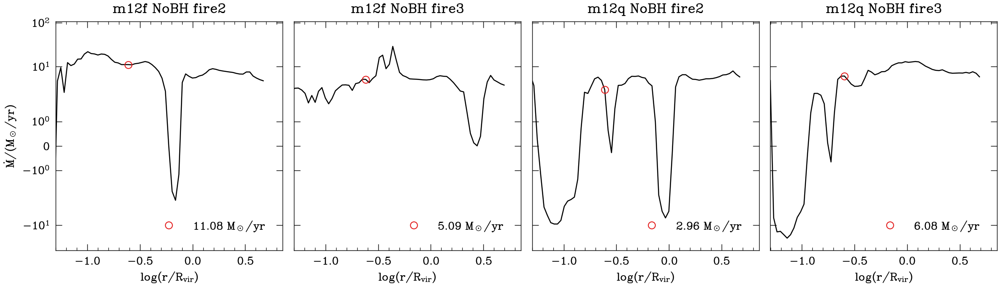

In [39]:
sims = [m12f_fire2, m12f_fire3, m12q_fire2, m12q_fire3]
labels = ['m12f NoBH fire2', 'm12f NoBH fire3', 'm12q NoBH fire2', 'm12q NoBH fire3']

fig, axes = plt.subplots(1, len(sims), sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*len(sims),4.8*1], dpi=150)
for i,Sim in enumerate(sims):
    print(Sim.simname)
    axes[i].set_title(labels[i])
    axes[i].plot(np.log10(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir']), Sim.Mdot_profile['Mdot'])
    axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
    
    idx25 = np.argmin(np.abs(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir'] - 0.25))
    print(np.log10(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir'])[idx25], Sim.Mdot_profile['Mdot'][idx25])
    axes[i].plot(np.log10(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir'])[idx25], Sim.Mdot_profile['Mdot'][idx25], 'o', label=f"{Sim.Mdot_profile['Mdot'][idx25]:.2f}" + r' $M_\odot/\mathrm{{yr}}$')
    axes[i].legend(loc=4)
for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')
axes[0].set_yscale('symlog')
axes[0].set_xlim(np.log10(0.05))

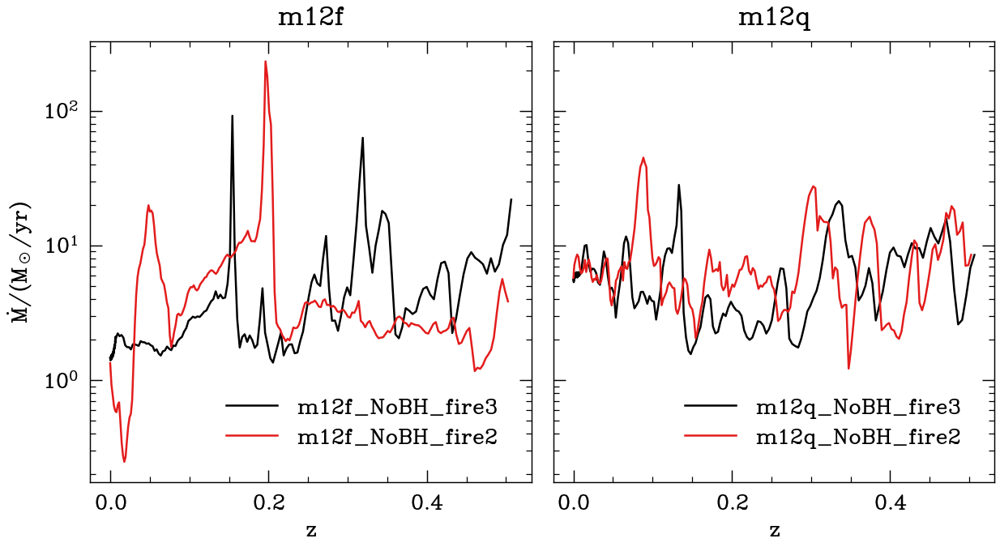

In [39]:
fig, axes = plt.subplots(1, 2, sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*2,4.8*1], dpi=150)
for i,(k,v) in enumerate(res.items()):
    i = 0 if 'm12f' in k else 1
    axes[i].set_title(k.split('_')[0])
    
    y = [-Sim.Mdot_profile['Mdot'][np.argmin(np.abs(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir'] - 0.25))] for Sim in v]
    x = [Sim.Redshift[()] for Sim in v]
    axes[i].plot(x,y, label=k)
    axes[i].legend(loc=4)
    
    axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
for ax in axes: ax.set_xlabel(r'$z$')
axes[0].set_yscale('log')

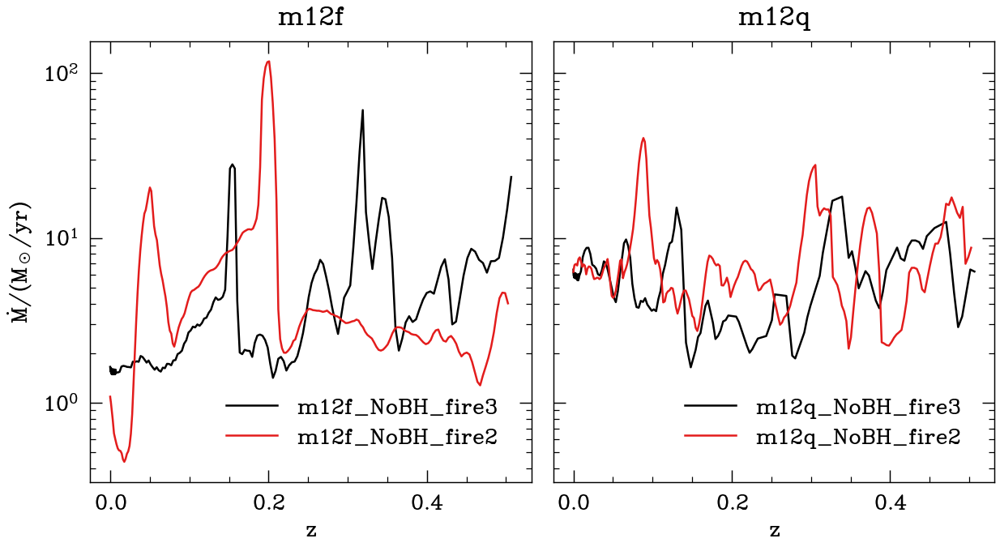

In [4]:
fig, axes = plt.subplots(1, 2, sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*2,4.8*1], dpi=150)
for i,(k,v) in enumerate(res.items()):
    i = 0 if 'm12f' in k else 1
    axes[i].set_title(k.split('_')[0])

    y = [Sim.Mdot_profile['Mdot_outflows'][1] for Sim in v]
    x = [Sim.Redshift[()] for Sim in v]
    axes[i].plot(x,y, label=k)
    axes[i].legend(loc=4)
    
    axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
for ax in axes: ax.set_xlabel(r'$z$')
axes[0].set_yscale('log')

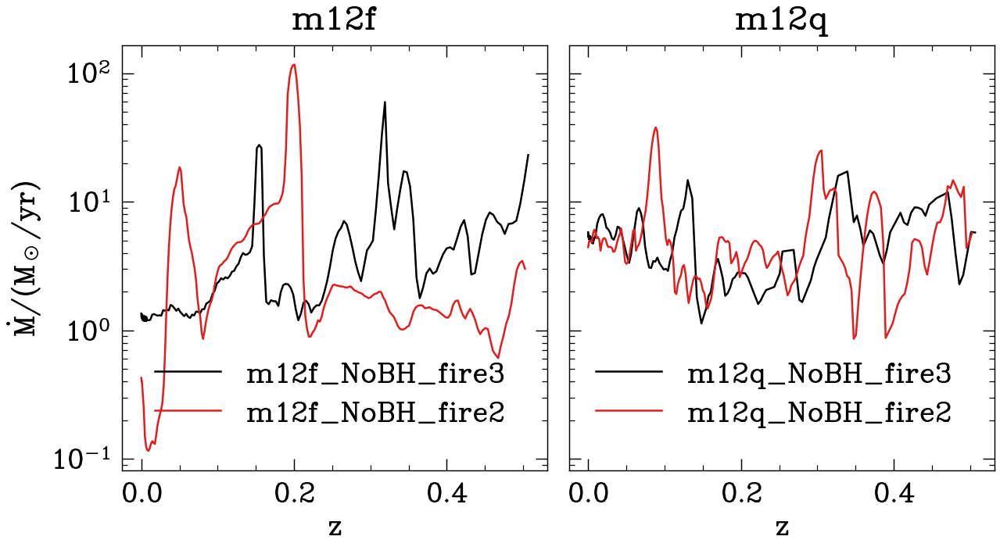

In [30]:
fig, axes = plt.subplots(1, 2, sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*2,4.8*1], dpi=150)
for i,(k,v) in enumerate(res.items()):
    i = 0 if 'm12f' in k else 1
    axes[i].set_title(k.split('_')[0])

    y = [Sim.Mdot_profile['Mdot_outflows'][2] for Sim in v]
    x = [Sim.Redshift[()] for Sim in v]
    axes[i].plot(x,y, label=k)
    axes[i].legend(loc=4)
    
    axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
for ax in axes: ax.set_xlabel(r'$z$')
axes[0].set_yscale('log')

In [5]:
plt.rcParams.update({'font.size': 20})

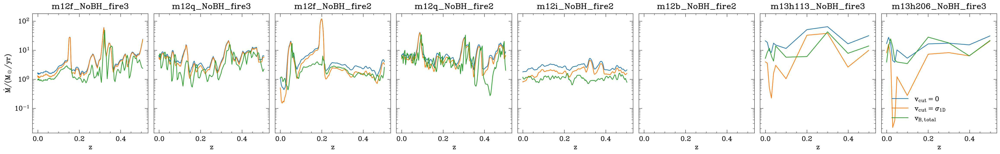

In [21]:
fig, axes = plt.subplots(1, 8, sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*8,4.8*1], dpi=150)
for i,(k,v) in enumerate(res.items()):
    axes[i].set_title(k)

    for j,l in zip(range(1,4),[r'$v_{\mathrm{cut}}=0$',r'$v_{\mathrm{cut}}=\sigma_{\mathrm{1D}}$','$v_{\mathrm{B,total}}$']):
        y = [Sim.Mdot_profile['Mdot_outflows'][j] for Sim in v]
        x = [Sim.Redshift[()] for Sim in v]
        axes[i].plot(x,y, label=l)
axes[-1].legend(loc=3)
axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
for ax in axes: ax.set_xlabel(r'$z$')
axes[0].set_yscale('log')

In [7]:
Sim = res['m12f_NoBH_fire3'][-1]
Rlow, Rhigh = 0.66875, 0.66875
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)

3.728708428482426 solMass / yr
0.66875 kpc
3.7225354149823184 solMass / yr


In [ ]:
Sim = res['m12q_NoBH_fire2'][-20]
Rlow, Rhigh = .1, .2
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)

In [8]:
Sim = res['m12i_NoBH_fire2'][-1]
Rlow, Rhigh = 0.0975, 0.0975 #0.125
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)

5.506562307015115 solMass / yr
0.0975 kpc
5.495294511821014 solMass / yr


In [12]:
Sim = res['m12b_NoBH_fire2'][-1]
Rlow, Rhigh = 0.14937499999999998, 0.14937499999999998
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)

7.2679637345602925 solMass / yr
0.145 kpc
6.682619645476832 solMass / yr
0.16249999999999998 kpc
9.558746563169025 solMass / yr
0.18 kpc
13.21510168413648 solMass / yr
0.15375 kpc 0.7595792428309549 8.027542977391247 solMass / yr
0.14937499999999998 kpc 0.06554845527880016 7.333512189839093 solMass / yr


## Define CF plotting code

In [7]:
plt.rcParams.update({'font.size': 18})
def colormap(k, ax, sim):
    d = getattr(sim, f'cmap_{k}')
    im = ax.pcolormesh(d['X'], d['Y'], d['H'], cmap='Reds', norm=colors.SymLogNorm(linthresh=0.03, vmin=0, vmax=1))
    return im
def makecoolingflow(Sims, fname=None):
    
    ylabels = [r'$\log \left< n_H / \mathrm{cm}^{-3} \right>$', 
            profilelabels['T lin'],
            r'$ < \mathcal{M} >$',
            r'$\log \left< t_{\mathrm{cool}} / \mathrm{Gyr} \right>$',
            r'$\log < K >$'
            ]

    prolabels = ['nH', 'T', 'MachNumber', 'tcool', 'K']#tcoolshell
#     prolabels = ['nH', 'T_Mweighted', 'MachNumber', 'tcool', 'K_Mweighted']
    
    fig, axes = plt.subplots(len(ylabels), len(Sims), sharex='col', sharey='row', gridspec_kw={'wspace': .05, 'hspace':.25}, figsize=[4.8*len(Sims),4.8*len(ylabels)], dpi=150, facecolor='w')
    
    for mi,Sim in enumerate(Sims):
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']

        axes[3,mi].axhline(np.log10(Sim.tHubble), label=r'$t_H$', c='k')
        #TODO axes[3,mi].axhline(np.log10(Sim.tHubble * (1+Sim.Redshift)**(-3/2)), c='r')
        axes[3,mi].axvline(np.log10(Sim.Rcool), label=r'$R_{\mathrm{cool}}$', c='k', ls='-.')
        if mi==2: axes[3,mi].legend()

        axes[-1,mi].set_xlabel('$\log (r/\mathrm{pkpc})$')

        # Add FIRE-3 curves
        for ax, ylabel, prolabel in zip(axes[:,mi], ylabels, prolabels):
            ax.set_xlim(.4,3); print(np.log10(1.2*pro['Rvir'])) #2.65
            # ax.axvline(np.log10(0.05*pro['Rvir']))
            ax.axvline(np.log10(Sim.Rcool), c='k', ls='-.')
            ax.set_xlim(np.log10(0.05*pro['Rvir']))
            ax.plot(np.log10(rmid), pro[prolabel], 'k--', label='FIRE')
            ax.xaxis.set_tick_params(labelbottom=True)
            ax.set_xlabel('$\log (r/\mathrm{pkpc})$')
            if mi==0: ax.set_ylabel(ylabel)
            if prolabel=='nH': ax.set_title(['_'.join(v.split('_')[:2]) for k,v in PaperSimNames.items() if v==Sim.simname][0] + f' z={np.abs(Sim.Redshift[()]):.2f}')#ax.set_title(Sim.simname.split('_')[0])
        for ax in axes[(0,2,3),0].flatten():
            ax.set_xlim(ax.get_xlim())
            ax.set_ylim(ax.get_ylim())
        axes[1,0].set_ylim(5,7.5)
        axes[2,mi].set_ylim(-1,1)
        axes[3,0].set_ylim(-1.25,3.25)
        axes[4,0].set_ylim(12,14.75)
        # Add FIRE-3 colormaps
        im = colormap('nH', axes[0,mi], Sim)
        colormap('T', axes[1,mi], Sim)
        colormap('MachNumber', axes[2,mi], Sim)
        colormap('tcool', axes[3,mi], Sim)
        # colormap('Z', axes[4,mi], Sim)
        colormap('K', axes[4,mi], Sim)

        # Add cooling flow Rcirc solution curves
        res = Sim.transonic_solution#stalled_solution#
        res_x = np.log10(res.Rs().to(un.kpc).value)

        axes[0,mi].plot(res_x, np.log10(res.nHs().to(un.cm**-3).value), label=f'$\dot{{M}}={res.Mdot.value:.2f}\ M_\odot/\mathrm{{yr}}$')
        axes[1,mi].plot(res_x, np.log10(res.Ts().to(un.K).value))
        axes[2,mi].plot(res_x, res.Ms())
        axes[3,mi].plot(res_x, np.log10(res.t_cools().to(un.Gyr).value))
        
        axes[4,mi].plot(res_x, np.log10((res.P2ks().to(un.K/un.cm**3) / (res.rhos().to(un.Msun/un.kpc**3)/1e10)**(5/3)).value))

        # axes[0,mi].set_xlim(0.4,3)
        axes[0,mi].legend(loc=3)

    # Add the colorbar to the figure
    cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.3]) # [left, bottom, width, height]
    cbar = fig.colorbar(im, cax=cbar_ax, orientation='vertical')
    cbar.set_label('radial bin fraction')
    fig.tight_layout()
    if fname: plt.savefig(fname, bbox_inches='tight')
    return fig, axes

In [12]:
def makecoolingflowratios(Sims, fname=None, labels=None, lss=None, cs=None):
    
    ylabels = [r'$\log \left< n_H / \mathrm{cm}^{-3} \right>$', 
            profilelabels['T lin'],
            r'$\log < K >$'
            ]

    prolabels = ['nH', 'T', 'K']
    
    fig, axes = plt.subplots(len(ylabels), 1, sharex='col', sharey='col', gridspec_kw={'wspace': .05, 'hspace':.1}, figsize=[4.8*1,4.8*len(ylabels)], dpi=150, facecolor='w')
    
    for mi,Sim in enumerate(Sims):
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']

        axes[-1].set_xlabel('$\log (r/\mathrm{pkpc})$')

        # Add FIRE-3 curves
        for ax, ylabel, prolabel in zip(axes, ylabels, prolabels):
            break
            if mi==0: ax.set_ylabel(ylabel)

        # Add cooling flow solution curves
        res = Sim.transonic_solution#stalled_solution#
        res_x = np.log10(res.Rs().to(un.kpc).value)

        CF_nH = res.nHs().to(un.cm**-3).value
        CF_T = res.Ts().to(un.K).value
        CF_K = (res.P2ks().to(un.K/un.cm**3) / (res.rhos().to(un.Msun/un.kpc**3)/1e10)**(5/3)).value
        
        rmid2 = rmid[rmid<10**res_x.max()]
        axes[0].plot(np.log10(rmid2), 10**pro['nH'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_nH)(rmid2), c=cs[mi] if cs is not None else None, ls=lss[mi] if lss is not None else '-', label=labels[mi] if labels is not None else Sim.simname.split('_')[0])
        axes[1].plot(np.log10(rmid2), 10**pro['T'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_T)(rmid2), c=cs[mi] if cs is not None else None, ls=lss[mi] if lss is not None else '-')
        axes[2].plot(np.log10(rmid2), 10**pro['K'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_K)(rmid2), c=cs[mi] if cs is not None else None, ls=lss[mi] if lss is not None else '-')

        # axes[0,mi].set_xlim(0.4,3)
        axes[0].legend(bbox_to_anchor=(1.15, 1))
        axes[0].set_xlim(1.5,3)
    axes[0].set_ylabel('$n_{H, sim} / n_{H, CF}$')
    axes[1].set_ylabel('$T_{sim} / T_{CF}$')
    axes[2].set_ylabel('$K_{sim} / K_{CF}$')
    for ax in axes: ax.axhline(1)
    axes[0].set_yscale('log')
    axes[0].set_ylim(.1,10)
#     axes[0].set_ylim(0,2.5)
    # # Add the colorbar to the figure
    # cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.3]) # [left, bottom, width, height]
    # cbar = fig.colorbar(im, cax=cbar_ax, orientation='vertical')
    # cbar.set_label('radial bin fraction')
    # fig.tight_layout()
    # if fname: plt.savefig(fname, bbox_inches='tight')

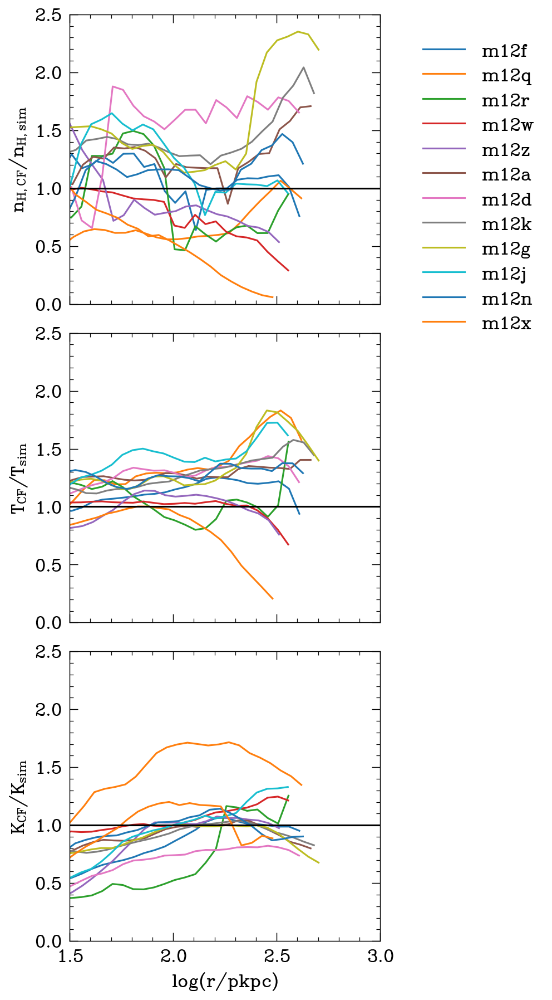

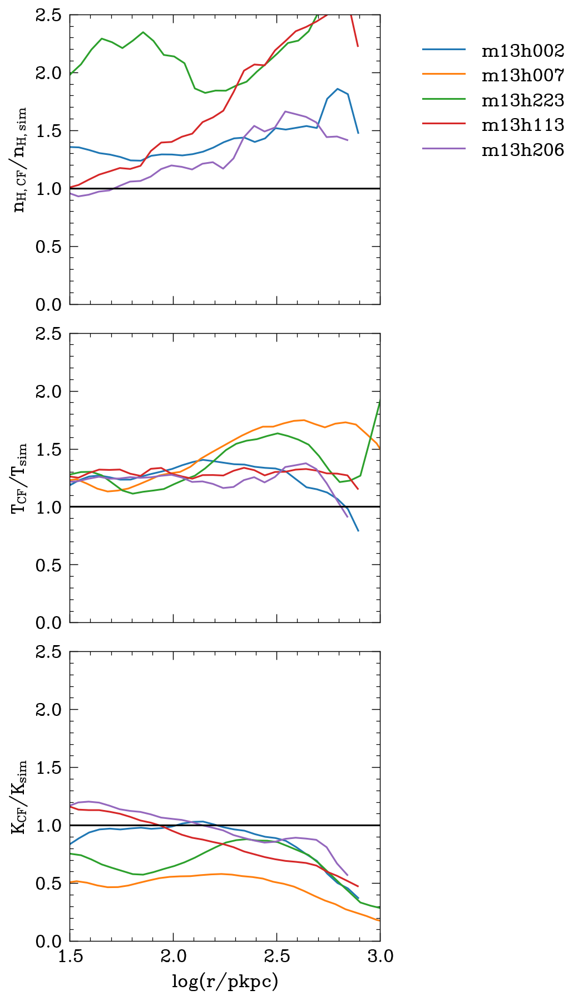

In [118]:
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])

2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.5418892222037086
2.5418892222037086
2.5418892222037086
2.5418892222037086
2.5418892222037086
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905


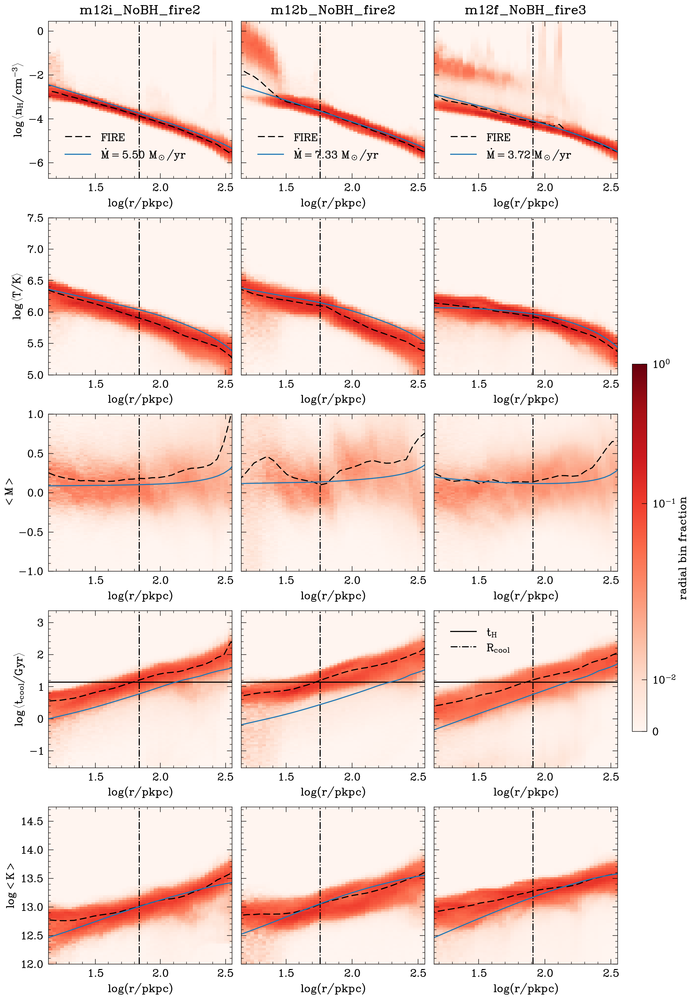

In [13]:
makecoolingflow([res['m12i_NoBH_fire2'][-1], res['m12b_NoBH_fire2'][-1], res['m12f_NoBH_fire3'][-1]])

In [24]:
bounds = {'m12f_NoBH': 0.66875,
'm12q_NoBH': 0.29500000000000004,
'm12r_NoBH': 1.5625,
'm12w_NoBH': 0.4,
'm12z_NoBH': 2.09375,
'm12a_NoBH': 0.49375,
'm12d_NoBH': 1.71875,
'm12k_NoBH': 0.21640625000000002,
'm12g_NoBH': 0.14296875000000003,
'm12j_NoBH': 0.875,
'm12n_NoBH': 0.45625000000000004,
'm12x_NoBH': 0.32499999999999996,
'm13h002_NoBH': 0.03486328125,
'm13h007_NoBH': 0.174365234375,
'm13h223_NoBH': 0.034648437500000004,
'm13h113_NoBH': 0.0303125,
'm13h206_NoBH':0.05484375}

'''
'm13h217_NoBH': 0.06568359375 (z=2.5)


    
'm12e_NoBH': Mdot Nan
'm12u_NoBH': Mdot Nan

'm13h113_NoBH':(0.0303125, 0.0303125), 'm13h206_NoBH':(0.05484375, 0.05484375)
'''

"\n'm13h217_NoBH': 0.06568359375 (z=2.5)\n\n\n    \n'm12e_NoBH': Mdot Nan\n'm12u_NoBH': Mdot Nan\n\n'm13h113_NoBH':(0.0303125, 0.0303125), 'm13h206_NoBH':(0.05484375, 0.05484375)\n"

In [25]:
def procsim(k):
    Sim = res_cf[k]
    Rlow, Rhigh = bounds[k], bounds[k]
    Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)
    return Sim

for k in bounds.keys():
#     if 'm12' not in k: continue
    print(k)
    try:
        Sim = res_cf[k]
        Rlow, Rhigh = bounds[k], bounds[k]
        Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)
    except:
        pass
    print()
# Sims = Parallel(n_jobs=-1, verbose=10)(delayed(procsim)(k) for k in bounds.keys())

m12f_NoBH
3.728708428482426 solMass / yr
0.66875 kpc
3.7225356181507703 solMass / yr

m12q_NoBH
2.89507912134337 solMass / yr
0.29500000000000004 kpc
2.8665105035454226 solMass / yr

m12r_NoBH
2.4457094288286307 solMass / yr
1.5625 kpc
2.468411379842404 solMass / yr

m12w_NoBH
0.2590367084647908 solMass / yr
0.4 kpc
0.2693319190778417 solMass / yr

m12z_NoBH
1.5432598060619729 solMass / yr
2.09375 kpc
1.5083923778867028 solMass / yr

m12a_NoBH
9.737026493864018 solMass / yr
0.49375 kpc
9.714353431914914 solMass / yr

m12d_NoBH
10.165591580928277 solMass / yr
1.71875 kpc
10.135775596587035 solMass / yr

m12k_NoBH
14.560494454234206 solMass / yr
0.21640625000000002 kpc
14.556014621156805 solMass / yr

m12g_NoBH
12.903618141877226 solMass / yr
0.14296875000000003 kpc
13.002364927659562 solMass / yr

m12j_NoBH
4.874841106103997 solMass / yr
0.875 kpc
4.838985686739442 solMass / yr

m12n_NoBH
5.769726784594694 solMass / yr
0.45625000000000004 kpc
5.824604492869462 solMass / yr

m12x_NoBH
0.

2.8271924906451846
2.8271924906451846
2.8271924906451846
2.8271924906451846
2.8271924906451846
2.966081091422276
2.966081091422276
2.966081091422276
2.966081091422276
2.966081091422276
3.037611376921929
3.037611376921929
3.037611376921929
3.037611376921929
3.037611376921929
2.825201687365501
2.825201687365501
2.825201687365501
2.825201687365501
2.825201687365501
2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7744858598262483


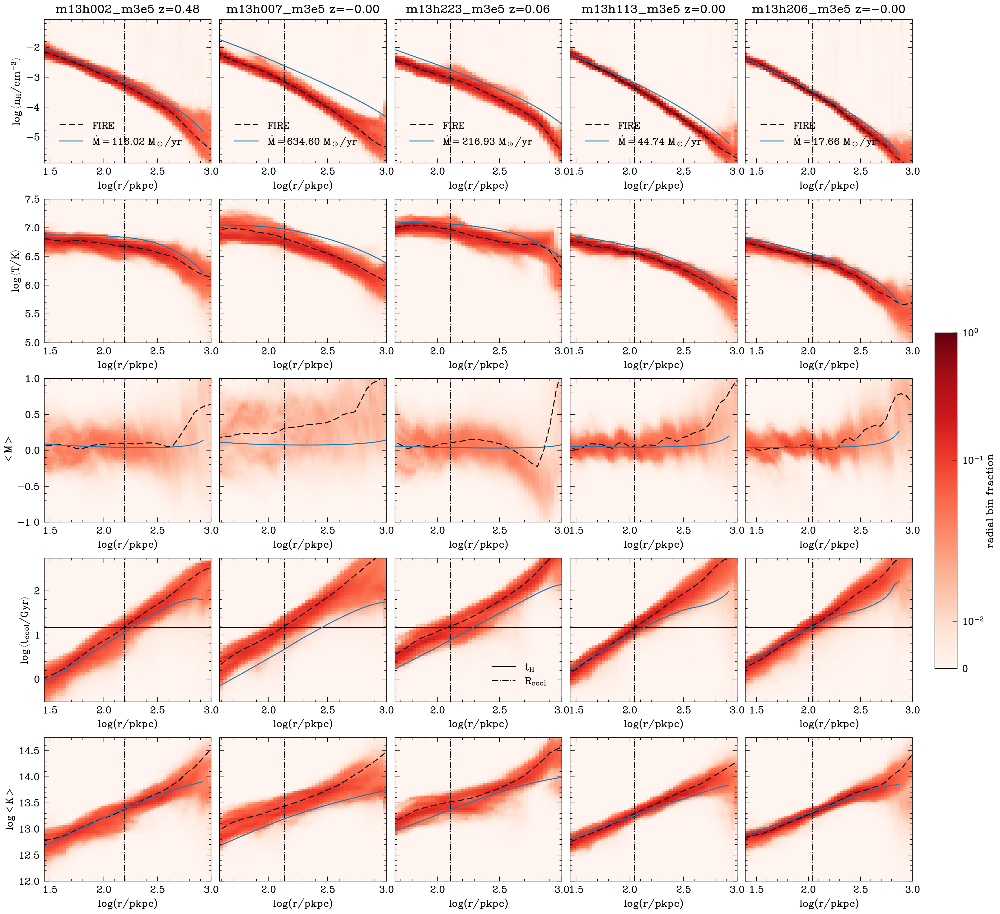

In [15]:
makecoolingflow([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])

In [ ]:
29, 31, 37, 217, 236

In [ ]:
Sim = res_cf['m13h236_NoBH']
print('z= ', Sim.Redshift[()])
Rlow, Rhigh = 0.03, .07
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)

nan -1.0 0.4788102253052198
nan -1.0 0.5522353439247717
9.737026493864018 -1.0 2.0141221072833546


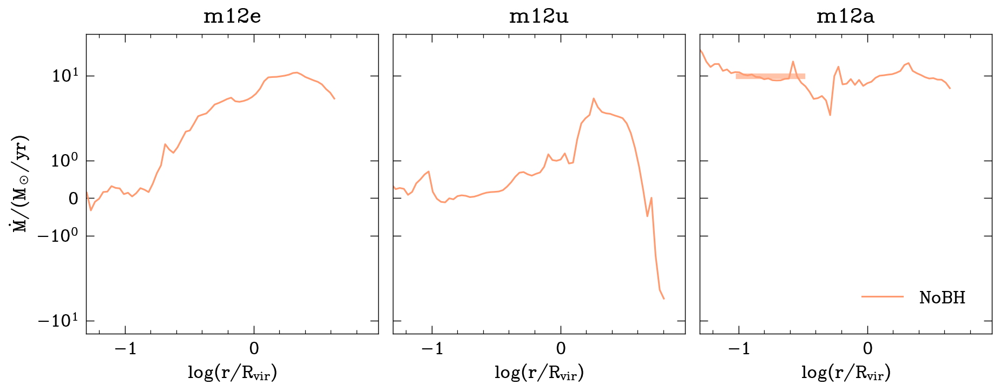

In [38]:
def makeMdotprofile(sims=['m12f', 'm12q', 'm13h113', 'm13h206'], 
                 fname=None):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*len(sims),4.8*1], dpi=150)
    for i,sim in enumerate(sims):
        axes[i].set_title(sim)
        for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
            Sim = res_cf[model]
            axes[i].plot(np.log10(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir']), Sim.Mdot_profile['Mdot'], ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
            axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
            axes[i].plot((np.log10(0.1), np.log10(Sim.Rcool/Sim.pro['Rvir'])), (Sim.Mdot_avg.value, Sim.Mdot_avg.value), '-', c=COLOR_SCHEME[mi-1], lw=5, alpha=0.6)#, ls=ls, lw=2)
            print(Sim.Mdot_avg.value, np.log10(0.1), np.log10(Sim.Rcool))
            break
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')
    axes[-1].legend(loc=4)
    axes[0].set_yscale('symlog')
    axes[0].set_xlim(np.log10(0.05))

    if fname: plt.savefig(fname)
makeMdotprofile(['m12e', 'm12u', 'm12a'])#fname='../Paper2Figs/Mdotprofiles.pdf')

115.39914814947213 -1.0 2.194603824645103
627.847309343061 -1.0 2.133492425422195
216.15391795354117 -1.0 2.1050227109218485
44.583303519703676 -1.0 2.04261302136542
17.679063623291842 -1.0 2.0418971938261676


(1.5848931924611136, 3162.2776601683795)

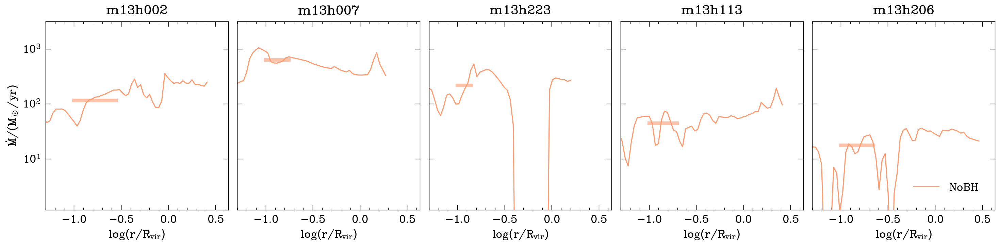

In [125]:
makeMdotprofile(['m13h002', 'm13h007', 'm13h223', 'm13h113', 'm13h206'])
plt.gca().set_ylim(10**0.2,10**3.5)

2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.559689737352484
2.559689737352484
2.559689737352484
2.5596

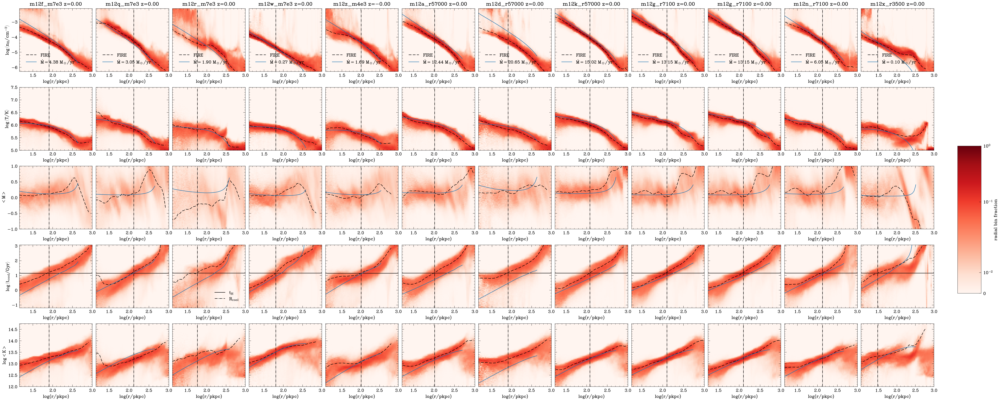

In [23]:
makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12g_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])

# plt.savefig('/Users/imran/Desktop/m12_new_Tcut.png')

2.523594698299904
2.523594698299904
2.523594698299904
2.523594698299904
2.523594698299904
2.5053678462404934
2.5053678462404934
2.5053678462404934
2.5053678462404934
2.5053678462404934
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943


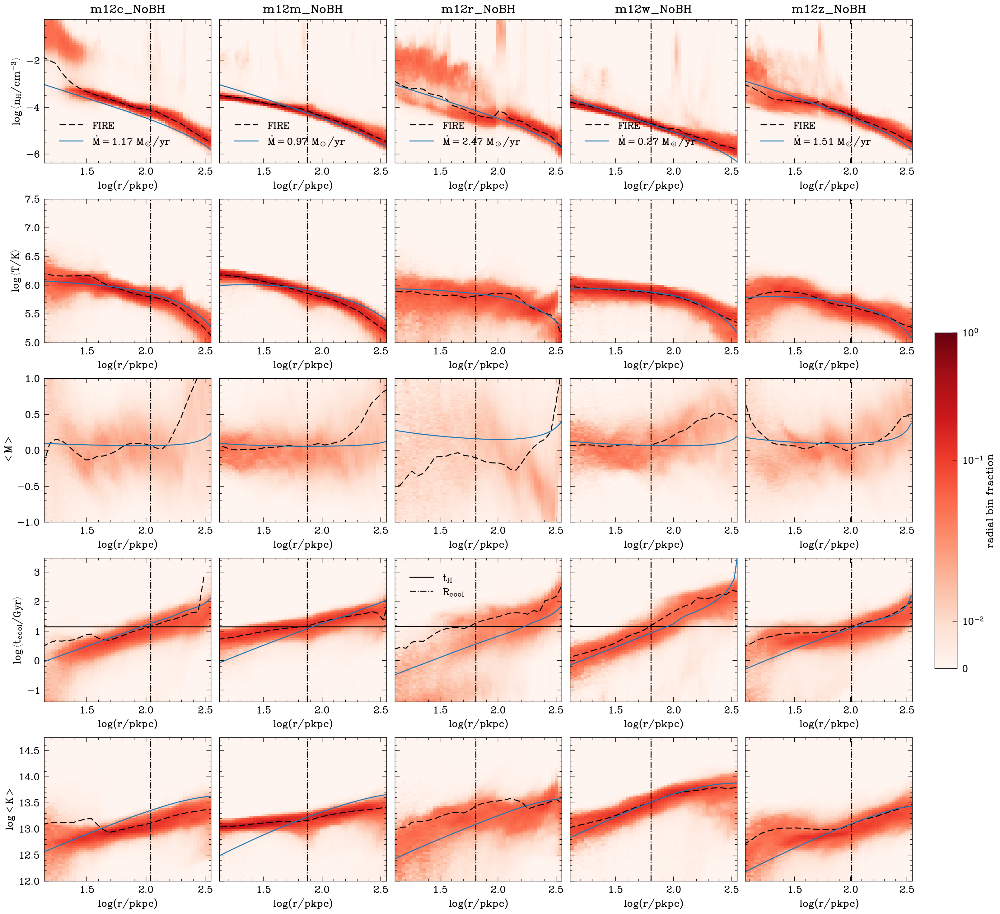

In [30]:
makecoolingflow([res_cf['m12c_NoBH'], res_cf['m12m_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH']])

## CF fitting

In [6]:
res_cf = {k : v[-1] for k,v in res.items()}# if 'fire2' not in k}

In [ ]:
bcim eu

m13h029_NoBH 0.0275

m12b_NoBH 0.49375
m12c_NoBH 0.325
m12m_NoBH 0.6
m12e_NoBH 0.321875
m12u_NoBH 0.38749999999999996

In [63]:
Sim = res_cf['m12i_NoBH']
Rlow, Rhigh = 2.55, 2.6
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc)

2.454593107597386 solMass / yr
2.55 kpc
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions


AttributeError: 'NoneType' object has no attribute 'Mdot'

In [22]:
for k, Sim in res_cf.items():
    print(f'{k}, {Sim.Redshift[()]:.02f}')
    print(Sim.Mdot_avg)
    print(Sim.Rcool== 0.5*Sim.pro['Rvir'])
    print()

m12a_NoBH, 0.00
9.737026493864018 solMass / yr
False

m12b_NoBH, 0.00
1.535713149763269 solMass / yr
False

m12c_NoBH, 0.00
1.2411353694650002 solMass / yr
False

m12d_NoBH, 0.00
10.165591580928277 solMass / yr
False

m12e_NoBH, 0.00
1.367153362437745 solMass / yr
True

m12f_NoBH, 0.00
3.728708428482426 solMass / yr
False

m12g_NoBH, 0.00
12.903618141877226 solMass / yr
False

m12i_NoBH, 0.00
2.454593107597386 solMass / yr
False

m12j_NoBH, 0.00
4.874841106103997 solMass / yr
False

m12k_NoBH, 0.00
14.560494454234206 solMass / yr
False

m12m_NoBH, 0.00
0.9588953923035911 solMass / yr
False

m12n_NoBH, 0.00
5.769726784594694 solMass / yr
False

m12q_NoBH, 0.00
2.89507912134337 solMass / yr
False

m12r_NoBH, 0.00
2.4457094288286307 solMass / yr
False

m12u_NoBH, 0.00
0.143575717339051 solMass / yr
True

m12w_NoBH, 0.00
0.2590367084647908 solMass / yr
False

m12x_NoBH, 0.00
0.09809815201343872 solMass / yr
False

m12z_NoBH, -0.00
1.5432598060619729 solMass / yr
False

m13h002_NoBH, 0.48
1

In [6]:
resdict = {}

In [ ]:
'm13h007_NoBH': np.linspace(0.011,0.09,100)
'm13h002_NoBH':
'm13h223_NoBH': 
'm13h113_NoBH':
'm13h206_NoBH':
    
'm12z_NoBH': np.linspace(.5,1.5,100)
f'm12{s}_NoBH': np.linspace(.1,1,100)
'm13h206_NoBH': np.linspace(0.011,0.09,100)

In [7]:
#log space
bins = np.logspace(-2,1,100)
simnames = sorted(['m13h007_NoBH', 'm13h002_NoBH', 'm13h223_NoBH', 'm13h113_NoBH', 'm13h206_NoBH'] + [f'm12{s}_NoBH' for s in 'fqrwzadkgjnx'])

for simname in simnames:
    Sim = res_cf[simname]
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)


    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict[simname] = reslist

In [22]:
bins = np.linspace(0.011,0.09,100)

for simname in ['m13h007_NoBH', 'm13h002_NoBH', 'm13h223_NoBH', 'm13h113_NoBH', 'm13h206_NoBH']:
# for s in 'fqrwzadkgjnx':
#     simname = f'm12{s}_NoBH'
    Sim = res_cf[simname]
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)


    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict[simname] = reslist

In [41]:
bins = np.linspace(.1,1,100)

for s in 'fqrwzadkgjnx':
    simname = f'm12{s}_NoBH'
    Sim = res_cf[simname]
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)


    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict[simname] = reslist

In [81]:
s='z'
bins = np.logspace(-2,1,100)#np.linspace(0.011,0.09,100)

simname = f'm12{s}_NoBH'
# simname = 'm12i_NoBH_fire2'
Sim = res_cf[simname]
cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift, LambdaFactor=1)


def solution(R_sonic, R_min=1, R_max=1.5):
    with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
        try:
            return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc)
        except:
            return -1

reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
resdict[simname] = reslist

KeyboardInterrupt: 

In [9]:
def CF_fitting(resdict, res_cf):
    for simname, reslist in resdict.items():
        Sim = res_cf[simname]
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']
        plt.figure()
        chi2 = []
        for Rsonic, res in zip(bins, reslist):
            try:
                res_x = np.log10(res.Rs().to(un.kpc).value)
                rmid2 = rmid[rmid<10**res_x.max()]


                CF_nH = res.nHs().to(un.cm**-3).value
                CF_T = res.Ts().to(un.K).value
                CF_K = (res.P2ks().to(un.K/un.cm**3) / (res.rhos().to(un.Msun/un.kpc**3)/1e10)**(5/3)).value
    #             plt.plot(np.log10(rmid2), 10**pro['K'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_K)(rmid2), '-.')
                plt.plot(np.log10(rmid2), 10**pro['T'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_T)(rmid2), '-', label='$T$')
                plt.plot(np.log10(rmid2), 10**pro['nH'][rmid<10**res_x.max()] / interp1d(10**res_x, CF_nH)(rmid2), '--', label='$n_H$')
                if Rsonic==bins[0]: plt.legend()

                idx = (0.1*pro['Rvir']<=rmid)&(rmid<=Sim.Rcool)
                ob = 10**pro['K'][idx]
                ex = interp1d(10**res_x, CF_K)(rmid[idx])

                ob_nH = 10**pro['nH'][idx]
                ob_T = 10**pro['T'][idx]
                ex_nH = interp1d(10**res_x, CF_nH)(rmid[idx])
                ex_T = interp1d(10**res_x, CF_T)(rmid[idx])

                #chi2.append(np.sum((ob - ex)**2 / ex) / (len(ex)-1))
                chi2.append(np.sum(np.abs((ob_T - ex_T)) / ex_T) + np.sum(np.abs((ob_nH - ex_nH)) / ex_nH))
    #             chi2.append(np.sum((ob_T - ex_T)**2 / ex_T) / (len(ex_T)-1))
            except:
                chi2.append(np.nan)

        try:
            Sim.transonic_solution = reslist[np.nanargmin(chi2)] 
        except:
            pass

        plt.axhline(1)
        plt.axvspan(np.log10(0.1*Sim.pro['Rvir']), np.log10(Sim.Rcool), alpha=0.25, color='gray')
        plt.ylim(0,2)
        plt.xlim(1.3,2.5)
        plt.title(f'{simname} z={Sim.Redshift[()]:.3f}')
        plt.xlabel('$\log (r/\mathrm{pkpc})$')
        plt.ylabel('sim/CF')

        plt.figure()
        plt.plot(bins, chi2, '.')
        plt.yscale('log')

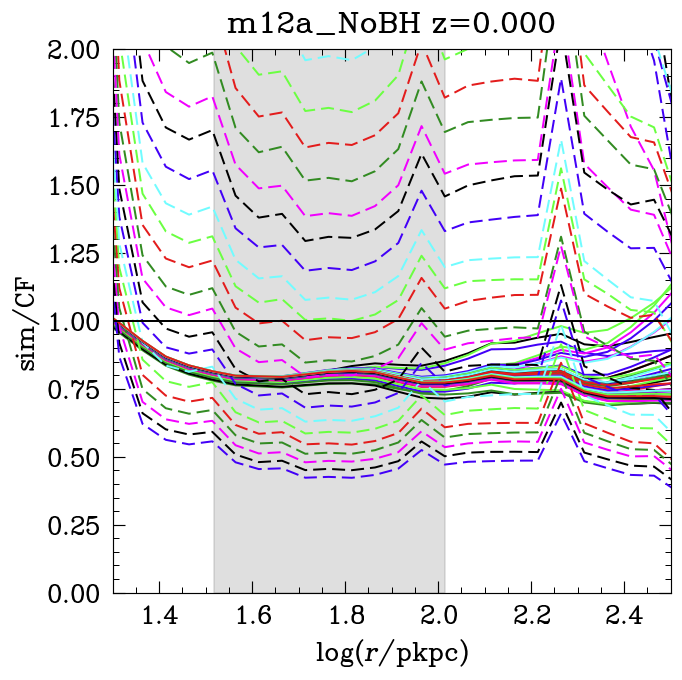

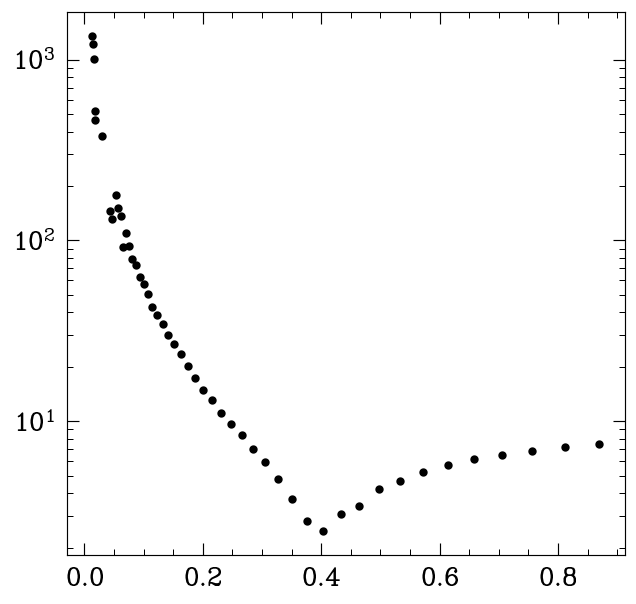

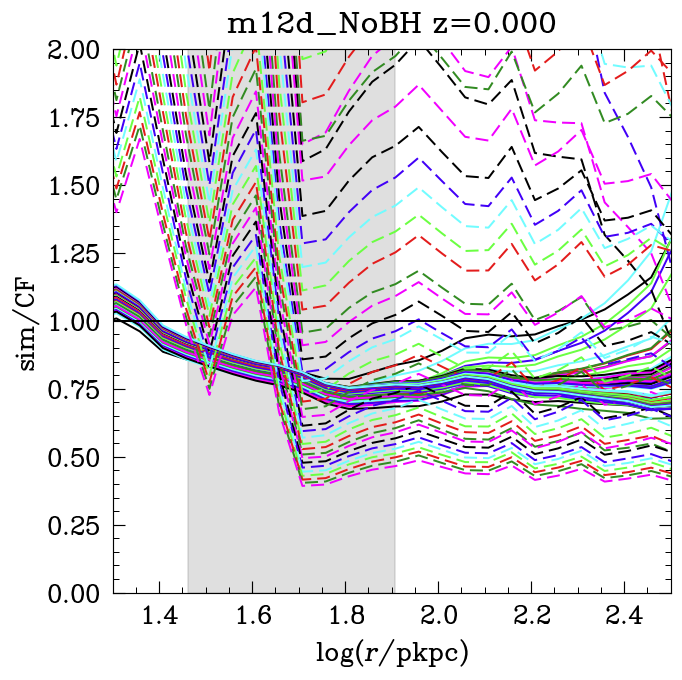

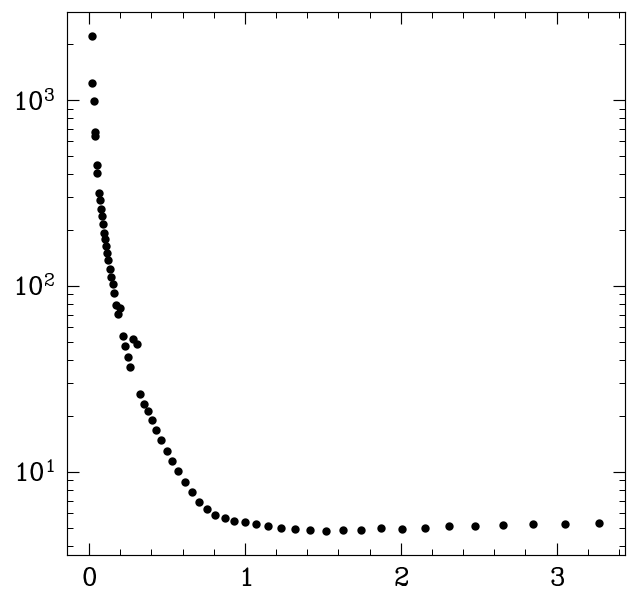

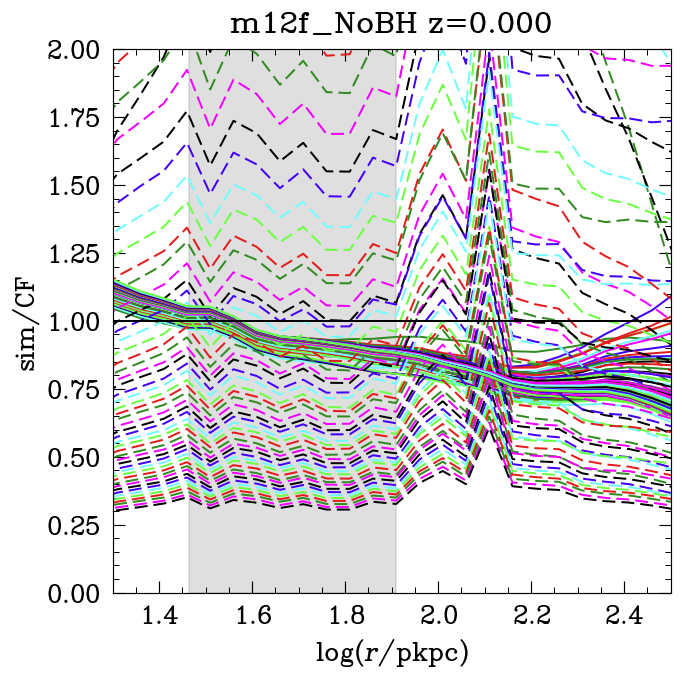

...

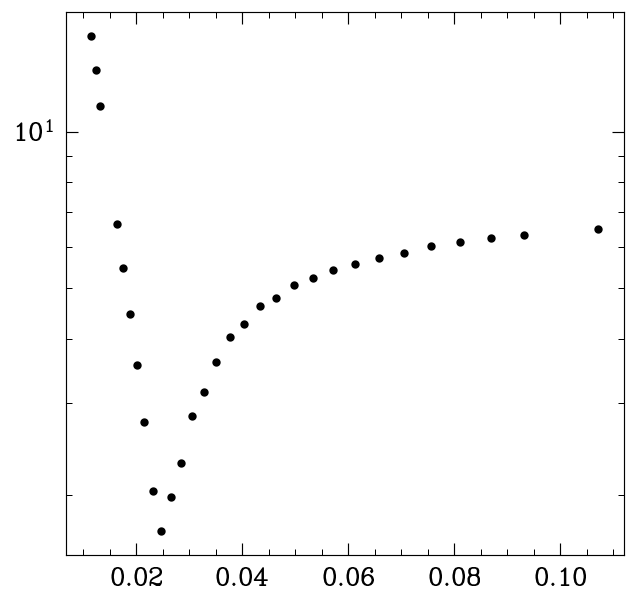

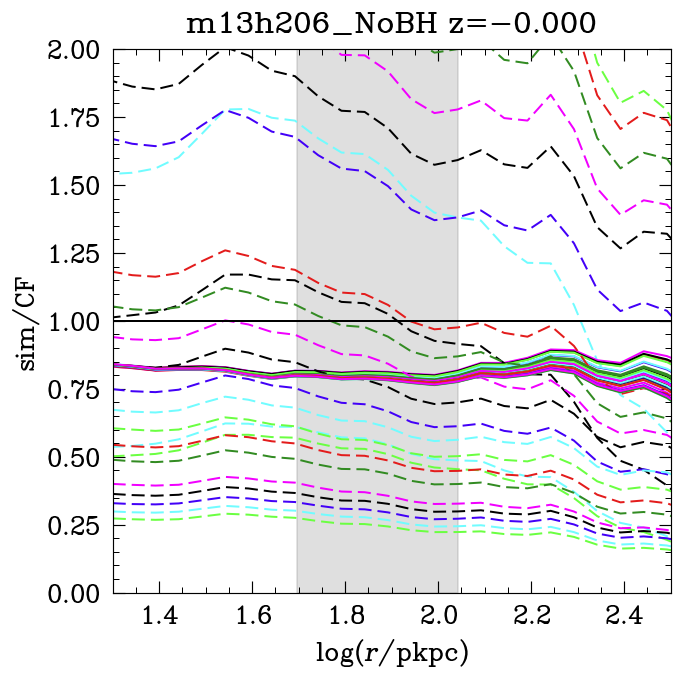

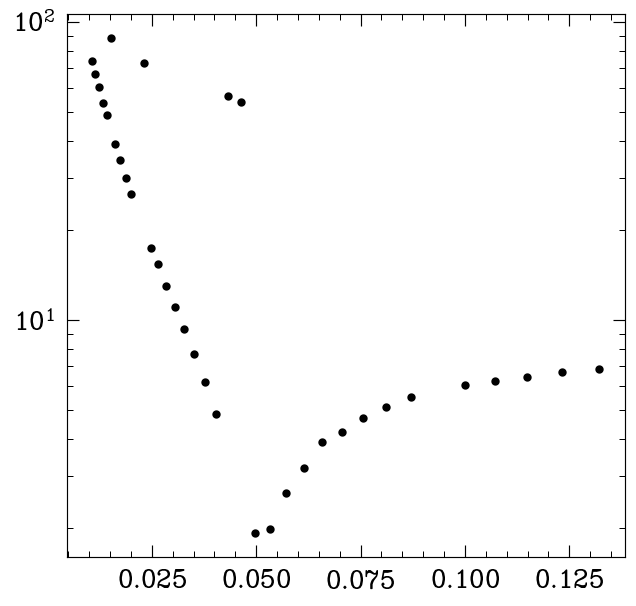

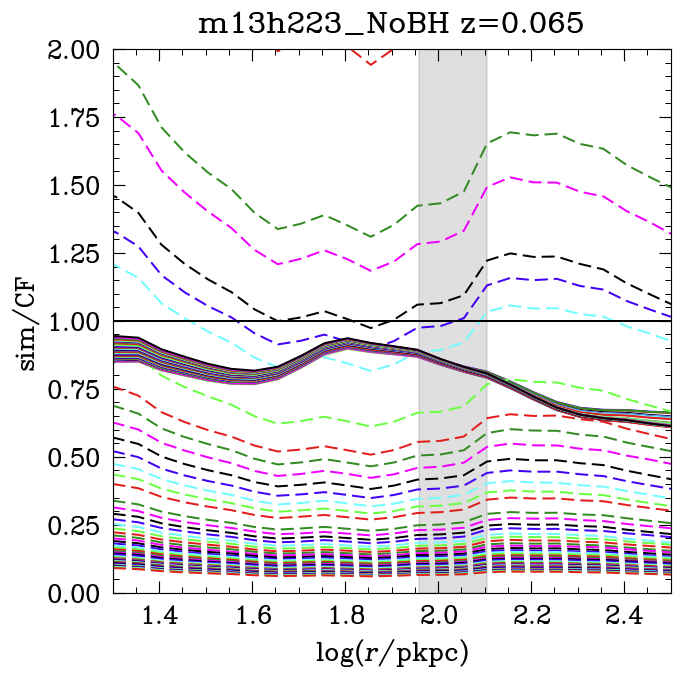

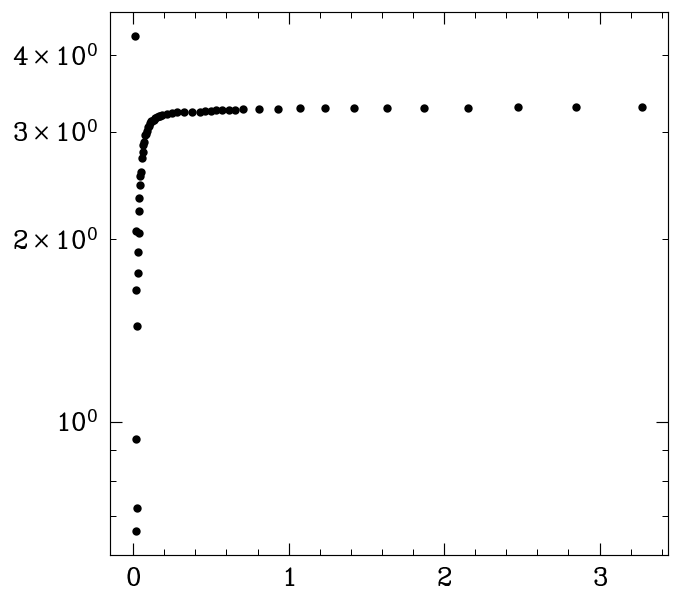

no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_

In [11]:
CF_fitting(resdict, res_cf)

2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773


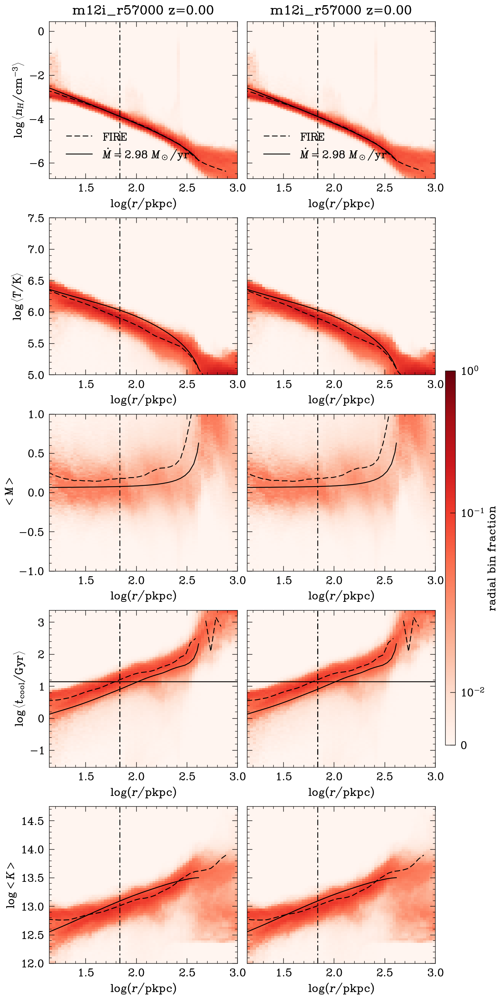

no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_

In [31]:
Sim.transonic_solution = reslist[np.nanargmin(chi2)]
makecoolingflow([Sim, Sim])

2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.486434327358767
2.486434327358767
2.486434327358767
2.486434327358767
2.486434327358767
2.559689737352484
2.559689737352484
2.559689737352484
2.559689737

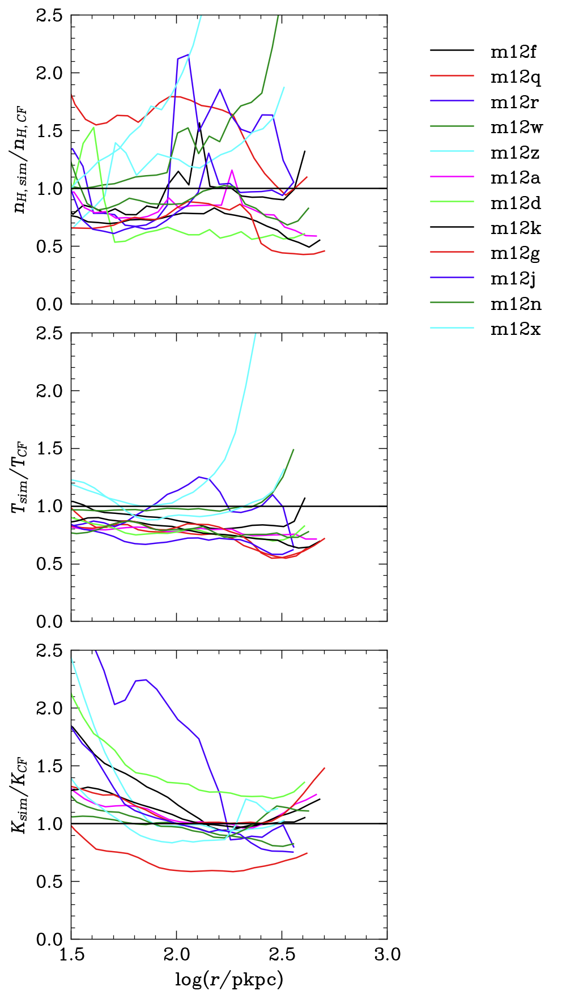

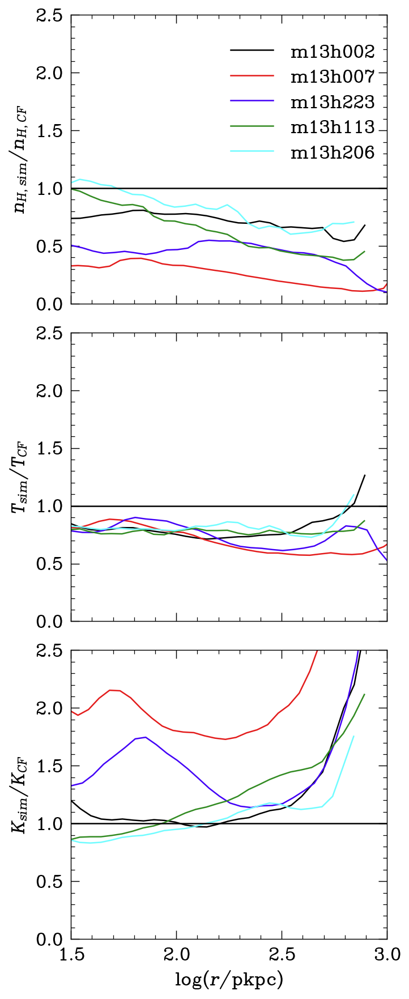

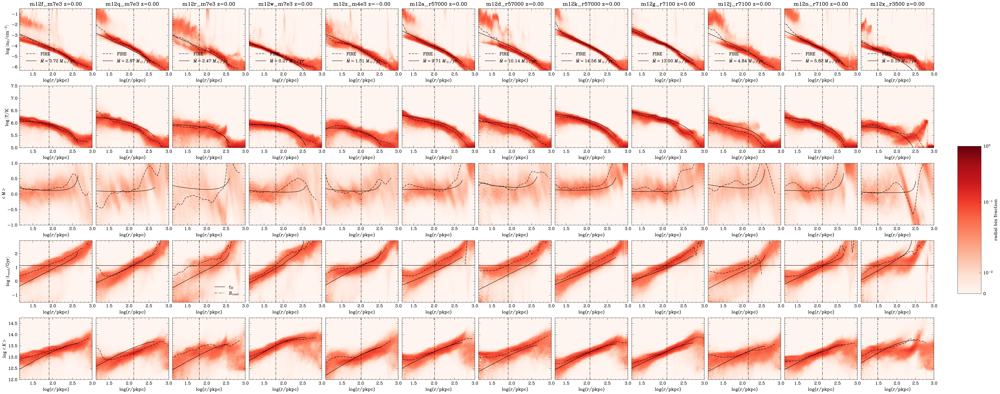

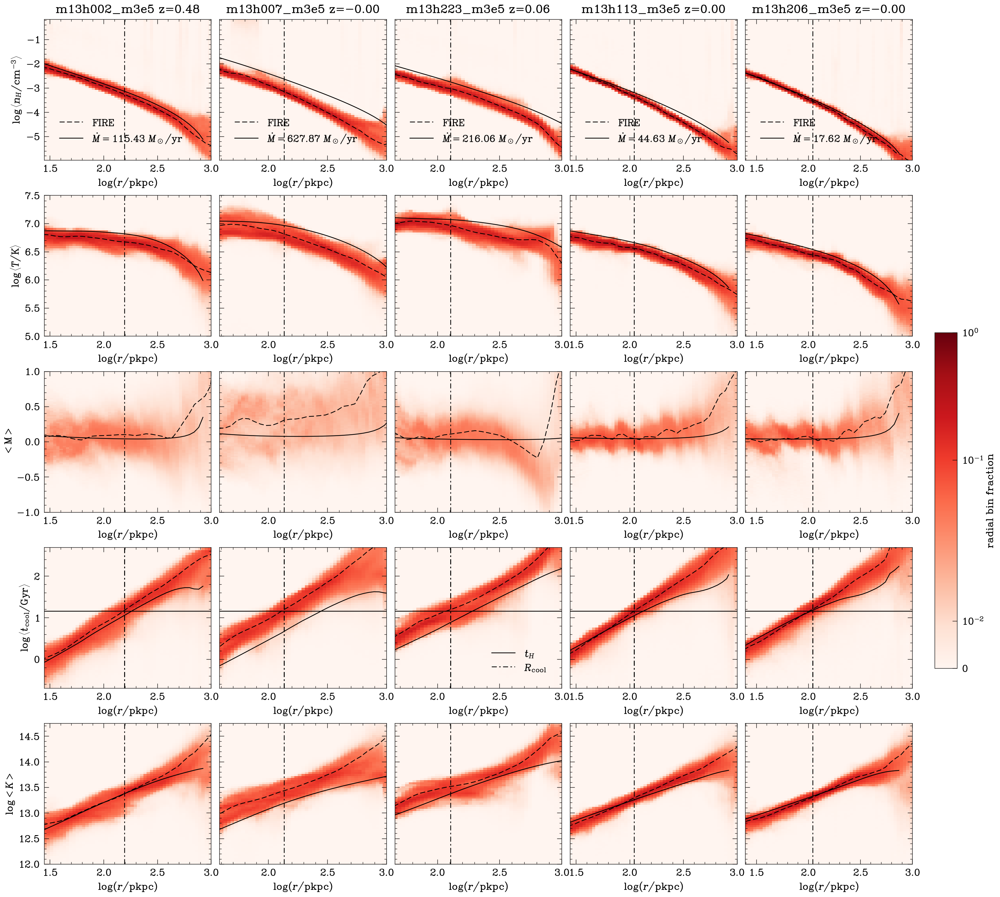

In [24]:
### Mdot from sim ###
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFratios_sim_m12.png')

makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFratios_sim_m13.png')

makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFprofiles_sim_m12.png')

makecoolingflow([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFprofiles_sim_m13.png')

2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.488528442969779
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.443894317474943
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.559689737352484
2.559689737352484
2.559689737352484
2.559689737352484
2.559689737352484
2.4125951545918722
2.4125951545918722
2.4125951545918722
2.412595

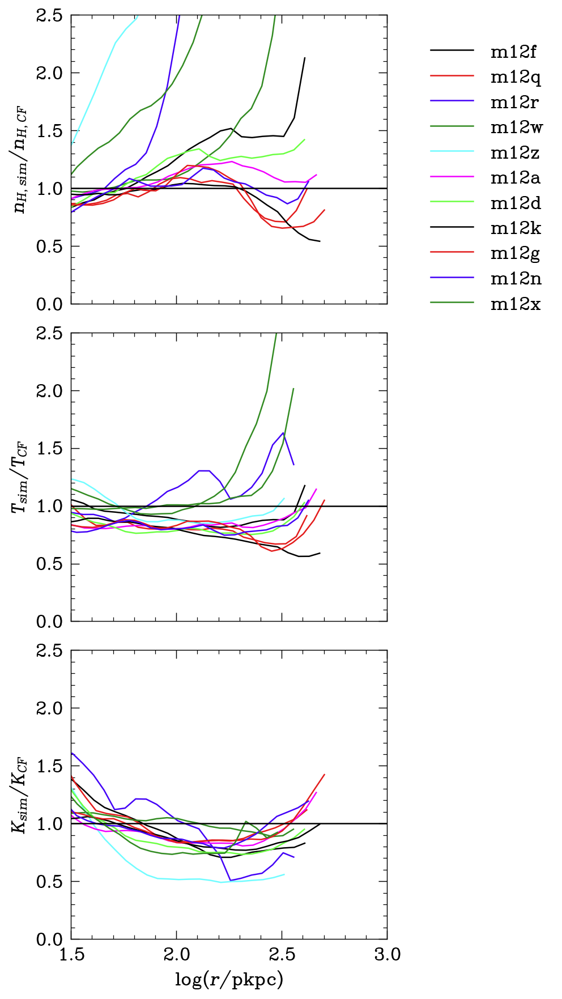

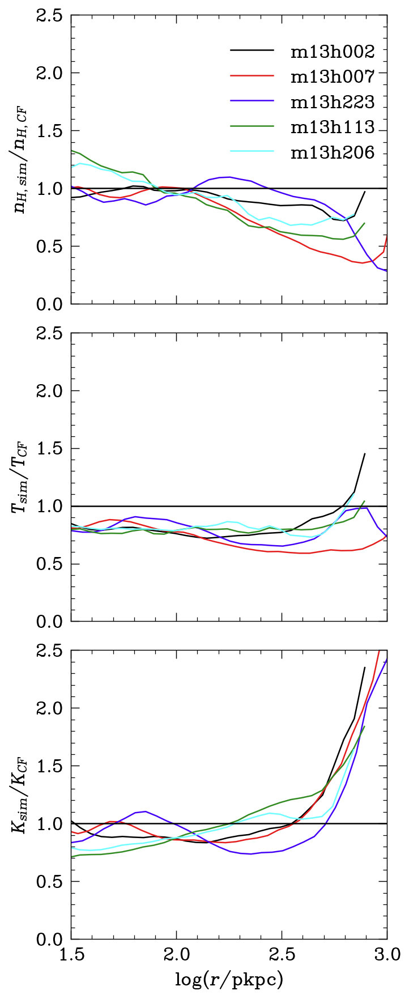

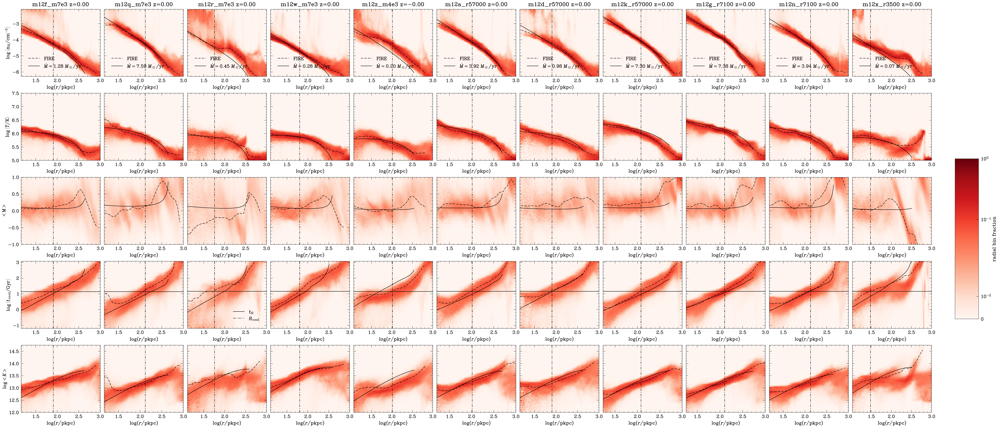

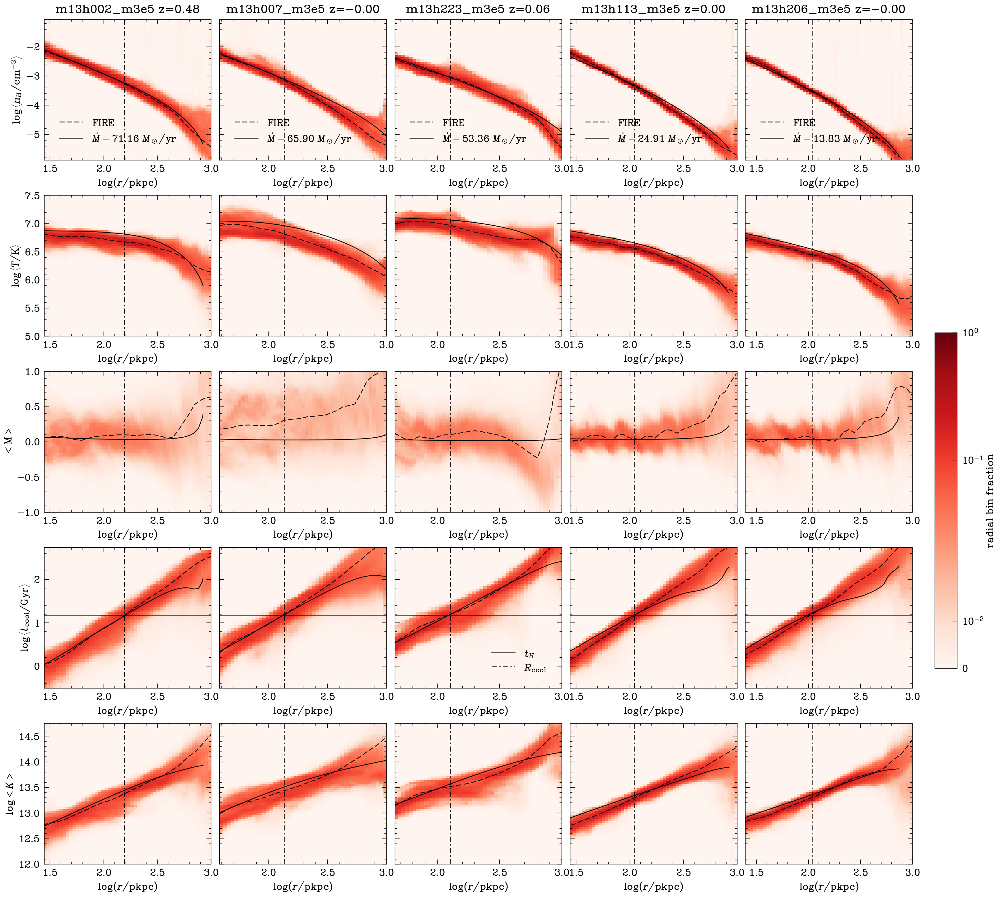

In [19]:
### Fitting ###
# makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFratios_fitTnHTcut_m12.png')

makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFratios_fitTnHTcut_m13.png')

# makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFprofiles_fitTnHTcut_m12.png')

makecoolingflow([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFprofiles_fitTnHTcut_m13.png')

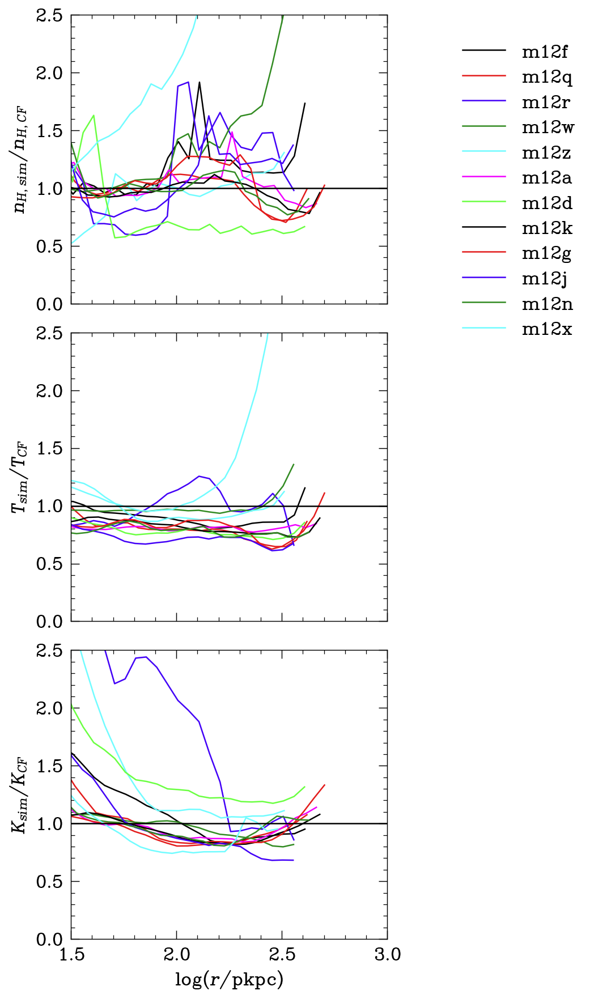

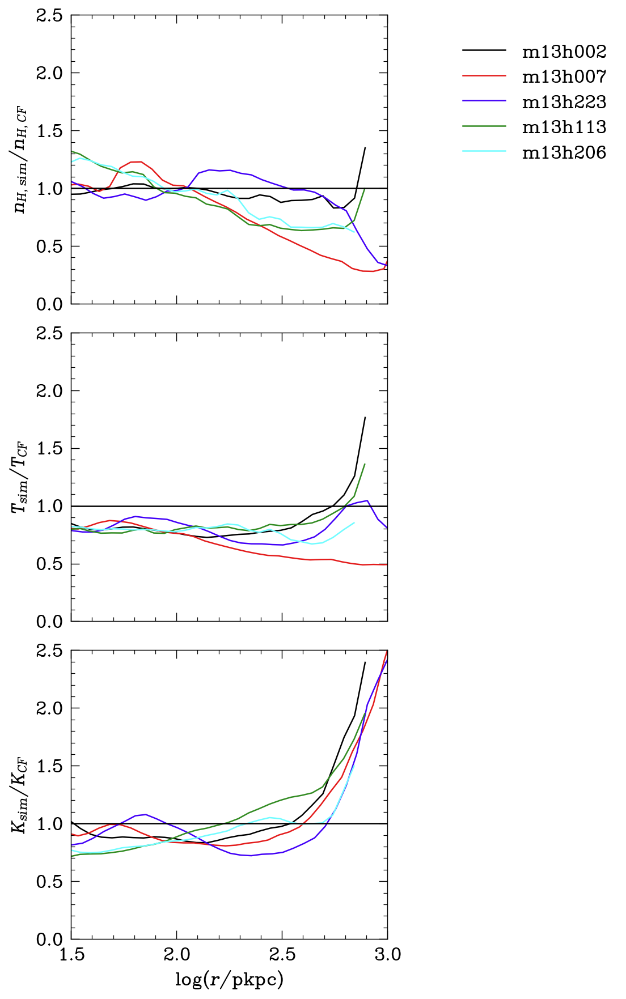

In [100]:
### Paper: Fitting ###
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../Paper2Figs/CFratios_fitTnH_m12.pdf')

makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../Paper2Figs/CFratios_fitTnH_m13.pdf')

2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.825201687365501
2.825201687365501
2.825201687365501
2.825201687365501
2.825201687365501
2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7744858598262483


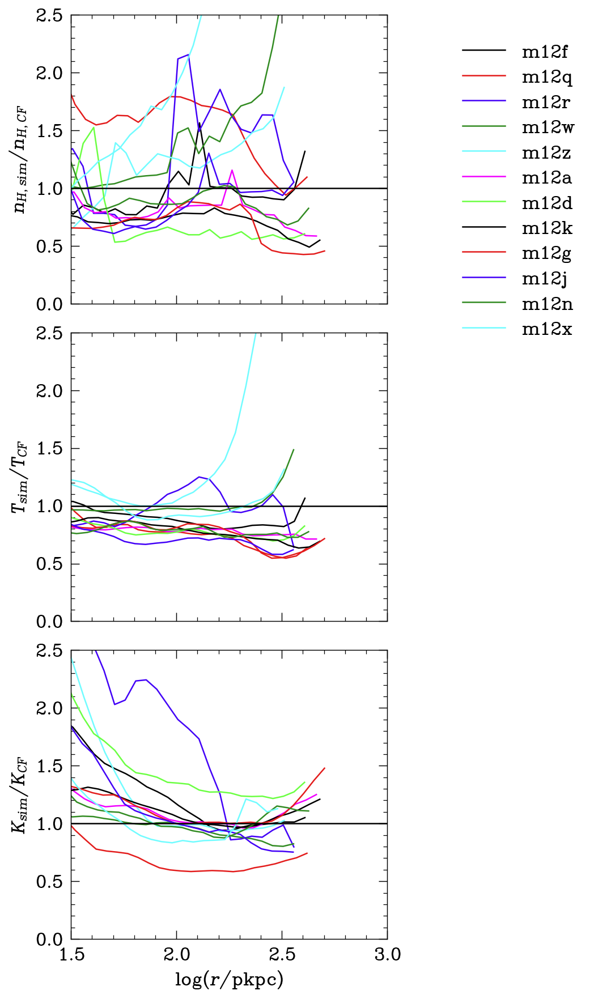

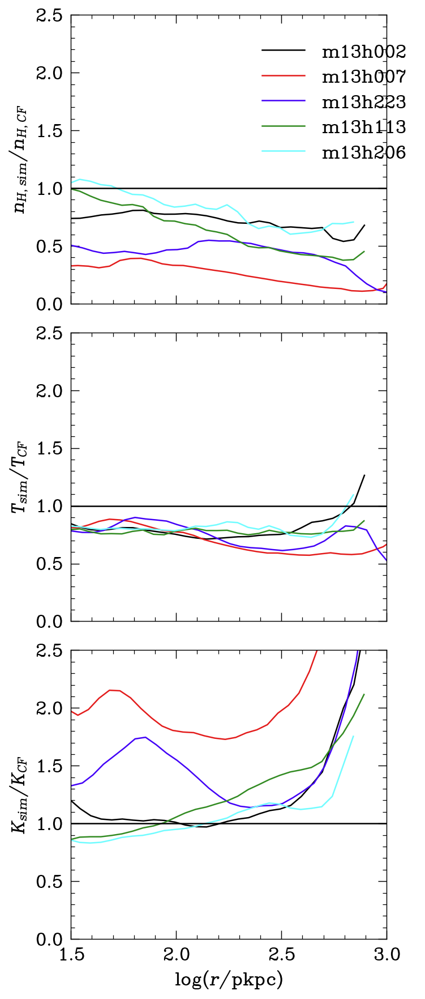

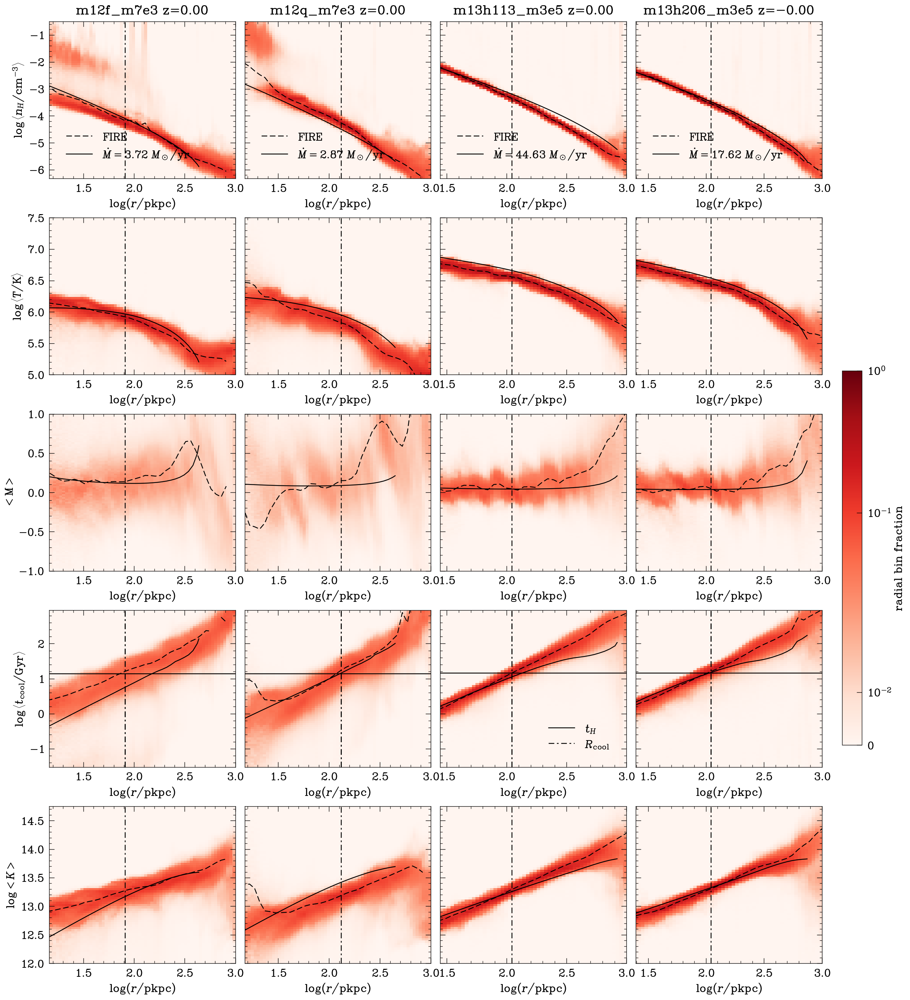

In [29]:
### Paper: Mdot from sim ###
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../CFratios_sim_m12.pdf')

makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFratios_sim_m13.pdf')

makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../CFprofiles_sim_m12_m13.pdf')

### tcool discrepancy

In [76]:
plt.rcParams.update({'font.size': 18})
def colormap(k, ax, sim):
    d = getattr(sim, f'cmap_{k}')
    im = ax.pcolormesh(d['X'], d['Y'], d['H'], cmap='Reds', norm=colors.SymLogNorm(linthresh=0.03, vmin=0, vmax=1))
    return im
def makecoolingflow(Sims, fname=None):
    
    ylabels = [r'$\log \left< t_{\mathrm{cool}} / \mathrm{Gyr} \right>$',
               r'$P$',
               r'$\Lambda$'
            ]

    prolabels = ['tcoolshell', 'P_th', 'Lambda']
    
    fig, axes = plt.subplots(len(ylabels), len(Sims), sharex='col', sharey='row', gridspec_kw={'wspace': .05, 'hspace':.25}, figsize=[4.8*len(Sims),4.8*len(ylabels)], dpi=150, facecolor='w')
    
    for mi,Sim in enumerate(Sims):
        pro = Sim.pro
        rmid = pro['rmid']*pro['Rvir']
        
        pro['Lambda'] = ((5/3-1) * (10**pro['tcool'])*un.Gyr * ((10**pro['nH'])*un.cm**-3 )**2 / ((10**pro['Pth_Mweighted'])*cons.k_B*un.K/un.cm**3))**(-1)
        pro['Lambda'] = np.log10(pro['Lambda'].to(un.cm**3*un.erg/un.s).value)
        

        axes[0,mi].axhline(np.log10(Sim.tHubble), label=r'$t_H$', c='k')
        #TODO axes[3,mi].axhline(np.log10(Sim.tHubble * (1+Sim.Redshift)**(-3/2)), c='r')
        axes[0,mi].axvline(np.log10(Sim.Rcool), label=r'$R_{\mathrm{cool}}$', c='k', ls='-.')
        if mi==2: axes[0,mi].legend()

        axes[-1,mi].set_xlabel('$\log (r/\mathrm{pkpc})$')

        # Add FIRE-3 curves
        for ax, ylabel, prolabel in zip(axes[:,mi], ylabels, prolabels):
            ax.set_xlim(.4,3); print(np.log10(1.2*pro['Rvir'])) #2.65
            # ax.axvline(np.log10(0.05*pro['Rvir']))
            ax.axvline(np.log10(Sim.Rcool), c='k', ls='-.')
            ax.set_xlim(np.log10(0.05*pro['Rvir']))
            ax.plot(np.log10(rmid), pro[prolabel], 'k--', label='FIRE')
            ax.xaxis.set_tick_params(labelbottom=True)
            ax.set_xlabel('$\log (r/\mathrm{pkpc})$')
            if mi==0: ax.set_ylabel(ylabel)
            if prolabel=='nH': ax.set_title(['_'.join(v.split('_')[:2]) for k,v in PaperSimNames.items() if v==Sim.simname][0] + f' z={np.abs(Sim.Redshift[()]):.2f}')#ax.set_title(Sim.simname.split('_')[0])
        for ax in axes[[0,1]].flatten():
            ax.set_xlim(ax.get_xlim())
            ax.set_ylim(ax.get_ylim())
        axes[0,0].set_ylim(-1.25,3.25)
        axes[2,0].set_ylim(-24,-22)
        # Add FIRE-3 colormaps
        im = colormap('tcool', axes[0,mi], Sim)

        # Add cooling flow Rcirc solution curves
        res = Sim.transonic_solution#stalled_solution#
        res_x = np.log10(res.Rs().to(un.kpc).value)

#         axes[0,mi].plot(res_x, np.log10(res.nHs().to(un.cm**-3).value), label=f'$\dot{{M}}={res.Mdot.value:.2f}\ M_\odot/\mathrm{{yr}}$')
#         axes[1,mi].plot(res_x, np.log10(res.Ts().to(un.K).value))
#         axes[2,mi].plot(res_x, res.Ms())
        axes[0,mi].plot(res_x, np.log10(res.t_cools().to(un.Gyr).value))
    
        axes[1,mi].plot(res_x, np.log10((res.P2ks().to(un.K/un.cm**3)).value))
        
        tcool = (res.P2ks()*cons.k_B/((5/3-1)*(res.nHs()**2*res.Lambdas()))).to('Gyr')
        axes[0,mi].plot(res_x, np.log10(tcool.value), '--')
        
        axes[2,mi].plot(res_x, np.log10(res.Lambdas().value))

        # axes[0,mi].set_xlim(0.4,3)
        axes[0,mi].legend(loc=3)

    # Add the colorbar to the figure
    cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.3]) # [left, bottom, width, height]
    cbar = fig.colorbar(im, cax=cbar_ax, orientation='vertical')
    cbar.set_label('radial bin fraction')
    fig.tight_layout()
    if fname: plt.savefig(fname, bbox_inches='tight')
    return fig, axes

2.5422440663405905
2.5422440663405905
2.5422440663405905
2.5518887390146623
2.5518887390146623
2.5518887390146623
2.4897337532035646
2.4897337532035646
2.4897337532035646
2.488528442969779
2.488528442969779
2.488528442969779
2.443894317474943
2.443894317474943
2.443894317474943
2.5967107732834362
2.5967107732834362
2.5967107732834362
2.5405593011809575
2.5405593011809575
2.5405593011809575
2.6129110210906905
2.6129110210906905
2.6129110210906905
2.6352099365367936
2.6352099365367936
2.6352099365367936
2.486434327358767
2.486434327358767
2.486434327358767
2.559689737352484
2.559689737352484
2.559689737352484
2.4125951545918722
2.4125951545918722
2.4125951545918722


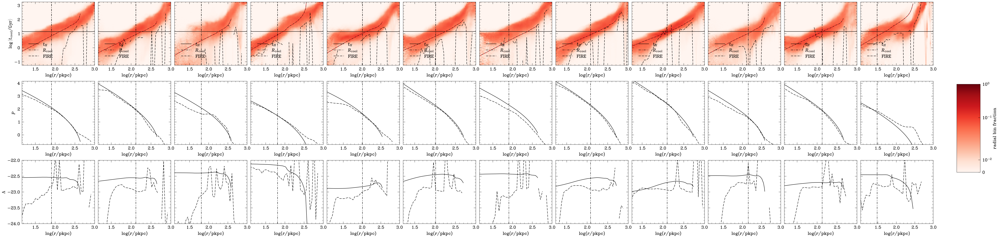

In [77]:
makecoolingflow([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']]);

2.8271924906451846
2.8271924906451846
2.8271924906451846
2.966081091422276
2.966081091422276
2.966081091422276
3.037611376921929
3.037611376921929
3.037611376921929
2.825201687365501
2.825201687365501
2.825201687365501
2.7744858598262483
2.7744858598262483
2.7744858598262483


(<Figure size 3600x2160 with 16 Axes>,
 array([[<AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$', ylabel='$\\log \\left< t_{\\mathrm{cool}} / \\mathrm{Gyr} \\right>$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>],
        [<AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$', ylabel='$P$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>],
        [<AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$', ylabel='$\\Lambda$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <AxesSubplot:xlabel='$\\log (r/\\mathrm{pkpc})$'>,
         <Axes

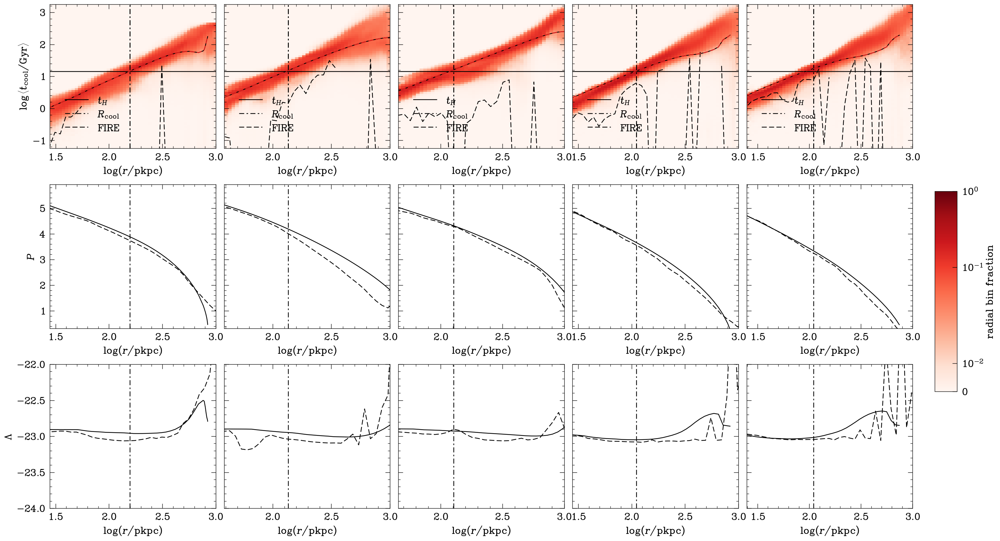

In [78]:
makecoolingflow([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])

### tcool calculations

In [61]:
Sim_m12fNoBH = Simulation(sim_path_fire3(PaperSimNames['m12b_NoBH']), 500)
R_sonic = 0.49375*un.kpc#0.66875*un.kpc
Sim_m12fNoBH.transonic_solution, Sim_m12fNoBH.R_sonic_mid = Sim_m12fNoBH.binary_search_R_sonic(R_sonic, R_sonic)

1.535713149763269 solMass / yr
0.49375 kpc
1.4685956209595041 solMass / yr


In [62]:
keys_to_extract = {
            0:['Coordinates', 'Masses', 'Density', 
            'Temperature', 'InternalEnergy', 'CosmicRayEnergy', 
            'Velocities', 'Metallicity', 'SoundSpeed', 'CoolingRate', 'SmoothingLength'],
            1:['Coordinates', 'Masses', 'Velocities'],
            2:['Coordinates', 'Masses', 'Velocities'],
            4:['Coordinates', 'Masses', 'Velocities'],
            5:['Coordinates', 'Masses', 'Velocities']
        }

p = load_allparticles(sim_path_fire3(PaperSimNames['m12b_NoBH'], quest=True), snapnum=500, 
                    particle_types=sorted(keys_to_extract.keys()), 
                    keys_to_extract=keys_to_extract, 
                    Rvir='None', loud=0)

In [63]:
# Calculate number density of hydrogen atoms
XH = 1 - p[0]['Metallicity'][:,0] - p[0]['Metallicity'][:,1] #hydrogen mass fraction
nH = ( XH * (p[0]['Density'] * 1e10 * un.Msun/un.kpc**3) / cons.m_p ).to(un.cm**-3) #number density of hydrogen atoms
p[0]['nH'] = nH.to(un.cm**-3).value

In [64]:
Zsun = 0.0142 #Asplund+09

Rmax_Z=1

# Calculate mass-weighted average metallicity/Zsun within Rmax_Z*Rvir
p[0]['Z2Zsun']  = np.sum((p[0]['Metallicity'][:,0] * p[0]['Masses'])[p[0]['r_scaled']<=Rmax_Z]) / np.sum(p[0]['Masses'][p[0]['r_scaled']<=Rmax_Z]) / Zsun

In [65]:
Zbins = 1000
Zidxsplit = np.array_split( np.argsort(p[0]['Metallicity'][:,0]/Zsun), Zbins )
p[0]['tcool'] = np.zeros_like(p[0]['nH'])
p[0]['CoolingRate'] = np.zeros_like(p[0]['nH'])
for Zidx in Zidxsplit:
    Z2Zsun = np.mean(p[0]['Metallicity'][Zidx,0]) / Zsun
    cooling = Cool.Wiersma_Cooling(Z2Zsun, p[0]['Redshift'])
    CoolingRate_pred = cooling.LAMBDA(p[0]['Temperature'][Zidx]*un.K, p[0]['nH'][Zidx]*(un.cm**-3)) * (p[0]['nH'][Zidx]*(un.cm**-3))**2
    tcool_pred = ((Pressure(p[0]['InternalEnergy'][Zidx], p[0]['Density'][Zidx], typeP='thermal') * cons.k_B * un.K / un.cm**3) / ( CoolingRate_pred * (5/3-1) ))
    p[0]['tcool'][Zidx] = tcool_pred.to(un.Gyr).value
    p[0]['CoolingRate'][Zidx] = CoolingRate_pred.to(un.erg/un.s*un.cm**-3).value

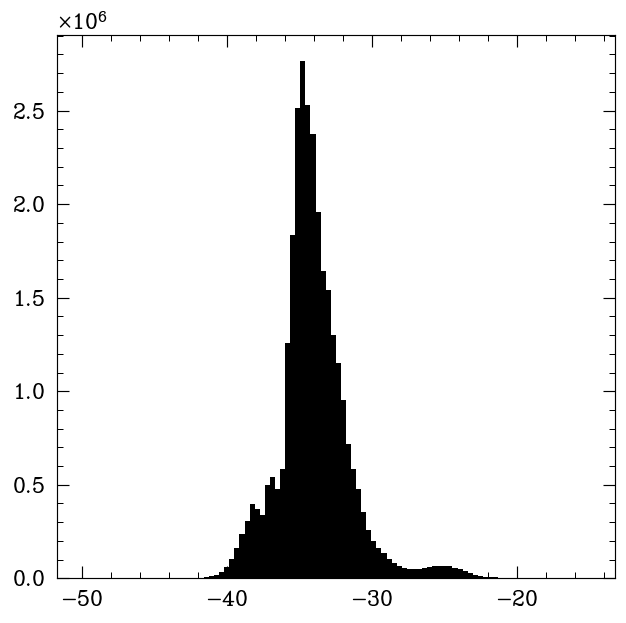

In [40]:
plt.hist(np.log10(p[0]['CoolingRate']), range=(-50,-15), bins=100);

In [109]:
for Zbins in [1, 10, 100, 1000, 10000]:
    Zidxsplit = np.array_split( np.argsort(p[0]['Metallicity'][:,0]/Zsun), Zbins )
    p[0][f'tcool_{Zbins}'] = np.zeros_like(p[0]['nH'])
    p[0][f'CoolingRate_{Zbins}'] = np.zeros_like(p[0]['nH'])
    for Zidx in Zidxsplit:
        Z2Zsun = np.mean(p[0]['Metallicity'][Zidx,0]) / Zsun
        cooling = Cool.Wiersma_Cooling(Z2Zsun, p[0]['Redshift'])
        CoolingRate_pred = cooling.LAMBDA(p[0]['Temperature'][Zidx]*un.K, p[0]['nH'][Zidx]*(un.cm**-3)) * (p[0]['nH'][Zidx]*(un.cm**-3))**2
        tcool_pred = ((Pressure(p[0]['InternalEnergy'][Zidx], p[0]['Density'][Zidx], typeP='thermal') * cons.k_B * un.K / un.cm**3) / ( CoolingRate_pred * (5/3-1) ))
        p[0][f'tcool_{Zbins}'][Zidx] = tcool_pred.to(un.Gyr).value
        p[0][f'CoolingRate_{Zbins}'][Zidx] = CoolingRate_pred.to(un.erg/un.s*un.cm**-3).value

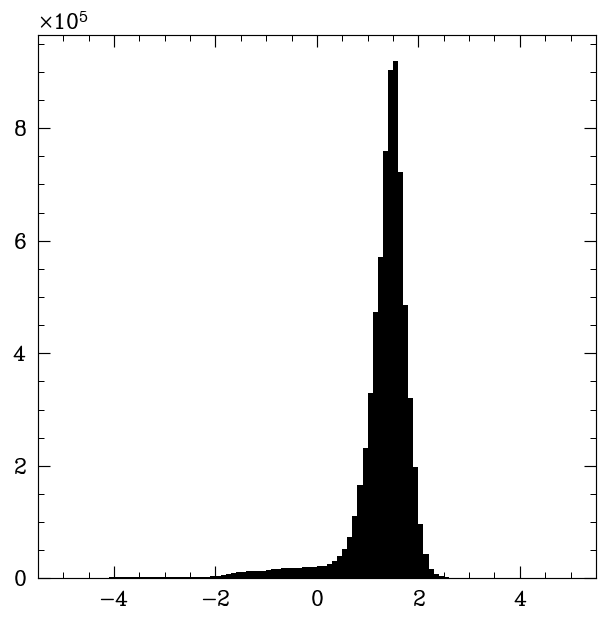

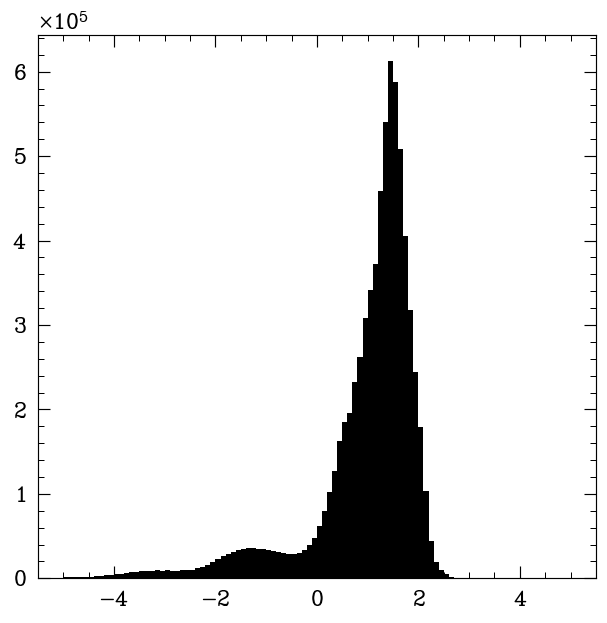

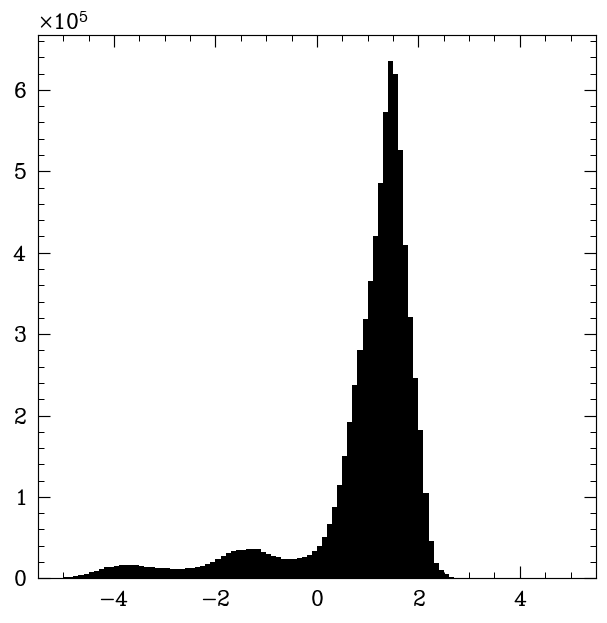

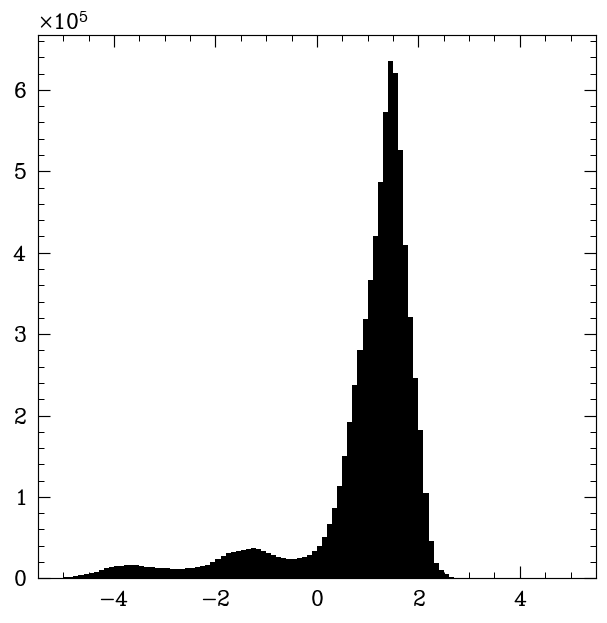

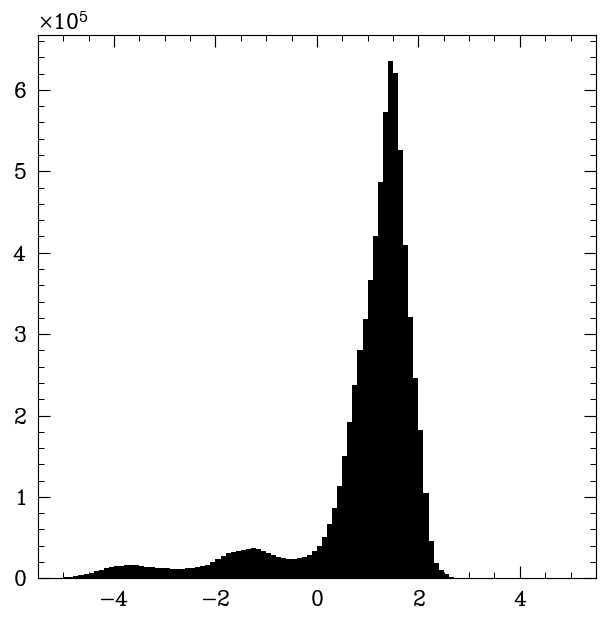

In [118]:
idx = inrange( p[0]['r_scaled'], (.1, 1) )
for Zbins in [1, 10, 100, 1000, 10000]: 
    plt.figure()
    plt.hist(np.log10(p[0][f'tcool_{Zbins}'][idx]), bins=100, range=(-5,5));

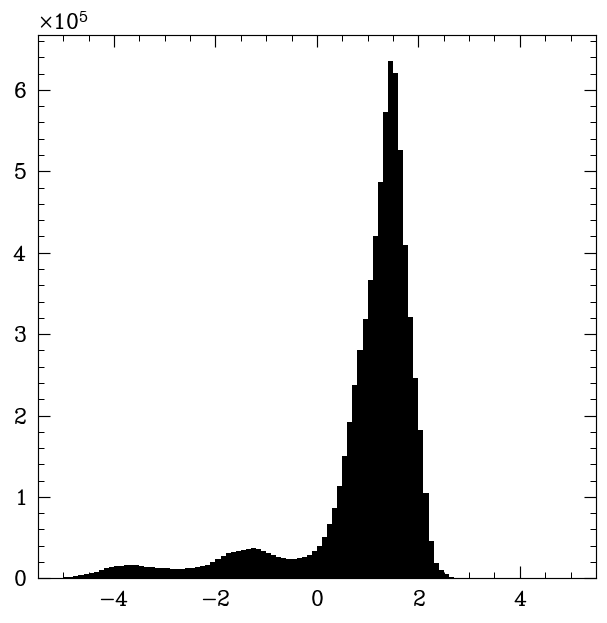

In [119]:
plt.hist(np.log10(p[0]['tcool'][idx]), bins=100, range=(-5,5));

In [62]:
p[0]['tcool_part'] = np.zeros_like(p[0]['nH'])
p[0]['CoolingRate_part'] = np.zeros_like(p[0]['nH'])

def tcool_particle(i):
    Z = p[0]['Metallicity'][i,0] / Zsun
    cooling = Cool.Wiersma_Cooling(Z, p[0]['Redshift'])
    CoolingRate_pred = cooling.LAMBDA(p[0]['Temperature'][i]*un.K, p[0]['nH'][i]*(un.cm**-3)) * (p[0]['nH'][i]*(un.cm**-3))**2
    tcool_pred = ((Pressure(p[0]['InternalEnergy'][i], p[0]['Density'][i], typeP='thermal') * cons.k_B * un.K / un.cm**3) / ( CoolingRate_pred * (5/3-1) ))
    p[0]['tcool_part'][i] = tcool_pred.to(un.Gyr).value
    p[0]['CoolingRate_part'][i] = CoolingRate_pred.to(un.erg/un.s*un.cm**-3).value

In [59]:
tcool_pred_particle = Parallel(n_jobs=-1, verbose=10)(delayed(tcool_particle)(i) for i in np.flatnonzero(idx)[::100])

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 52 concurrent workers.
/home/ias627/tools/cooling_flow/WiersmaCooling.py:41: RuntimeWarning: invalid value encountered in log10
  vals = log(self.LAMBDA(X*un.K,Y*un.cm**-3).value)
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   49.4s
[Parallel(n_jobs=-1)]: Done  24 tasks      | elapsed:   49.6s
[Parallel(n_jobs=-1)]: Done  41 tasks      | elapsed:   49.9s
[Parallel(n_jobs=-1)]: Done  58 tasks      | elapsed:   50.1s
[Parallel(n_jobs=-1)]: Done  77 tasks      | elapsed:   50.4s
/home/ias627/tools/cooling_flow/WiersmaCooling.py:41: RuntimeWarning: invalid value encountered in log10
  vals = log(self.LAMBDA(X*un.K,Y*un.cm**-3).value)
[Parallel(n_jobs=-1)]: Done  96 tasks      | elapsed:   50.7s
[Parallel(n_jobs=-1)]: Done 117 tasks      | elapsed:   50.9s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:   51.0s
[Parallel(n_jobs=-1)]: Done 161 tasks      | elapsed:   51.2s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapse

KeyboardInterrupt: 

In [71]:
idx2 = np.flatnonzero(idx)[::100]
for i in tqdm(idx2):
    tcool_particle(i)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 77255/77255 [07:13<00:00, 178.38it/s]


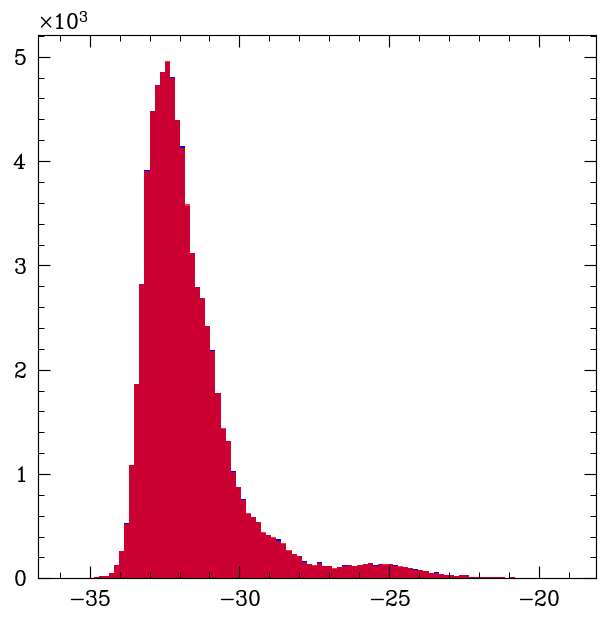

In [93]:
plt.hist(np.log10(p[0]['CoolingRate'][idx2]), bins=100, alpha=1, color='b');
plt.hist(np.log10(p[0]['CoolingRate_part'][idx2]), bins=100, color='r',alpha=.8);

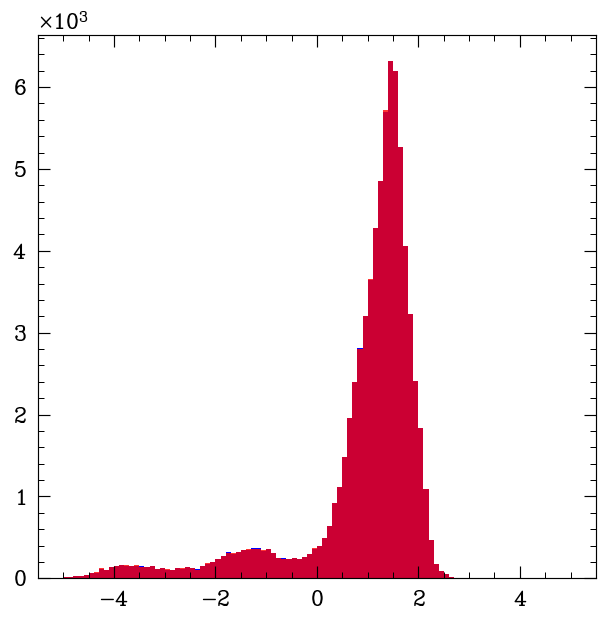

In [82]:
plt.hist(np.log10(p[0]['tcool'][idx2]), bins=100, range=(-5,5), alpha=1, color='b');
plt.hist(np.log10(p[0]['tcool_part'][idx2]), bins=100, range=(-5,5), color='r',alpha=.8);

In [71]:
p0 = p[0]
rbins=np.power(10, np.arange(np.log10(0.005258639741921723), np.log10(3), 0.05))
rmid = (rbins[:-1]+rbins[1:])/2 #in units of Rvir
logprofiles = { k:[] for k in ['tcool', 'tcool_100', 'tcool_1000', 'tcool_10000', 'tcool_Mweighted', 'tcoolshell',
                              'CoolingRate'] }
mask = True#(p0['Temperature'] > 10**5)&(p0['nH'] < 10**(-2))
for r0,r1 in zip(rbins[:-1],rbins[1:]):
    idx = np.flatnonzero(mask&inrange( p0['r_scaled'], (r0, r1) ))
    V = np.sum(p0['Vi'][idx]) #volume of shell in physical kpc^3
    Mshell = np.sum(p0['Masses'][idx]) #mass of shell
    
    # tcool profile (averaging in linear space): log <tcool/Gyr>
    # filter out particles where tcool is infinite, keeping shell volume V the same
    assert not np.any(p0['tcool']==np.inf)

    tcoolavg = np.sum(p0['tcool'][idx] * p0['Vi'][idx]) / V
    logprofiles['tcool'].append(np.log10(tcoolavg))
    
    for Zbins in [100, 1000, 10000]:
        continue
        tcoolavg = np.sum(p0[f'tcool_{Zbins}'][idx] * p0['Vi'][idx]) / V
        logprofiles[f'tcool_{Zbins}'].append(np.log10(tcoolavg))
    
    tcoolavg_Mweighted = np.sum(p0['tcool'][idx] * p0['Masses'][idx]) / Mshell
    logprofiles['tcool_Mweighted'].append(np.log10(tcoolavg))

    tcoolavgshell = (np.sum(p0['InternalEnergy'][idx]*p0['Density'][idx]) / np.sum(p0['CoolingRate'][idx]) * 1e10 * un.Msun/un.kpc**3 * (un.km/un.s)**2 / (un.erg/un.s*un.cm**-3)).to(un.Gyr).value
#     tcoolavgshell = np.sum(p0['InternalEnergy'][idx]*p0['Density'][idx]) / np.sum(p0['CoolingRate'][idx])
#     print(np.sum(p0['InternalEnergy'][idx]*p0['Density'][idx]) , np.sum(p0['CoolingRate'][idx]), np.log10(tcoolavgshell))
    logprofiles['tcoolshell'].append(np.log10(tcoolavgshell))
    
    CoolingRateavg = np.sum(p0['CoolingRate'][idx] * p0['Vi'][idx]) / V
    logprofiles['CoolingRate'].append(np.log10(CoolingRateavg))


logprofiles = {k:np.array(v) for k,v in logprofiles.items()}

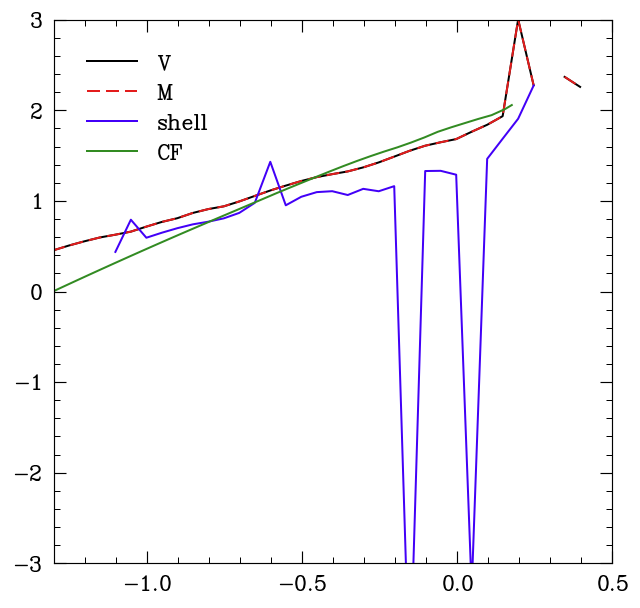

In [72]:
plt.figure(dpi=120)
plt.plot(np.log10(rmid), logprofiles['tcool'], label='V')
plt.plot(np.log10(rmid), logprofiles['tcool_Mweighted'], '--', label='M')
plt.plot(np.log10(rmid), logprofiles['tcoolshell'], label='shell')
plt.xlim(np.log10(0.05), 0.5)
plt.ylim(-3, 3)

# Add cooling flow Rcirc solution curves
res = Sim_m12fNoBH.transonic_solution
res_x = np.log10(res.Rs().to(un.kpc).value / Sim_m12fNoBH.pro['Rvir'])

plt.plot(res_x, np.log10(res.t_cools().to(un.Gyr).value), label='CF')
plt.legend()

(-1.3010299956639813, 0.5)

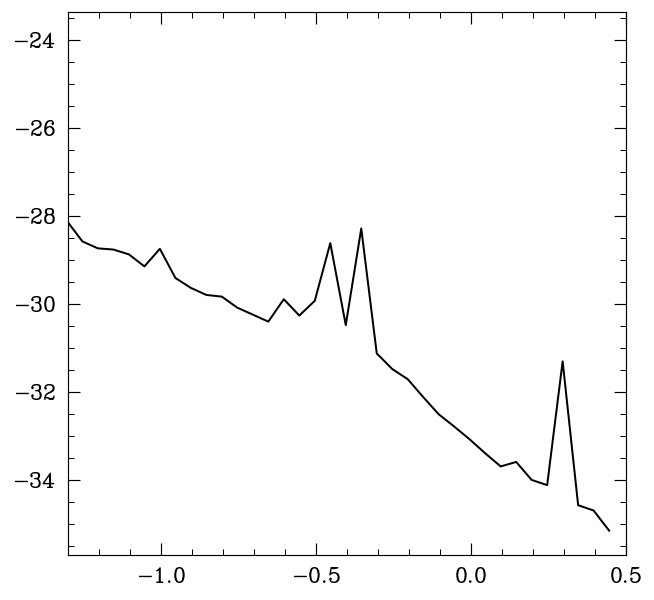

In [49]:
plt.plot(np.log10(rmid), logprofiles['CoolingRate'])
plt.xlim(np.log10(0.05), 0.5)

(-1.3010299956639813, 0.5)

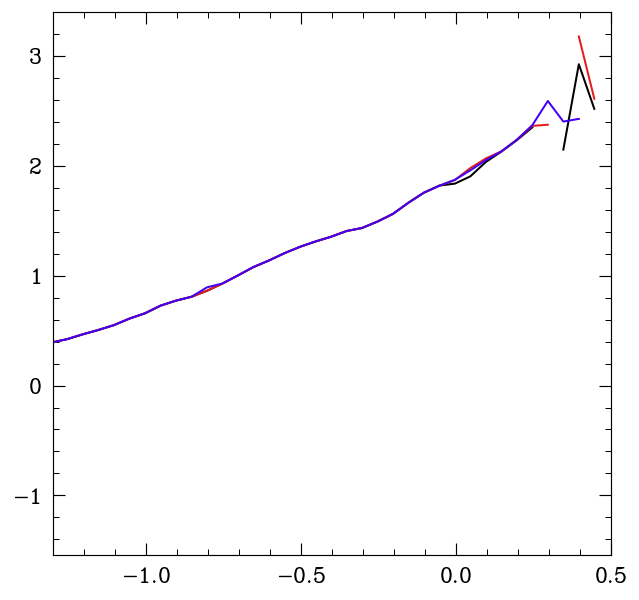

In [155]:
plt.plot(np.log10(rmid), logprofiles['tcool_100'])
plt.plot(np.log10(rmid), logprofiles['tcool_1000'])
plt.plot(np.log10(rmid), logprofiles['tcool_10000'])

plt.xlim(np.log10(0.05), 0.5)

## Mean molecular weight test

In [83]:
m13keys = {'m13h002_NoBH': 51,
'm13h007_NoBH': 60,
'm13h113_NoBH': 60,
'm13h206_NoBH': 60,
'm13h223_NoBH': 55}

In [103]:
means = []
stds = []

meansX = []
stdsX = []

for k, s in m13keys.items():
    p = load_allparticles(sim_path_fire3(PaperSimNames[k], quest=True), s, keys_to_extract={0:['Coordinates', 'Masses', 'Density', 'Temperature', 'InternalEnergy', 'CosmicRayEnergy', 'Metallicity'],1:['Coordinates', 'Masses']}, loud=0)
    mask = p[0]['r_scaled'] < 1.5
    mu_sim = p[0]['Temperature'] / (5/3-1) * 1.38e-16 / (p[0]['InternalEnergy']*1e10) / 1.67e-24
    XH = 1 - p[0]['Metallicity'][:,0] - p[0]['Metallicity'][:,1] #hydrogen mass fraction
    means.append(np.mean(mu_sim[mask]))
    stds.append(np.std(mu_sim[mask]))
    
    meansX.append(np.mean(XH[mask]))
    stdsX.append(np.std(XH[mask]))

Text(0, 0.5, '$\\mu$ ($r < 1.5 R_{\\mathrm{vir}}$)')

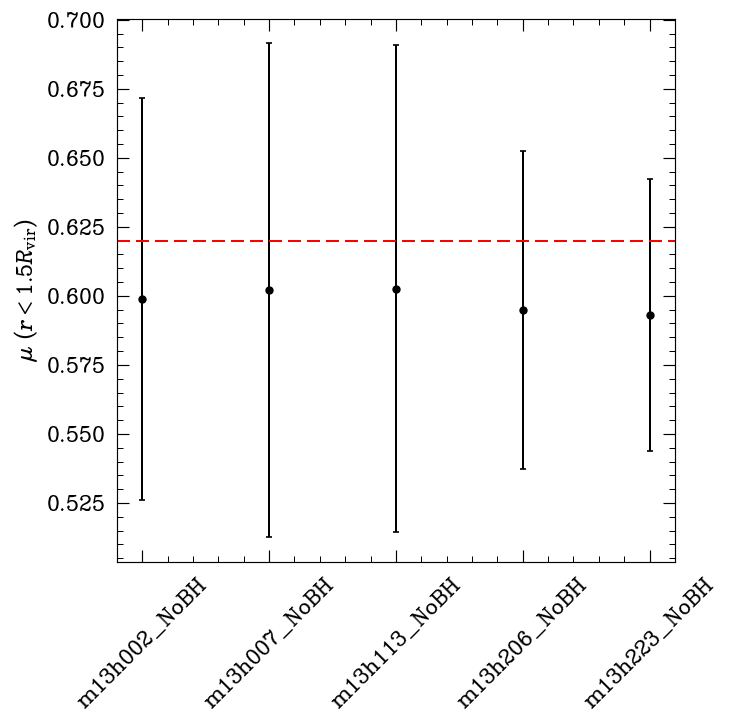

In [105]:
plt.errorbar(m13keys.keys(), means, yerr=stds, fmt='.')
plt.axhline(0.62, ls='--', c='r', label='CF constant')
plt.xticks(rotation=45)
plt.ylabel('$\mu$ ($r < 1.5 R_{\mathrm{vir}}$)')

Text(0, 0.5, '$X$ ($r < 1.5 R_{\\mathrm{vir}}$)')

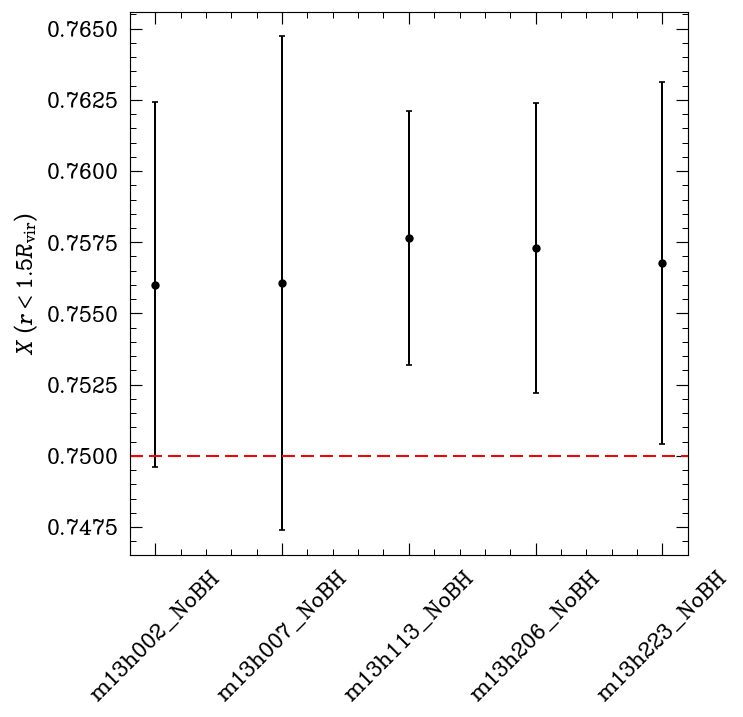

In [104]:
plt.errorbar(m13keys.keys(), meansX, yerr=stdsX, fmt='.')
plt.axhline(0.75, ls='--', c='r', label='CF constant')
plt.xticks(rotation=45)
plt.ylabel('$X$ ($r < 1.5 R_{\mathrm{vir}}$)')

Text(0, 0.5, 'number of particles ($r < 1.5 R_{\\mathrm{vir}}$)')

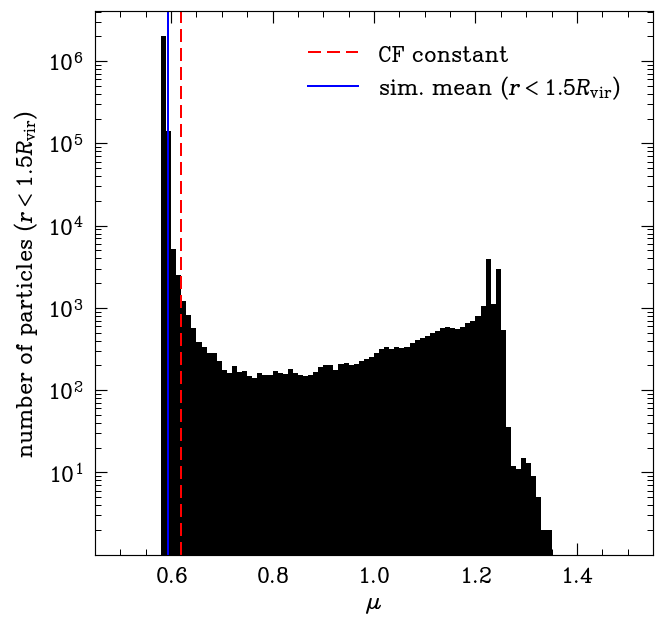

In [69]:
mask = p[0]['r_scaled'] < 1.5
mu_sim = p[0]['Temperature'] / (5/3-1) * 1.38e-16 / (p[0]['InternalEnergy']*1e10) / 1.67e-24
plt.hist(mu_sim[mask], range=(0.5,1.5), bins=100);
plt.yscale('log')
plt.axvline(0.62, ls='--', c='r', label='CF constant')


plt.axvline(np.mean(mu_sim[mask]), c='b', label='sim. mean ($r < 1.5 R_{\mathrm{vir}}$)')
plt.legend()
plt.xlabel('$\mu$')
plt.ylabel('number of particles ($r < 1.5 R_{\mathrm{vir}}$)')

Text(0, 0.5, 'number of particles ($r < 1.5 R_{\\mathrm{vir}}$)')

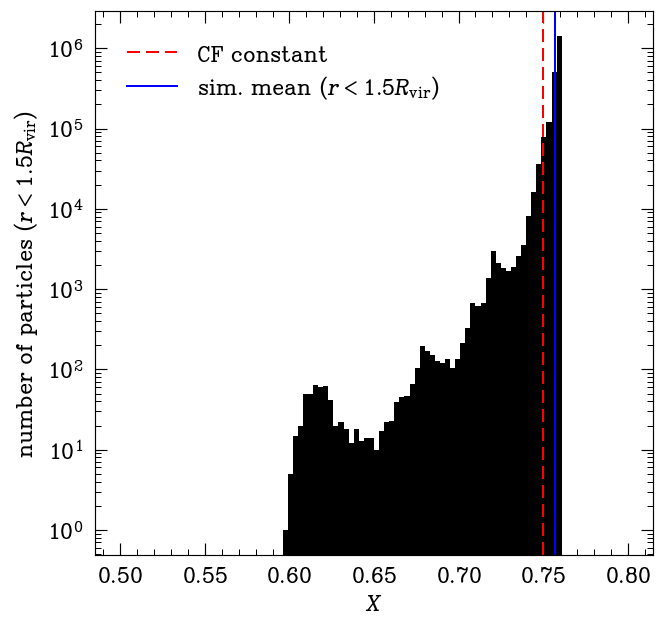

In [70]:
XH = 1 - p[0]['Metallicity'][:,0] - p[0]['Metallicity'][:,1] #hydrogen mass fraction
plt.hist(XH[mask], range=(0.5,0.8), bins=100);
plt.yscale('log')
plt.axvline(0.75, ls='--', c='r', label='CF constant')


plt.axvline(np.mean(XH[mask]), c='b', label='sim. mean ($r < 1.5 R_{\mathrm{vir}}$)')
plt.legend()
plt.xlabel('$X$')
plt.ylabel('number of particles ($r < 1.5 R_{\mathrm{vir}}$)')

## m12i FIRE-2 test

In [3]:
m12i_fire2 = Simulation(simdir='/projects/b1026/isultan/fire2_core_no_md/m12i_r57000', snapnum=600, cachesim=True)

In [2]:
m12i_fire2 = Simulation(simdir='/projects/b1026/isultan/fire2_core_no_md/m12i_r57000', snapnum=600)

In [3]:
m12i_fire2.alpha_avg

0.14354148528923077

In [7]:
Sim = m12i_fire2
Rlow, Rhigh = 0.10468750000000002, 0.10468750000000002
Sim.transonic_solution, Sim.R_sonic_mid = Sim.binary_search_R_sonic(Rlow*un.kpc, Rhigh*un.kpc, alpha=m12i_fire2.alpha_avg)

5.506562307015115 solMass / yr
0.10468750000000002 kpc
5.441358177794046 solMass / yr


In [9]:
nH = np.genfromtxt('../wpd_datasets.csv', delimiter=',', skip_header=2, usecols=(0,1))
T = np.genfromtxt('../wpd_datasets.csv', delimiter=',', skip_header=2, usecols=(2,3))
P = np.genfromtxt('../wpd_datasets.csv', delimiter=',', skip_header=2, usecols=(4,5))
K = np.genfromtxt('../wpd_datasets.csv', delimiter=',', skip_header=2, usecols=(6,7))

Pturb = np.genfromtxt('../fig9.csv', delimiter=',')

In [15]:
nHCF = np.genfromtxt('../wpd_datasets_CF.csv', delimiter=',', skip_header=2, usecols=(0,1))
TCF = np.genfromtxt('../wpd_datasets_CF.csv', delimiter=',', skip_header=2, usecols=(2,3))
PCF = np.genfromtxt('../wpd_datasets_CF.csv', delimiter=',', skip_header=2, usecols=(4,5))
KCF = np.genfromtxt('../wpd_datasets_CF.csv', delimiter=',', skip_header=2, usecols=(6,7))

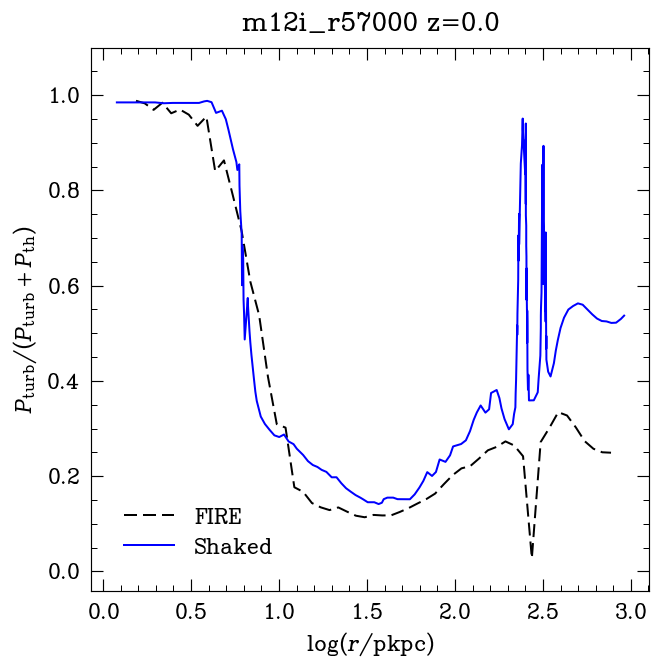

In [5]:
pro = m12i_fire2.pro
rmid = pro['rmid']*pro['Rvir']

Pturbratio = 10**pro['P_turb'] / (10**pro['P_turb'] + 10**pro['Pth_Mweighted'])
plt.plot(np.log10(rmid), Pturbratio, 'k--', label='FIRE')
plt.plot(Pturb[:,0], Pturb[:,1], 'b-', label='Shaked')

plt.xlabel('$\log (r/\mathrm{pkpc})$')
plt.ylabel('$P_{\mathrm{turb}} / (P_{\mathrm{turb}}+P_{\mathrm{th}})$')

plt.title(m12i_fire2.simname + ' ' + f'z={m12i_fire2.Redshift}')
plt.ylim((-0.04175976784173662, 1.1))
plt.legend()

In [33]:
(((un.cm**2 * un.keV)/(cons.k_B * un.K / un.cm**3 * (un.pc**3/un.Msun)**(5/3))).si)**(3/5)

<Quantity 1.17281778e-21 kg>

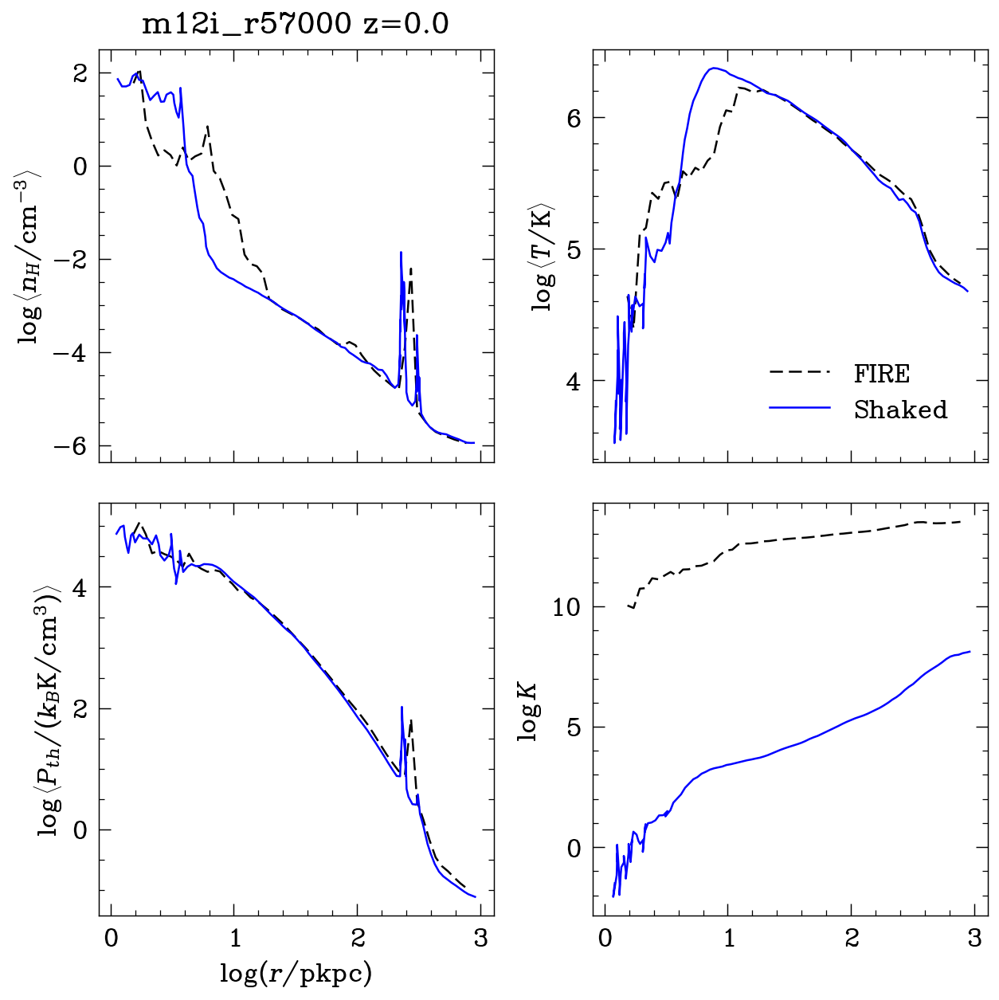

In [18]:
fig, axes = plt.subplots(2, 2, sharex=True, sharey=False, gridspec_kw={'wspace': .25, 'hspace':.1}, figsize=[4.8*2,4.8*2], dpi=150, facecolor='w')

axes[0,0].plot(np.log10(rmid), pro['nH_Mweighted'], 'k--', label='FIRE')
axes[0,0].plot(nH[:,0], nH[:,1], 'b-', label='Shaked')
axes[0,0].set_ylabel(profilelabels['nH lin'])

axes[0,1].plot(np.log10(rmid), pro['T_Mweighted'], 'k--', label='FIRE')
axes[0,1].plot(T[:,0], T[:,1], 'b-', label='Shaked')
axes[0,1].set_ylabel(profilelabels['T lin'])

axes[1,0].plot(np.log10(rmid), pro['Pth_Mweighted'], 'k--', label='FIRE')
axes[1,0].plot(P[:,0], P[:,1], 'b-', label='Shaked')
axes[1,0].set_ylabel(profilelabels['P_th lin'])

axes[1,1].plot(np.log10(rmid), pro['K_Mweighted'], 'k--', label='FIRE')
axes[1,1].plot(K[:,0], K[:,1], 'b-', label='Shaked')
axes[1,1].set_ylabel('$\log K$')

axes[1,0].set_xlabel('$\log (r/\mathrm{pkpc})$')

axes[0,0].set_title(m12i_fire2.simname + ' ' + f'z={m12i_fire2.Redshift}')
axes[0,1].legend()

In [11]:
fig, axes = makecoolingflow([res['m12i_NoBH_fire2'][-1],res['m12i_NoBH_fire2'][-1]])
axes[0,0].plot(nHCF[:,0][np.argsort(nHCF[:,0])], nHCF[:,1][np.argsort(nHCF[:,0])], 'b-', label='Shaked CF')
axes[1,0].plot(TCF[:,0][np.argsort(TCF[:,0])], TCF[:,1][np.argsort(TCF[:,0])], 'b-', label='Shaked CF')
axes[0,0].legend()

NameError: name 'res' is not defined

2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773
2.519637356136773


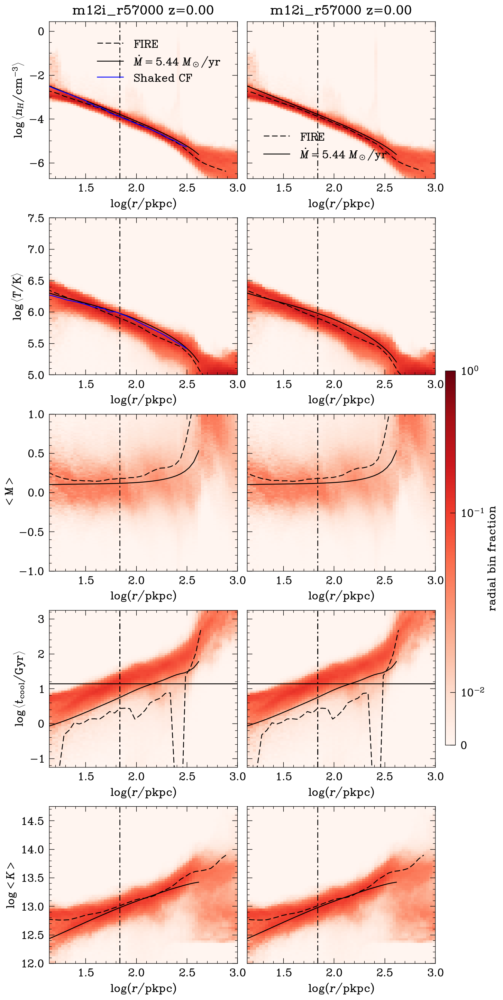

In [18]:
fig, axes = makecoolingflow([Sim,Sim])
axes[0,0].plot(nHCF[:,0][np.argsort(nHCF[:,0])], nHCF[:,1][np.argsort(nHCF[:,0])], 'b-', label='Shaked CF')
axes[1,0].plot(TCF[:,0][np.argsort(TCF[:,0])], TCF[:,1][np.argsort(TCF[:,0])], 'b-', label='Shaked CF')
axes[0,0].legend()

## CF fitting with turbulence

m13h002_NoBH 0.09899055483093297
m13h007_NoBH 0.24666601259506496
m13h113_NoBH 0.06311094873728748
m13h206_NoBH 0.05494232637811671
m13h223_NoBH 0.08883386702746959
m12a_NoBH 0.29018540447090707
m12d_NoBH 0.8812497122871231
m12g_NoBH 0.14391533009762908
m12j_NoBH 0.5925660348819898
m12k_NoBH 0.14170849332726443
m12n_NoBH 0.20929482960398263
m12x_NoBH 0.21009319592022532
m12f_NoBH 0.41863158049815097
m12q_NoBH 0.31838378251868
m12r_NoBH 1.8384553144996967
m12w_NoBH 0.10010001898027464
m12z_NoBH 0.2925866244128674


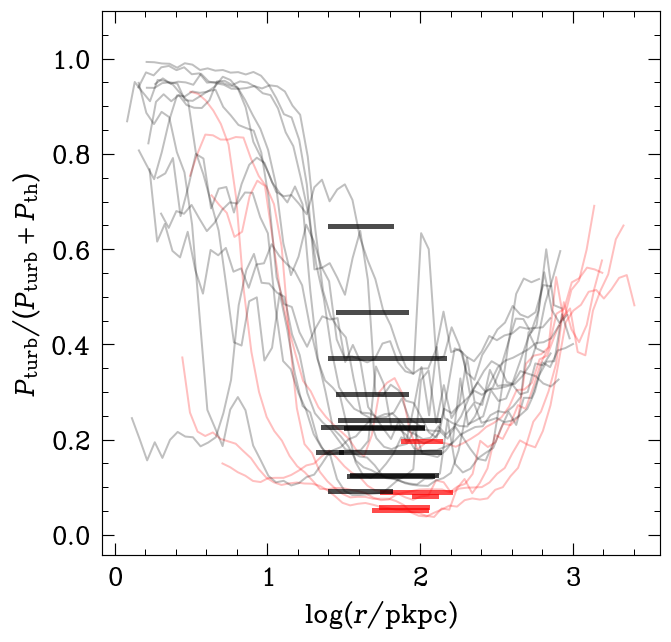

In [82]:
for k,Sim in res_cf.items(): 
    if k not in simnames: continue
    c = 'r' if 'm13' in k else 'k'
    print( k,Sim.alpha_avg )
    
    pro = Sim.pro
    rmid = pro['rmid']*pro['Rvir']
#     plt.figure()
    Pturbratio = 10**pro['P_turb'] / (10**pro['P_turb'] + 10**pro['P_th'])
    plt.plot(np.log10(rmid), Pturbratio, 'k-', c=c, label='FIRE', alpha=.25, zorder=0)
    
    Rmin, Rmax = np.log10(0.1 * Sim.pro['Rvir']), np.log10(Sim.Rcool)
#     plt.axhline((1+Sim.alpha_avg**-1)**-1, xmin=Rmin, xmax=Rmax)
    plt.plot((Rmin, Rmax), ((1+Sim.alpha_avg**-1)**-1, (1+Sim.alpha_avg**-1)**-1), 'k-',c=c, linewidth=3, alpha=.7, zorder=10)
#     plt.axvline(Rmin)
#     plt.axvline(Rmax)

    plt.xlabel('$\log (r/\mathrm{pkpc})$')
    plt.ylabel('$P_{\mathrm{turb}} / (P_{\mathrm{turb}}+P_{\mathrm{th}})$')

#     plt.title(k + ' ' + f'z={np.abs(Sim.Redshift):.02f} {Sim.alpha_avg:.03f}')
    plt.ylim((-0.04175976784173662, 1.1))
#     plt.legend()
plt.savefig('../Paper2Figs/Pturbratio.pdf')

m13h002_NoBH 0.09899055483093297
m13h007_NoBH 0.24666601259506496
m13h029_NoBH 0.022105383953797672
m13h113_NoBH 0.06311094873728748
m13h206_NoBH 0.05494232637811671
m13h223_NoBH 0.08883386702746959
m13h236_NoBH 0.10937477563193561
m12a_NoBH 0.29018540447090707
m12d_NoBH 0.8812497122871231
m12e_NoBH nan
m12g_NoBH 0.14391533009762908
m12j_NoBH 0.5925660348819898
m12k_NoBH 0.14170849332726443
m12n_NoBH 0.20929482960398263
m12u_NoBH nan
m12x_NoBH 0.21009319592022532
m12b_NoBH 0.12962069439673368
m12c_NoBH 0.24481934868760408
m12f_NoBH 0.41863158049815097
m12i_NoBH 0.13560892099374616
m12m_NoBH 0.216919894955579
m12q_NoBH 0.31838378251868
m12r_NoBH 1.8384553144996967
m12w_NoBH 0.10010001898027464
m12z_NoBH 0.2925866244128674


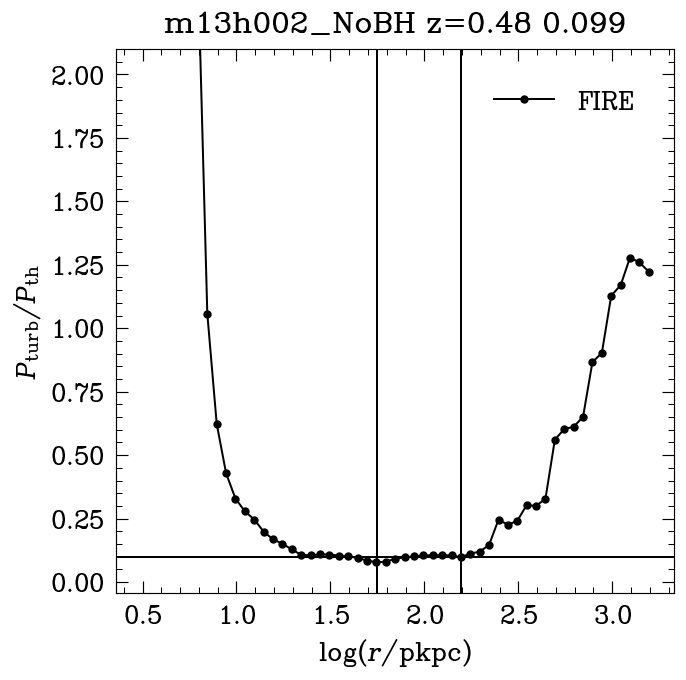

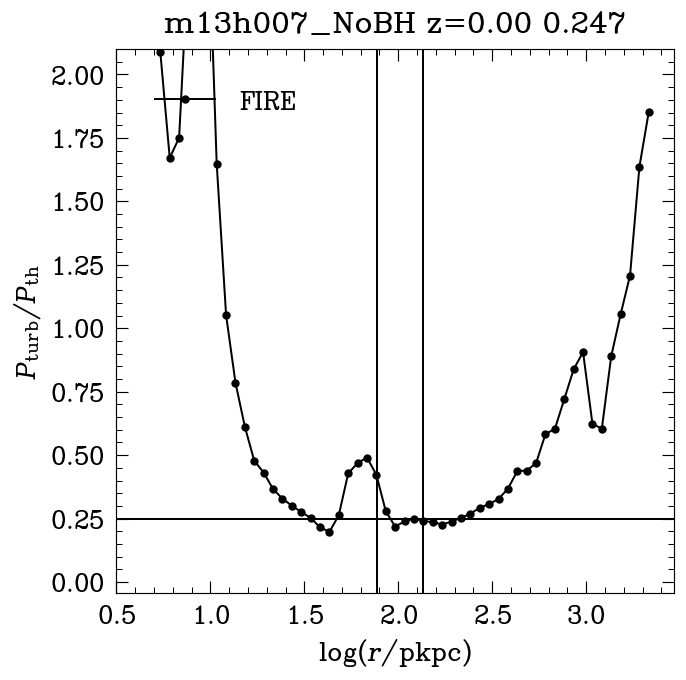

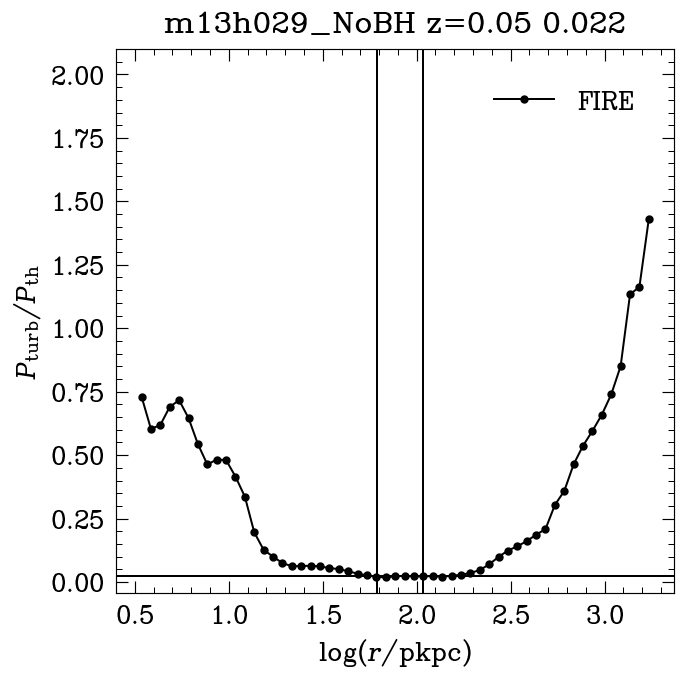

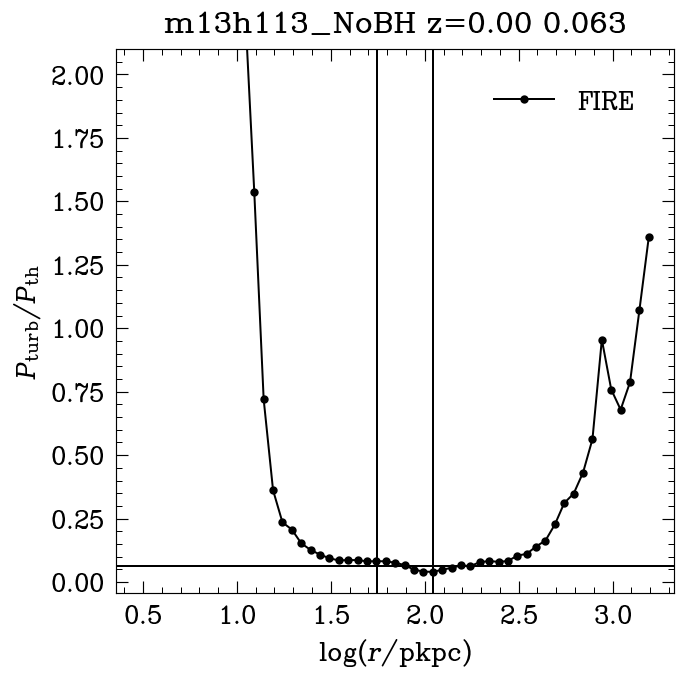

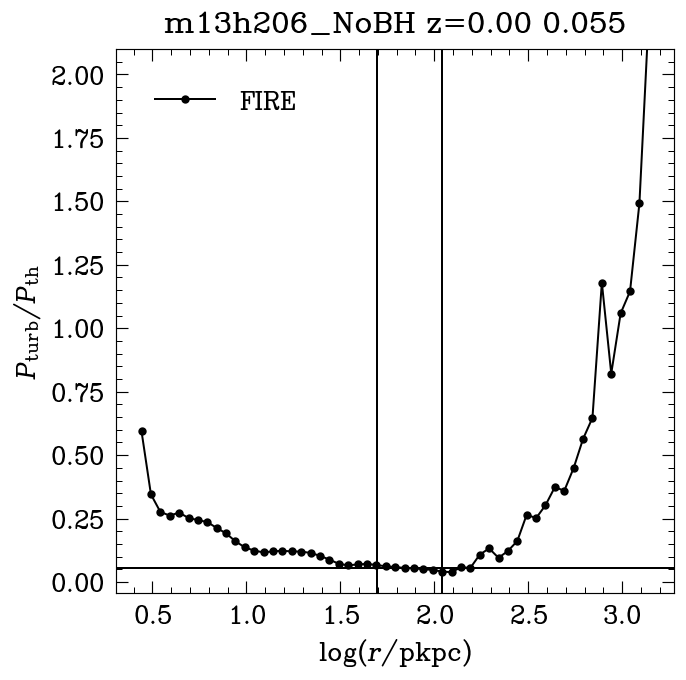

...

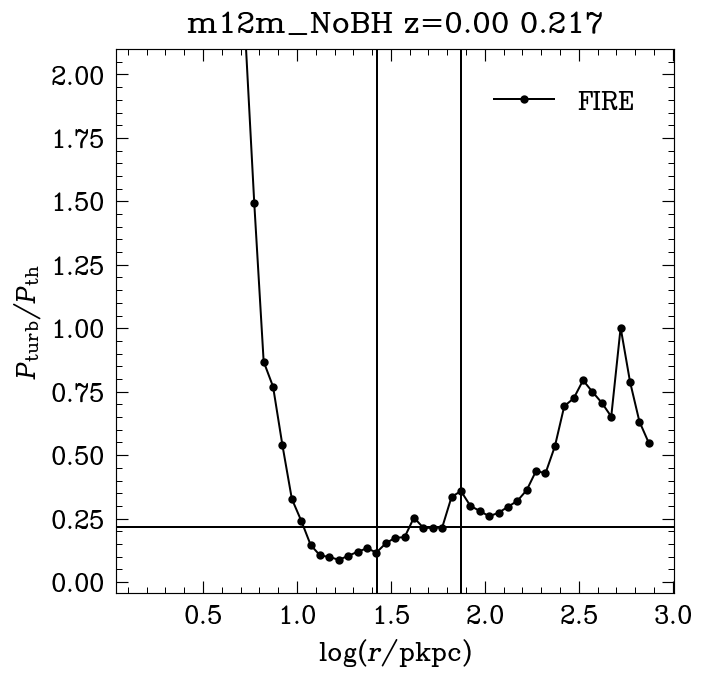

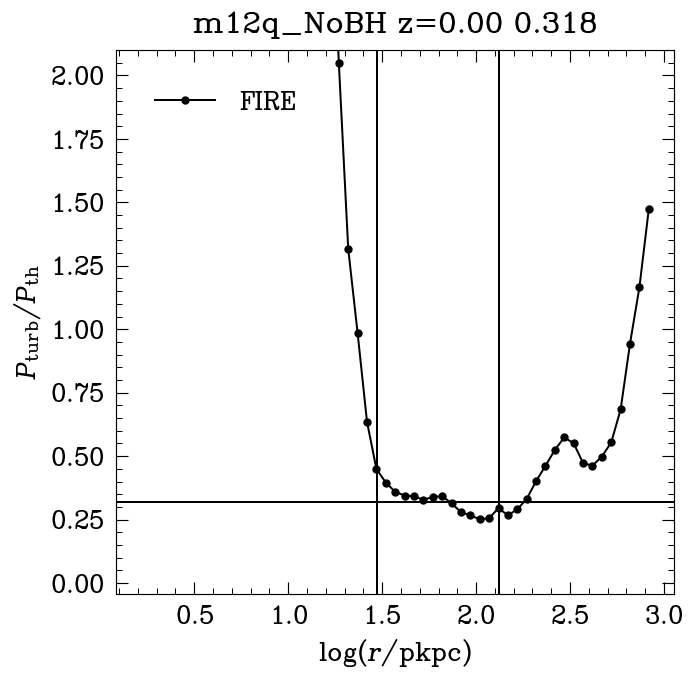

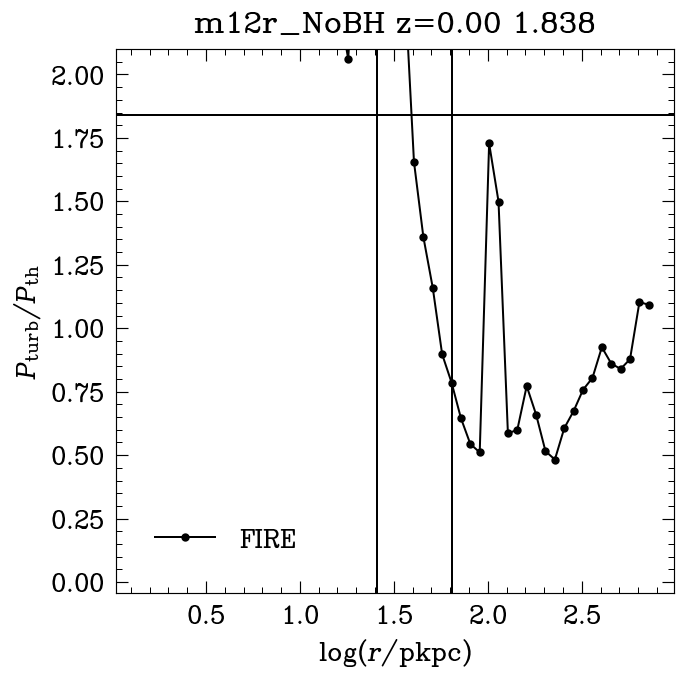

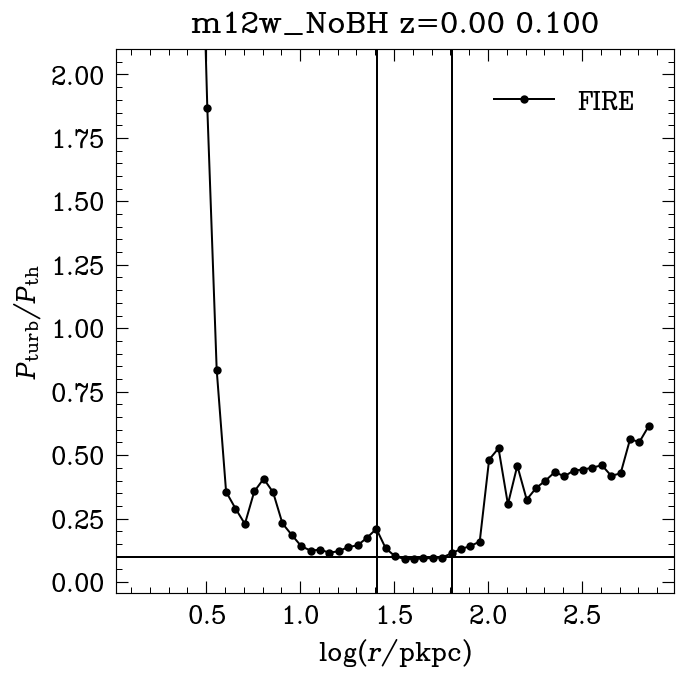

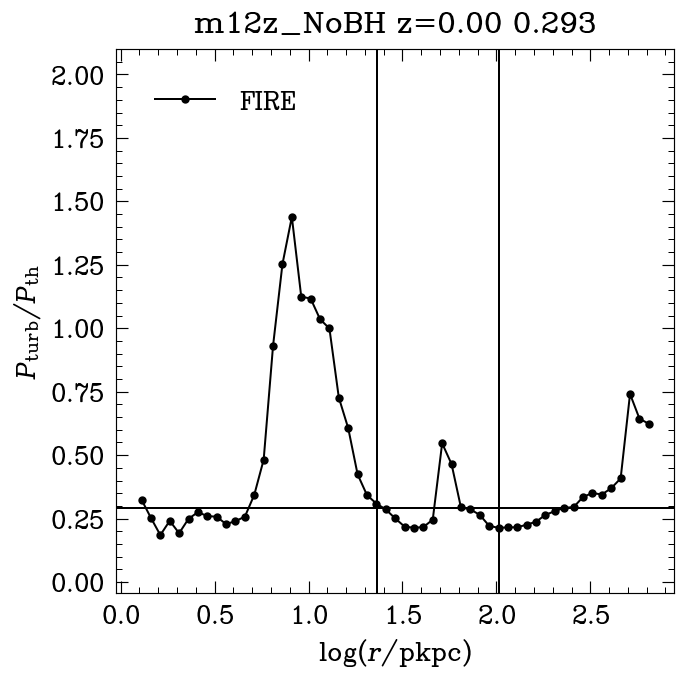

In [77]:
for k,Sim in res_cf.items(): 
    print( k,Sim.alpha_avg )
    
    pro = Sim.pro
    rmid = pro['rmid']*pro['Rvir']
    plt.figure()
    Pturbratio = 10**pro['P_turb'] / 10**pro['P_th']
    plt.plot(np.log10(rmid), Pturbratio, 'k.-', label='FIRE')
    
    plt.axhline(Sim.alpha_avg)
    plt.axvline(np.log10(0.1 * Sim.pro['Rvir']))
    plt.axvline(np.log10(Sim.Rcool))

    plt.xlabel('$\log (r/\mathrm{pkpc})$')
    plt.ylabel('$P_{\mathrm{turb}} / P_{\mathrm{th}}$')

    plt.title(k + ' ' + f'z={np.abs(Sim.Redshift):.02f} {Sim.alpha_avg:.03f}')
    plt.ylim((-0.04175976784173662, 2.1))
    plt.legend()

In [ ]:
#log space
bins = np.logspace(-2,1,100)
simnames = sorted(['m13h007_NoBH', 'm13h002_NoBH', 'm13h223_NoBH', 'm13h113_NoBH', 'm13h206_NoBH'] + [f'm12{s}_NoBH' for s in 'fqrwzadkgjnx'])

for simname in simnames:
    Sim = res_cf[simname]
    print(simname, Sim.alpha_avg)
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)


    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc, alpha=Sim.alpha_avg)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict[simname] = reslist

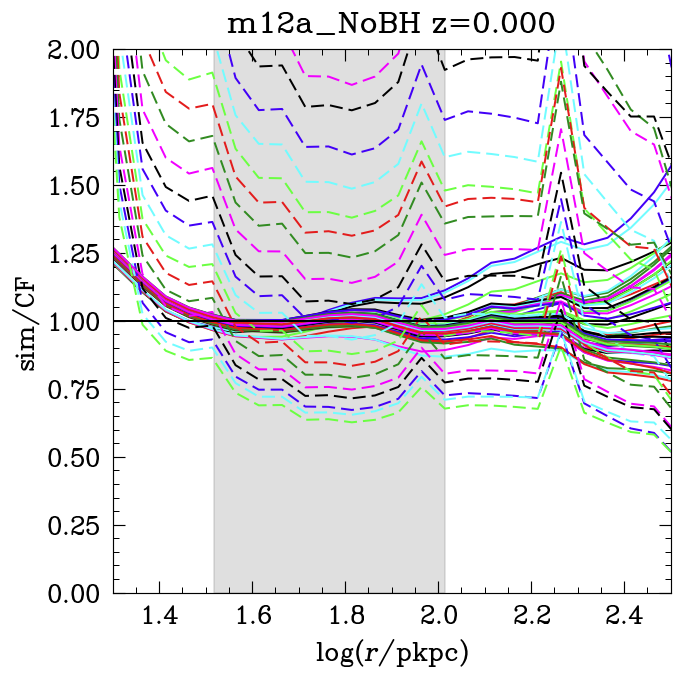

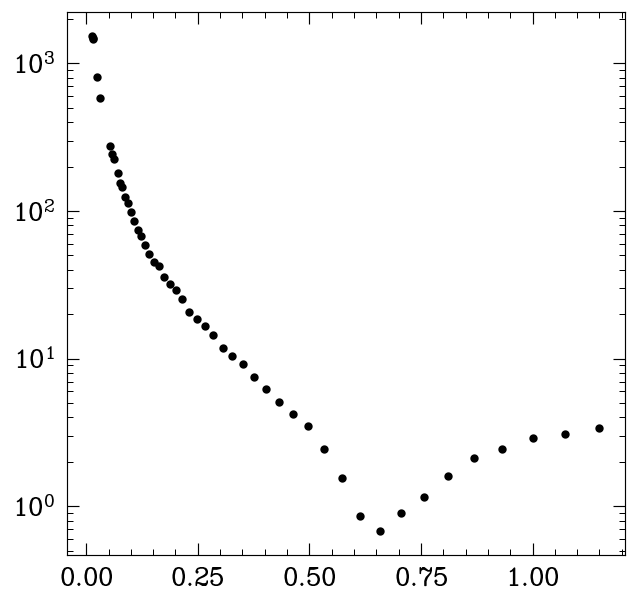

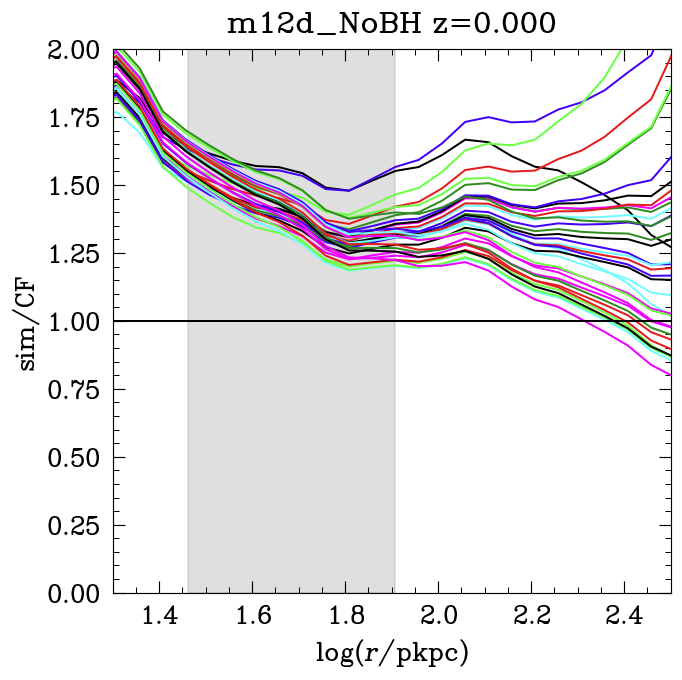

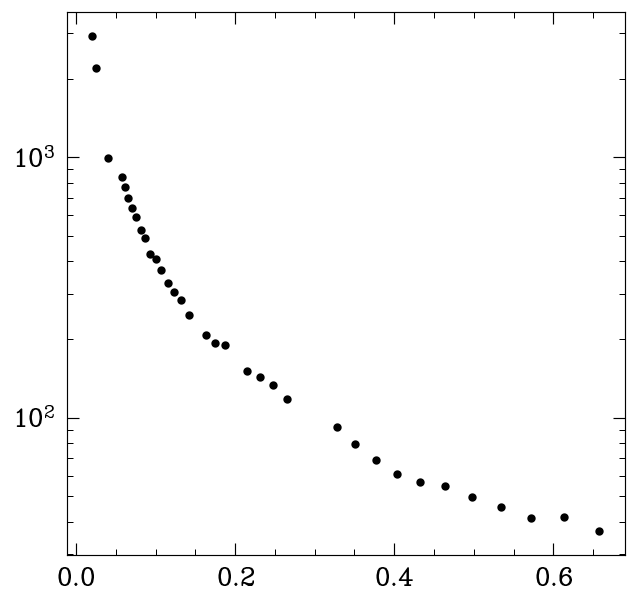

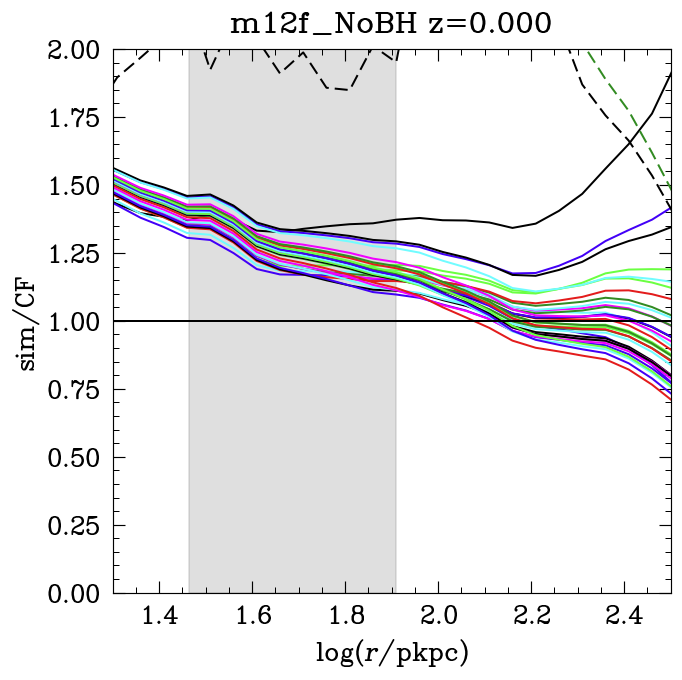

...

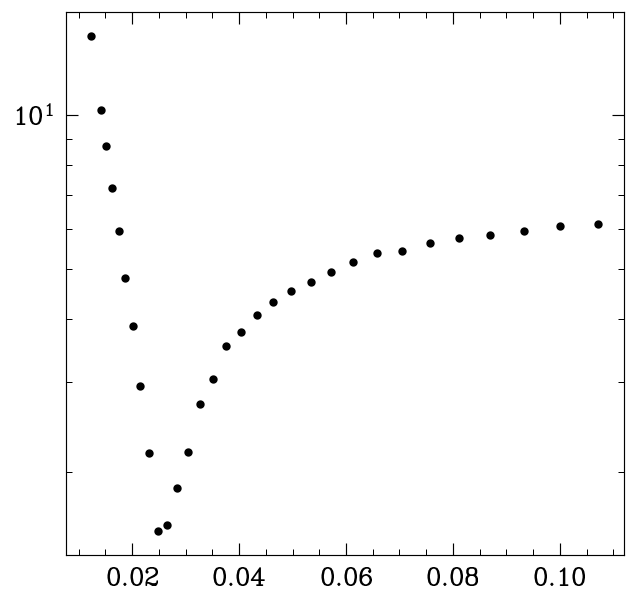

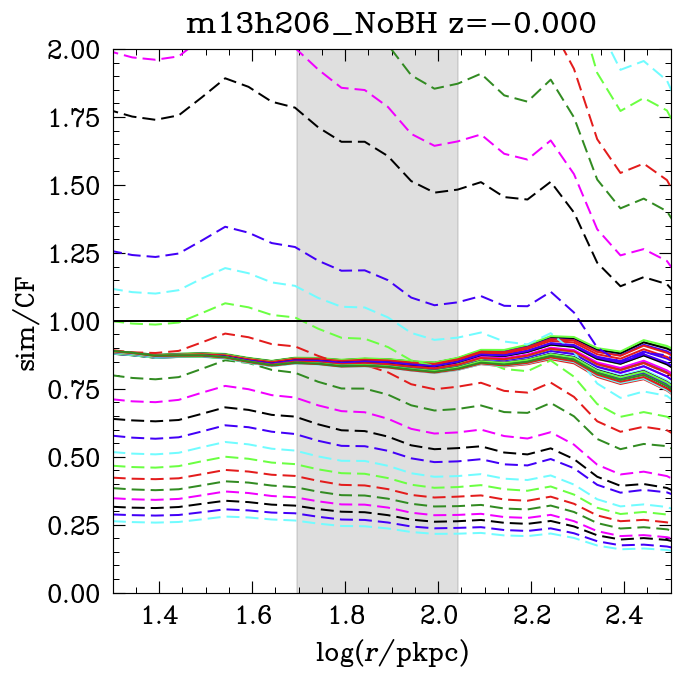

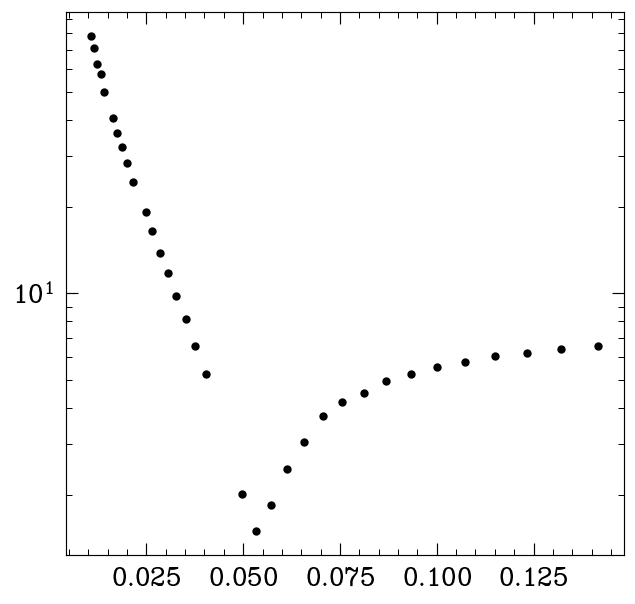

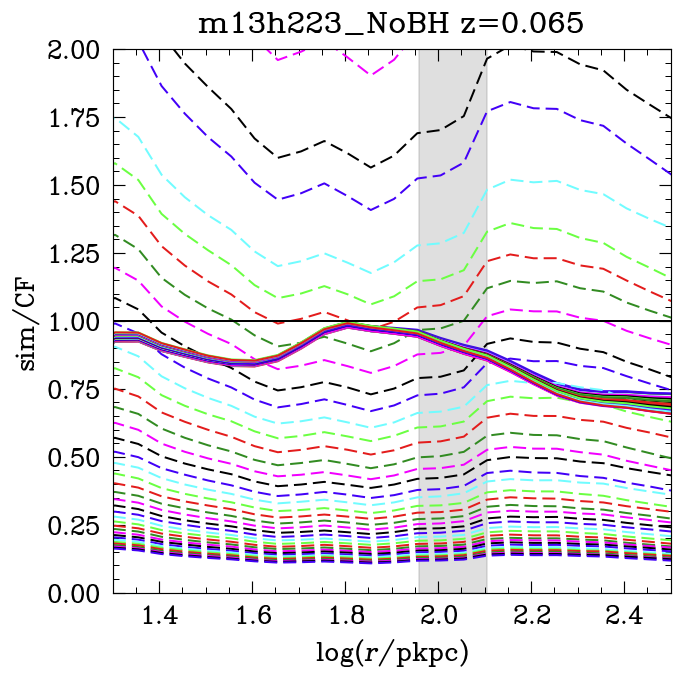

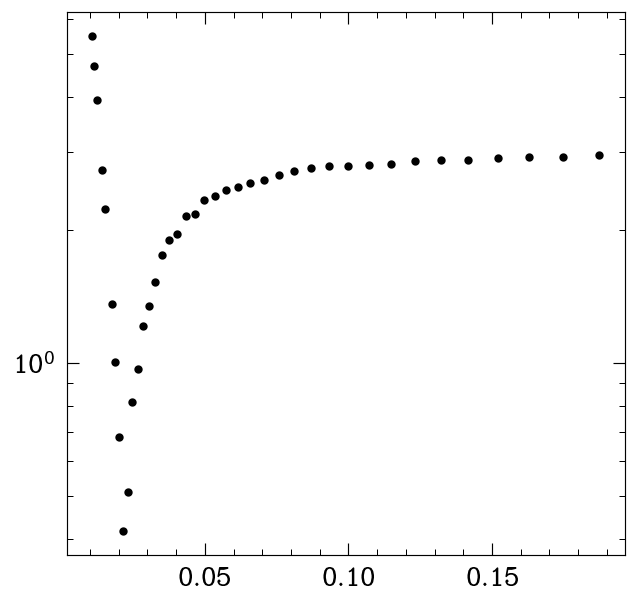

no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_

In [14]:
CF_fitting(resdict, res_cf)

In [10]:
bins = np.linspace(0.011,0.2,100)

for simname in ['m13h007_NoBH', 'm13h002_NoBH', 'm13h223_NoBH', 'm13h113_NoBH', 'm13h206_NoBH']:
# for s in 'fqrwzadkgjnx':
#     simname = f'm12{s}_NoBH'
    Sim = res_cf[simname]
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)


    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc, alpha=Sim.alpha_avg)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict[simname] = reslist

In [11]:
bins = np.linspace(.1,1,100)

for s in 'fqrwzadkgjnx':
    simname = f'm12{s}_NoBH'
    Sim = res_cf[simname]
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)


    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc, alpha=Sim.alpha_avg)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict[simname] = reslist

In [12]:
s='z'
bins = np.linspace(.5,1.5,100)

simname = f'm12{s}_NoBH'
Sim = res_cf[simname]
cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift, LambdaFactor=1)


def solution(R_sonic, R_min=1, R_max=1.5):
    with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
        try:
            return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc, alpha=Sim.alpha_avg)
        except:
            return -1

reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
resdict[simname] = reslist

m13h002_NoBH 73.3130319569708 solMass / yr 115.39914814947213 solMass / yr
m13h007_NoBH 75.89486714562447 solMass / yr 627.847309343061 solMass / yr
m13h113_NoBH 23.524964694216695 solMass / yr 44.583303519703676 solMass / yr
m13h206_NoBH 14.925412842100133 solMass / yr 17.679063623291842 solMass / yr
m13h223_NoBH 54.29254240090728 solMass / yr 216.15391795354117 solMass / yr
m12a_NoBH 8.909324851980331 solMass / yr 9.737026493864018 solMass / yr
m12d_NoBH 0.6447643473802606 solMass / yr 10.165591580928277 solMass / yr
m12g_NoBH 9.300824879312014 solMass / yr 12.903618141877226 solMass / yr
m12j_NoBH 0.4416858661355851 solMass / yr 4.874841106103997 solMass / yr
m12k_NoBH 10.39551278712148 solMass / yr 14.560494454234206 solMass / yr
m12n_NoBH 5.286143650756095 solMass / yr 5.769726784594694 solMass / yr
m12x_NoBH 0.10248300277289922 solMass / yr 0.09809815201343872 solMass / yr
m12f_NoBH 0.8318935249009726 solMass / yr 3.728708428482426 solMass / yr
m12q_NoBH 4.971247347789082 solMass

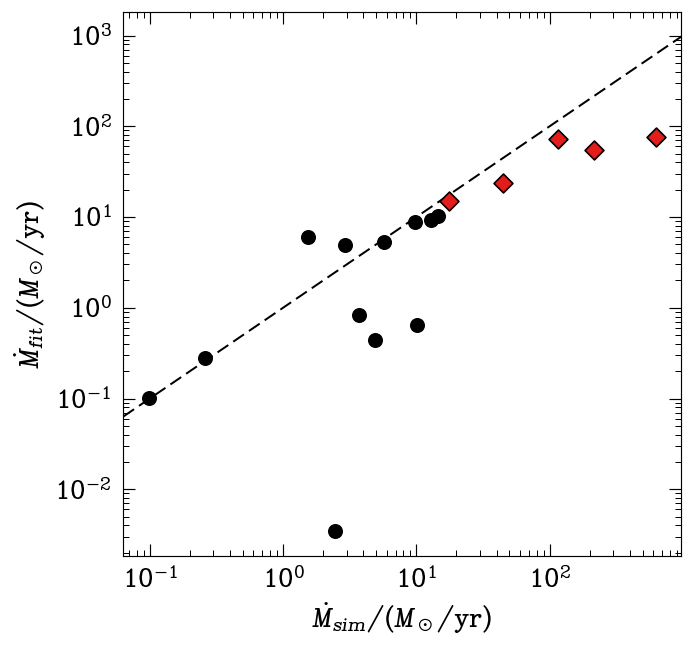

In [83]:
Mdotsp = []
for k,Sim in res_cf.items():
    if hasattr(Sim, 'transonic_solution'):
        print(k,Sim.transonic_solution.Mdot, Sim.Mdot_avg)
        Mdotsp.append((k,Sim.transonic_solution.Mdot.value, Sim.Mdot_avg.value))
plt.scatter([r[2] for r in Mdotsp if 'm12' in r[0]], [r[1] for r in Mdotsp if 'm12' in r[0]], marker='o', alpha=1, zorder=2)
plt.scatter([r[2] for r in Mdotsp if 'm13' in r[0]], [r[1] for r in Mdotsp if 'm13' in r[0]], marker='D', alpha=1, zorder=2)

plt.xscale('log')
plt.yscale('log')
xlim = plt.xlim()
plt.plot(xlim, xlim, '--', zorder=1)
plt.xlim(xlim)
# plt.ylim(xlim)

plt.xlabel('$\dot{{M}}_{sim}/(M_\odot/\mathrm{{yr}})$')
plt.ylabel('$\dot{{M}}_{fit}/(M_\odot/\mathrm{{yr}})$')
plt.savefig('../Paper2Figs/Mdot_turb_fitTnH.pdf') #Mdot scatter for CF with turbulence

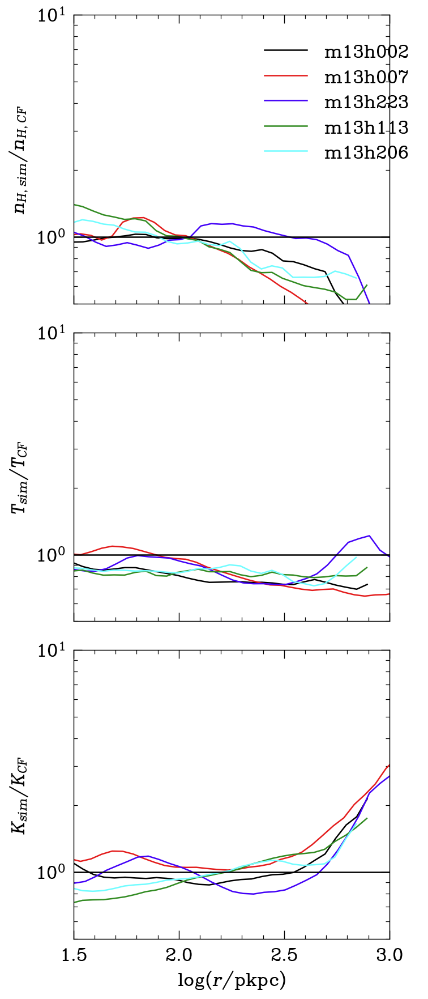

In [107]:
makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])

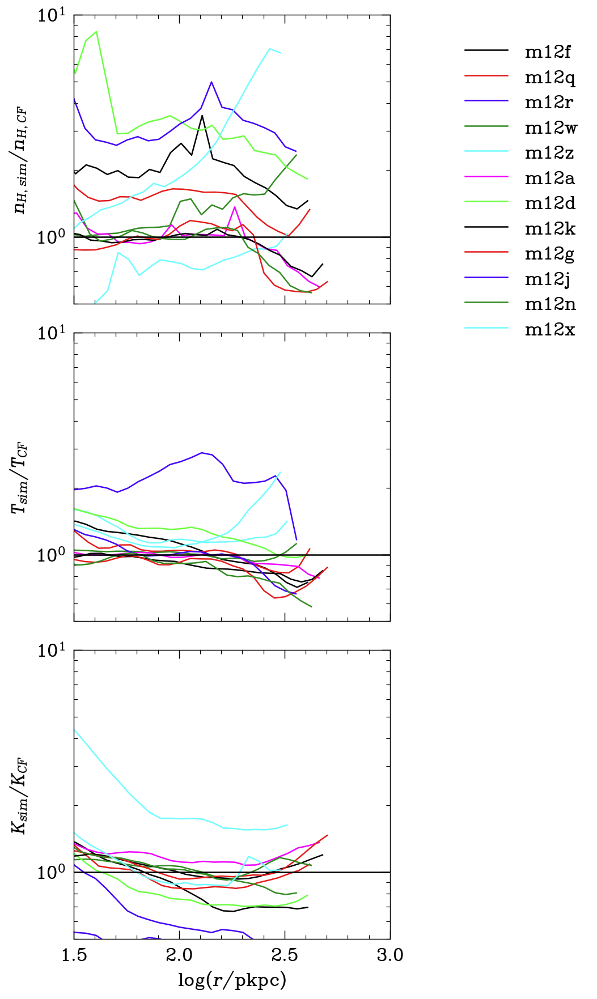

In [108]:
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])

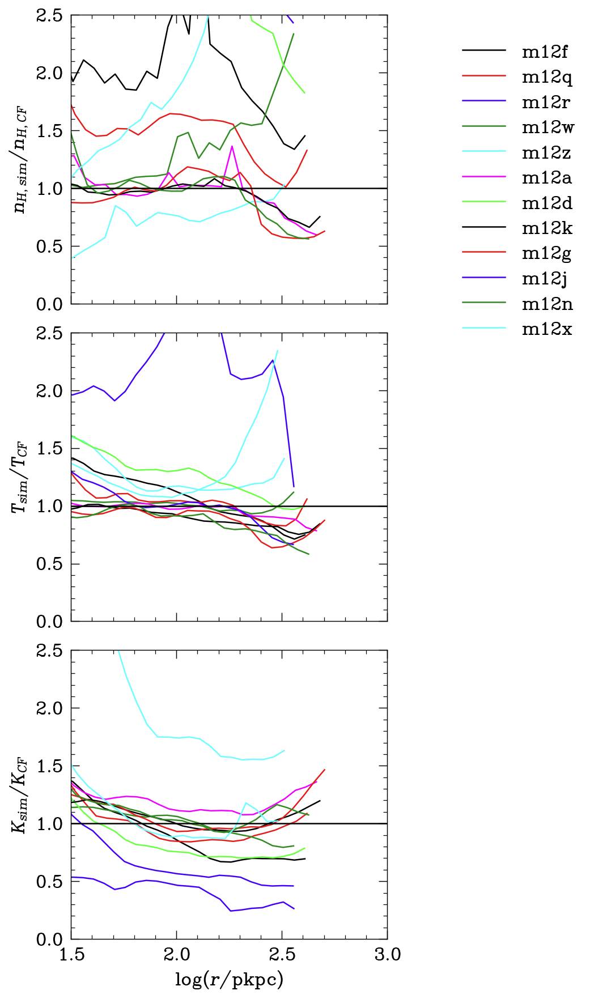

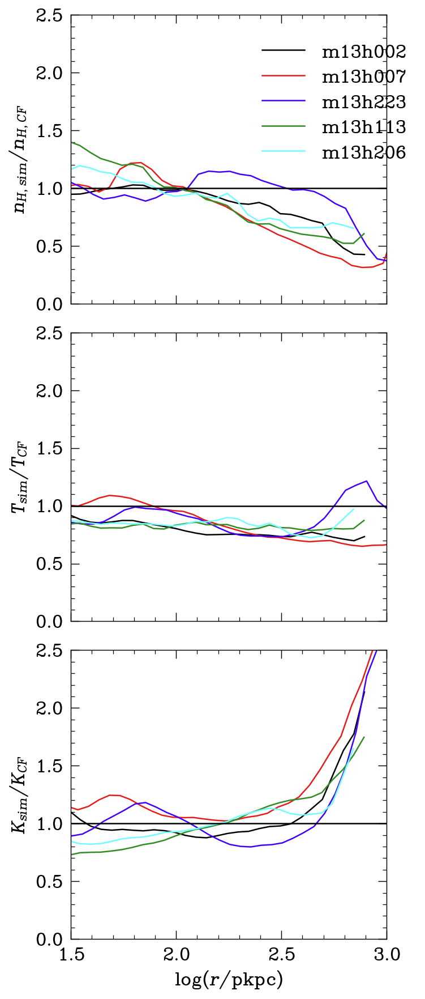

In [17]:
### Paper: Fitting ###
makecoolingflowratios([res_cf['m12f_NoBH'], res_cf['m12q_NoBH'], res_cf['m12r_NoBH'], res_cf['m12w_NoBH'], res_cf['m12z_NoBH'], res_cf['m12a_NoBH'], res_cf['m12d_NoBH'], res_cf['m12k_NoBH'], res_cf['m12g_NoBH'], res_cf['m12j_NoBH'], res_cf['m12n_NoBH'], res_cf['m12x_NoBH']])
plt.savefig('../Paper2Figs/CFratios_turb_fitTnH_m12.pdf')

makecoolingflowratios([res_cf['m13h002_NoBH'], res_cf['m13h007_NoBH'], res_cf['m13h223_NoBH'], res_cf['m13h113_NoBH'], res_cf['m13h206_NoBH']])
plt.savefig('../Paper2Figs/CFratios_turb_fitTnH_m13.pdf')

## CF fitting with turbulence: AGN sims

In [3]:
PaperSimNames_AGN = PaperSimNames = {'m12f_NoBH': 'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm12f_BH': 'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5',
 'm12f_BHCR': 'm12f_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
 'm12q_NoBH': 'm12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm12q_BH': 'm12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5',
 'm12q_BHCR': 'm12q_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
 'm13h113_NoBH': 'm13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h113_BH': 'm13h113_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e-4_gacc31_fa0.5',
 'm13h113_BHCR': 'm13h113_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
 'm13h206_NoBH': 'm13h206_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
 'm13h206_BH': 'm13h206_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp3e-4_gacc31_fa0.5',
 'm13h206_BHCR': 'm13h206_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000'}

# {'m12f_BH': 'm12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5',
#  'm12f_BHCR': 'm12f_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
#  'm12q_BH': 'm12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5',
#  'm12q_BHCR': 'm12q_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
#  'm13h113_BH': 'm13h113_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e-4_gacc31_fa0.5',
#  'm13h113_BHCR': 'm13h113_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000',
#  'm13h206_NoBH': 'm13h206_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5',
#  'm13h206_BH': 'm13h206_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp3e-4_gacc31_fa0.5',
#  'm13h206_BHCR': 'm13h206_m3e5_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000'}

In [4]:
# Load snapshots from z=0.5 to 0
res_AGN = {}
for k,v in PaperSimNames_AGN.items():
    snaps = sorted([int(f.split('_')[-1].split('.')[0]) for f in os.listdir(d) if v in f])
    snaps = np.intersect1d(snaps, np.arange(259, 501)) if snaps[-1]>100 else np.intersect1d(snaps, np.arange(50, 61))
    print(k, v)
    print(snaps[-1])
    print()
    res_AGN[k] = Simulation(sim_path_fire3(v), snaps[-1])

m12f_NoBH m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
500

m12f_BH m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
500

Rcool not defined, set to 0.5*Rvir m12f_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
m12f_BHCR m12f_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000
60

m12q_NoBH m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e10_gacc31_fa0.5
500

m12q_BH m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
303

Rcool not defined, set to 0.5*Rvir m12q_m7e3_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp2e-4_gacc31_fa0.5
m12q_BHCR m12q_m6e4_MHDCRspec1_fire3_fireBH_fireCR1_Oct252021_crdiffc1_sdp1e-4_gacc31_fa0.5_fcr1e-3_vw3000
60

m13h113_NoBH m13h113_m3e5_MHD_fire3_fireBH_Sep182021_crdiffc690_sdp1e10_gacc31_fa0.5
60

m13h113_BH m13h113_m3e4_MHD_fire3_fireBH_Sep182021_hr_crdiffc690_sdp1e-4_gacc31_fa0.5
364

m13h113_BHCR m13h113_m3e5_MHDCRspec1_fir

In [5]:
resdict_AGN = {}

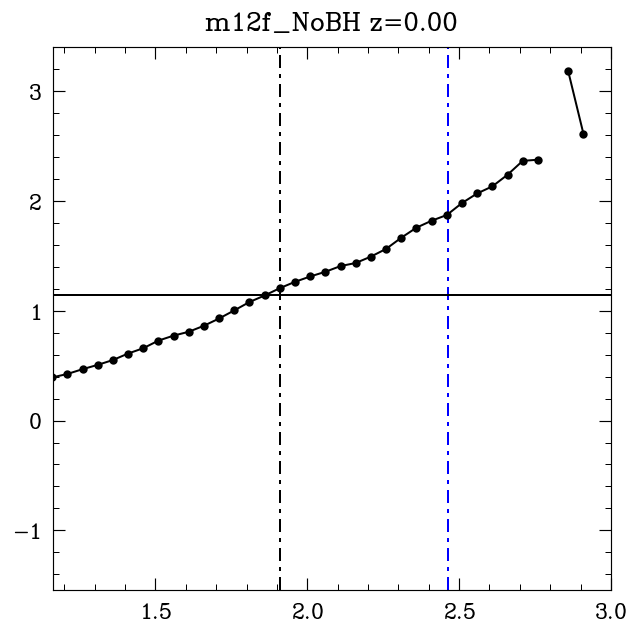

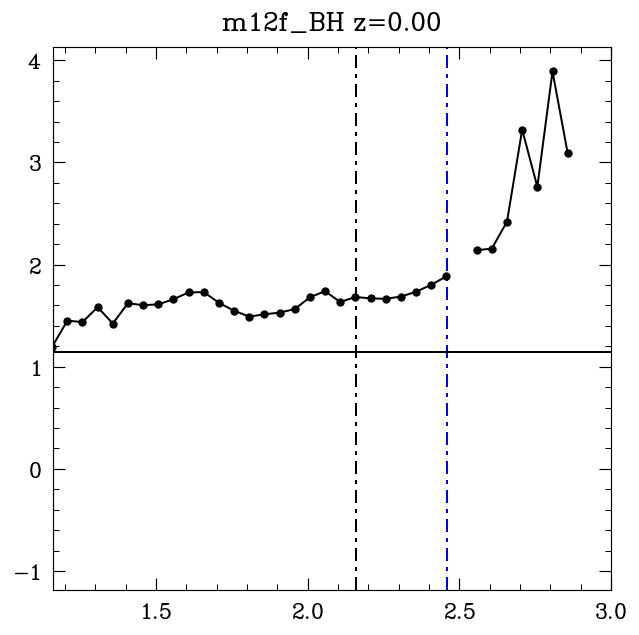

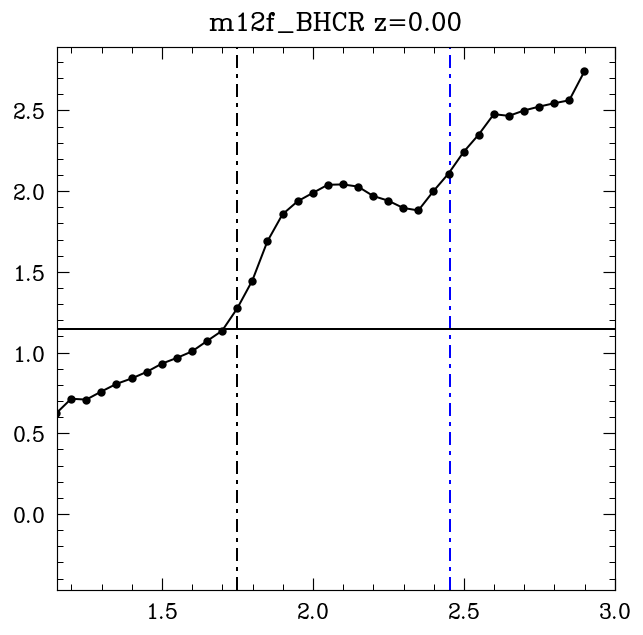

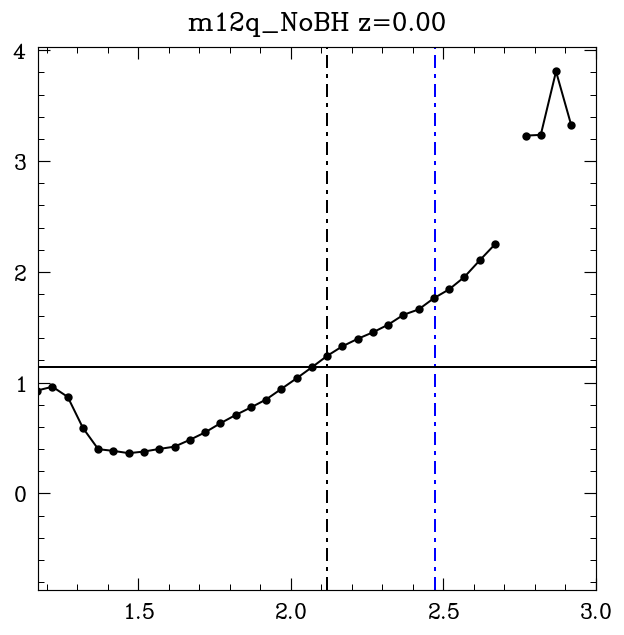

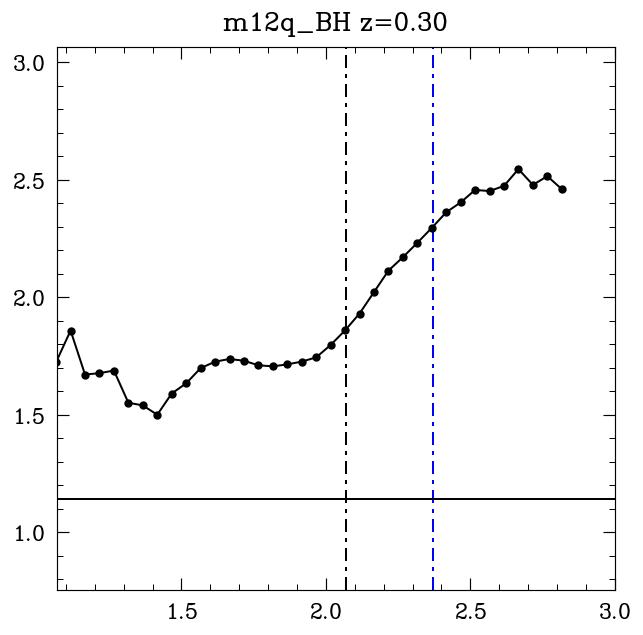

...

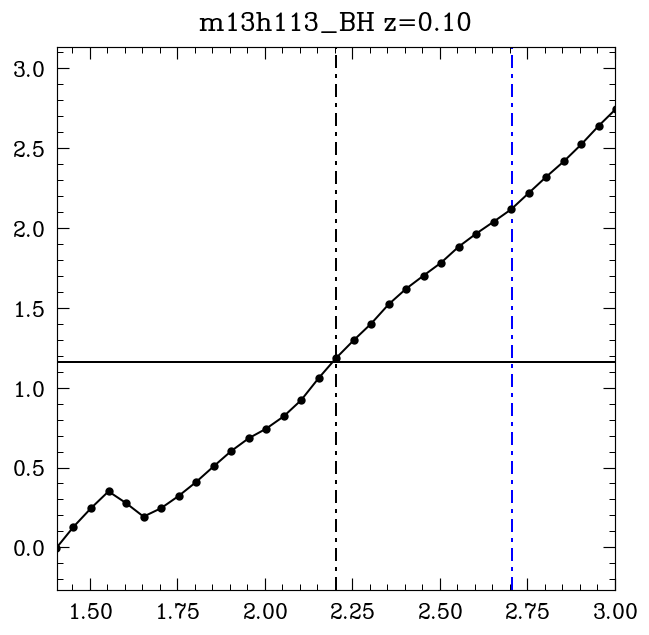

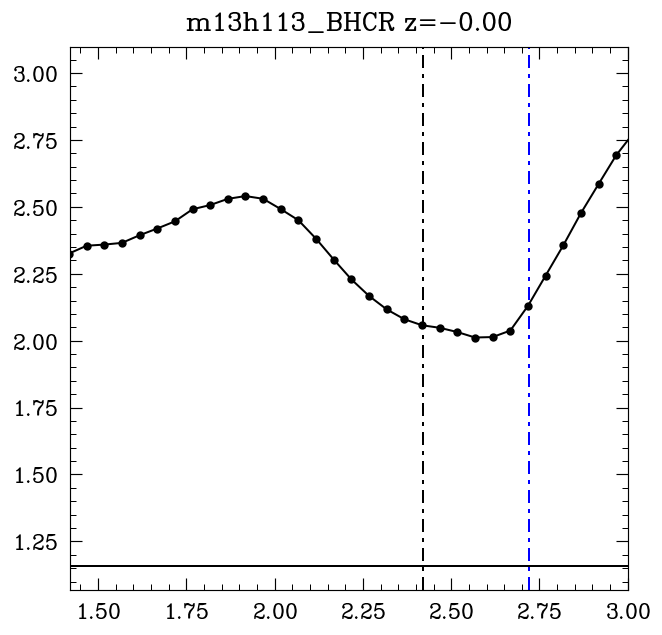

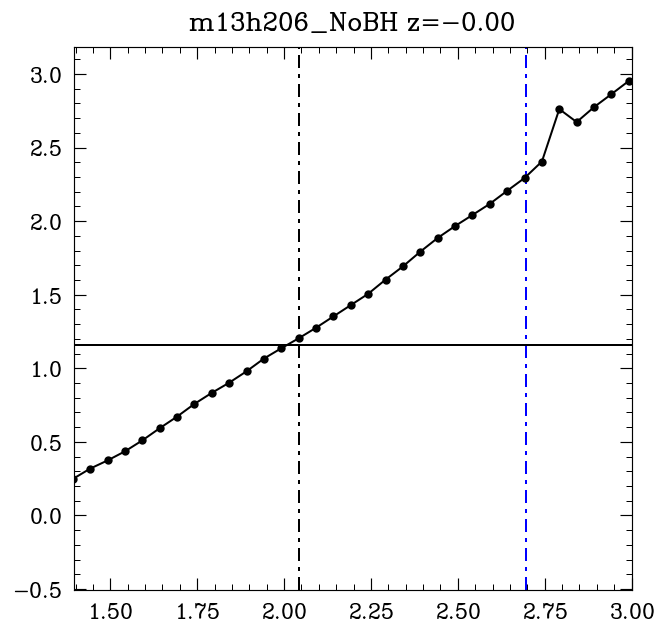

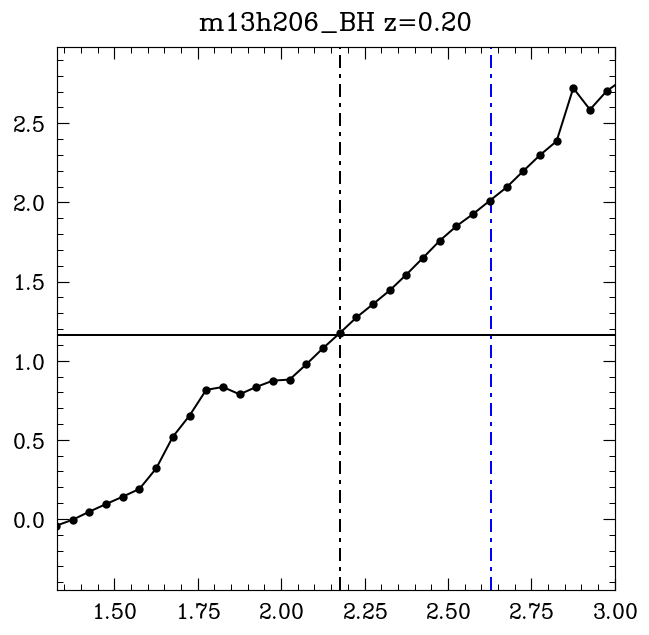

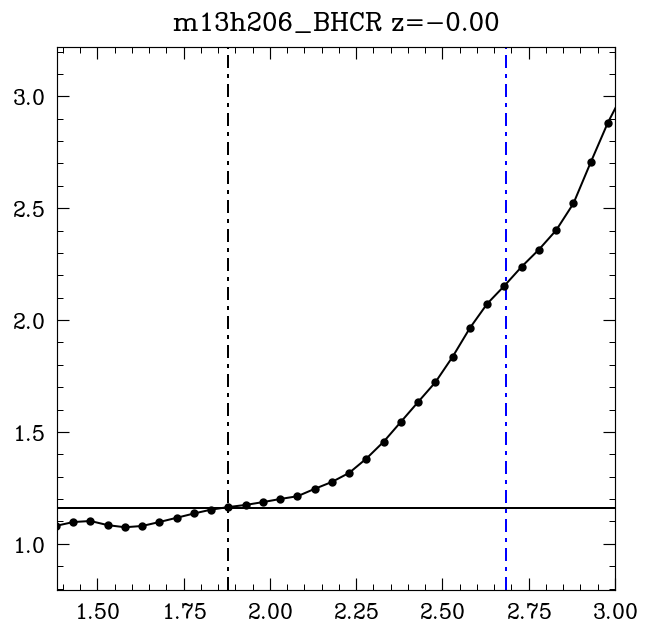

In [7]:
for simname in res_AGN.keys():
    Sim = res_AGN[simname]
    pro = Sim.pro
    rmid = pro['rmid']*pro['Rvir']
    plt.figure()
    plt.axvline(np.log10(Sim.Rcool), c='k', ls='-.')
    plt.axvline(np.log10(pro['Rvir']), c='b', ls='-.')
    plt.axhline(np.log10(Sim.tHubble), label=r'$t_H$', c='k')
    plt.xlim(np.log10(0.05*pro['Rvir']), 3)
    plt.plot(np.log10(rmid), pro['tcool'], 'k.-', label='FIRE')
    plt.title(f'{simname} z={Sim.Redshift[()]:.2f}')

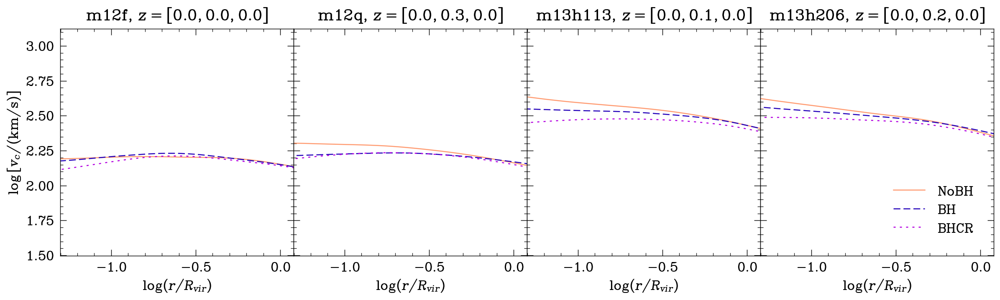

In [21]:
def makevc(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], fname=None):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey=True, gridspec_kw={'wspace': .0, 'hspace':.04}, figsize=[4.8*len(sims),4.8*1], dpi=150, facecolor='w')
    R_min = 10**-1*un.kpc
    R_max = 10**3*un.kpc
    xarr = np.logspace(np.log10(R_min.to(un.kpc).value), np.log10(R_max.to(un.kpc).value), 100) * un.kpc
    for i,sim in enumerate(sims):
            zs = []
            for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
                Sim = res_cf[model]
                zs.append(Sim.Redshift[()])
                axes[i].plot(np.log10(xarr.value/Sim.pro['Rvir']), np.log10(Sim.potential.vc(xarr).value), ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
                # axes[i].axvline(np.log10(Sim.potential.get_Rcirc().value), label='$R_{circ}$', c='k')
            axes[i].set_title(f'{sim}, $z={[abs(round(z,2)) for z in zs]}$')
    axes[-1].legend(loc=4)
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')#ax.set_xlabel(r'$\log (r/\mathrm{pkpc})$')
    axes[0].set_ylabel(r'$\log \left[ v_c/(\mathrm{km/s}) \right]$')
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))
    if fname: plt.savefig(fname)
makevc(res_AGN, fname='../Paper2Figs/vc_mainsims.pdf')

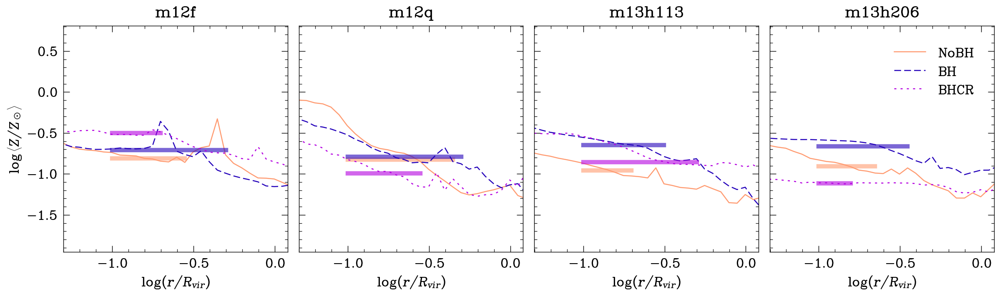

In [22]:
def makeZprofile(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], 
                 fname=None,
                 prolabels = ['Z_Mweighted'],
                 ylabels = [profilelabels['Z lin']]):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*len(sims),4.8*1], dpi=150)
    for i,sim in enumerate(sims):
        axes[i].set_title(sim)
        for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
            Sim = res_cf[model]
            for j, (ylabel, prolabel) in enumerate(zip(ylabels, prolabels)):
                axes[i].plot(np.log10(Sim.pro['rmid']), Sim.pro[prolabel], ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
                axes[0].set_ylabel(ylabel)
#             axes[i].axhline(np.log10(Sim.Z2Zsun), c=COLOR_SCHEME[mi-1], ls=ls, lw=1)
            axes[i].plot((np.log10(0.1), np.log10(Sim.Rcool/Sim.pro['Rvir'])), (np.log10(Sim.Z2Zsun), np.log10(Sim.Z2Zsun)), '-', c=COLOR_SCHEME[mi-1], lw=5, alpha=0.6)
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')
    axes[-1].legend()
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))

    if fname: plt.savefig(fname)
makeZprofile(res_AGN, fname='../Paper2Figs/Zprofiles.pdf')

3.728708428482426 -1.0 1.909655400340509
-5.141483848783687 -1.0 2.1599164562500834
0.41796107817005906 -1.0 1.7490941217563587
2.89507912134337 -1.0 2.1193000730145806
1.5917769395013157 -1.0 2.068833446521146
2.472883314614071 -1.0 1.9067936135998436
44.583303519703676 -1.0 2.04261302136542
95.5729843211086 -1.0 2.204046108662794
-5.72533049559321 -1.0 2.419738395282956
17.679063623291842 -1.0 2.0418971938261676
-13.216791009537022 -1.0 2.1754961314365
1.5873039993425977 -1.0 1.8799997363131107


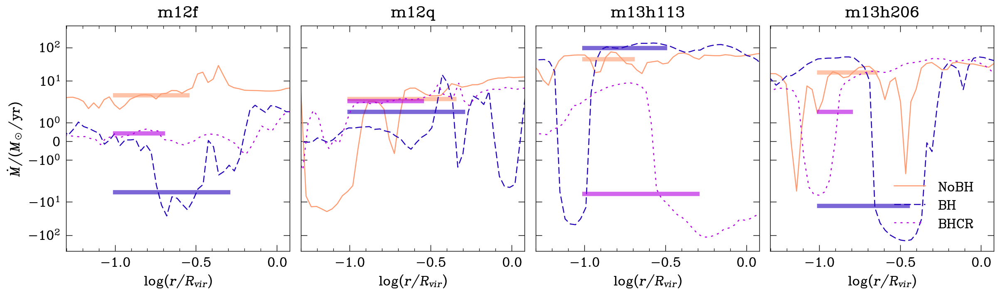

In [23]:
def makeMdotprofile(res_cf, sims=['m12f', 'm12q', 'm13h113', 'm13h206'], 
                 fname=None):
    fig, axes = plt.subplots(1, len(sims), sharex=True, sharey='row', gridspec_kw={'wspace': .05, 'hspace':.15}, figsize=[4.8*len(sims),4.8*1], dpi=150)
    for i,sim in enumerate(sims):
        axes[i].set_title(sim)
        for mi, (model,ls) in enumerate(zip([f'{sim}_NoBH', f'{sim}_BH', f'{sim}_BHCR'], ['-', '--',':'])):
            Sim = res_cf[model]
            axes[i].plot(np.log10(Sim.Mdot_profile['rmid_Mdot']/Sim.pro['Rvir']), Sim.Mdot_profile['Mdot'], ls, c=COLOR_SCHEME[mi-1], label=model.split('_')[1])
            axes[0].set_ylabel('$\dot{{M}}/(M_\odot/\mathrm{{yr}})$')
            axes[i].plot((np.log10(0.1), np.log10(Sim.Rcool/Sim.pro['Rvir'])), (Sim.Mdot_avg.value, Sim.Mdot_avg.value), '-', c=COLOR_SCHEME[mi-1], lw=5, alpha=0.6)#, ls=ls, lw=2)
            print(Sim.Mdot_avg.value, np.log10(0.1), np.log10(Sim.Rcool))
    for ax in axes: ax.set_xlabel(r'$\log (r/R_{vir})$')
    axes[-1].legend(loc=4)
    axes[0].set_yscale('symlog')
    axes[0].set_xlim(np.log10(0.05), np.log10(1.2))

    if fname: plt.savefig(fname)
makeMdotprofile(res_AGN, fname='../Paper2Figs/Mdotprofiles.pdf')

In [6]:
#log space
bins = np.logspace(-2,1,100)

for simname in res_AGN.keys():
    Sim = res_AGN[simname]
    altalpha = 0.25#res_cf[simname.split('_')[0]+'_NoBH'].alpha_avg
    print(simname, Sim.alpha_avg, altalpha)
    cooling = Cool.Wiersma_Cooling(Sim.Z2Zsun, Sim.Redshift)

    def solution(R_sonic, R_min=1, R_max=1.5):
        with np.errstate(divide='ignore', over='ignore', under='ignore', invalid='ignore'):
            try:
                return CF.shoot_from_sonic_point(Sim.potential, cooling, R_sonic=R_sonic, R_max=R_max*Sim.potential.Rvir, R_min=R_min*un.kpc)#, alpha=altalpha, tol=1e-3)
            except:
                return -1

    reslist = Parallel(n_jobs=-1)(delayed(solution)(Rsonic*un.kpc) for Rsonic in bins)
    resdict_AGN[simname] = reslist

m12f_NoBH 0.41863158049815097 0.25
m12f_BH 0.6378873328285481 0.25
m12f_BHCR 0.4860889261734229 0.25
m12q_NoBH 0.31838378251868 0.25
m12q_BH 0.7447350932104958 0.25
m12q_BHCR 0.46377412979222665 0.25
m13h113_NoBH 0.06311094873728748 0.25
m13h113_BH 0.21617748956623575 0.25
m13h113_BHCR 0.12019009797064925 0.25
m13h206_NoBH 0.05494232637811671 0.25
m13h206_BH 0.1935716523524314 0.25
m13h206_BHCR 0.11171298583853974 0.25
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with return_all_results=True and check intermediate solutions
no result reached maximum R, try rerunning with retu

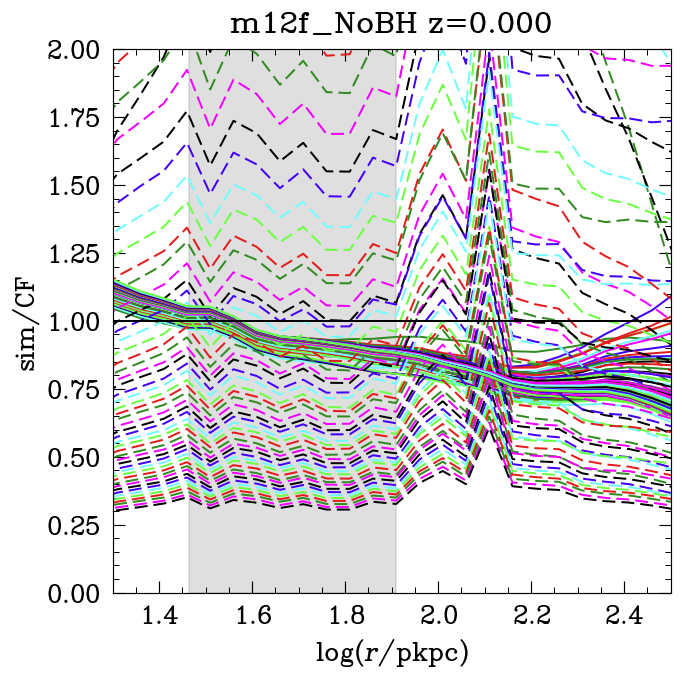

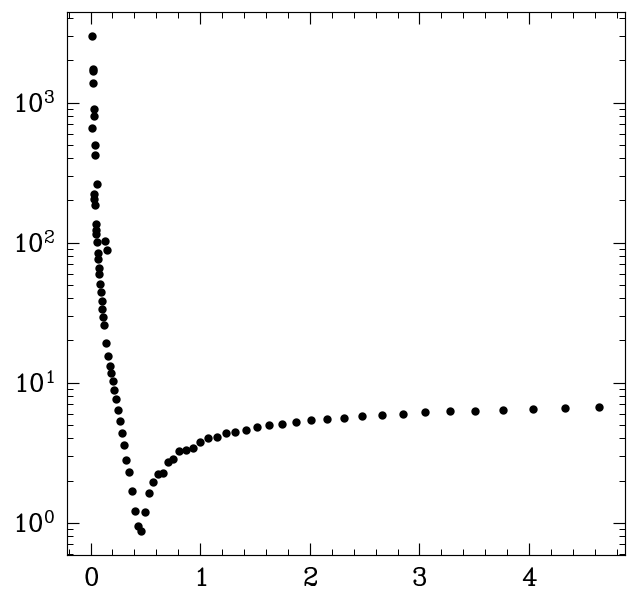

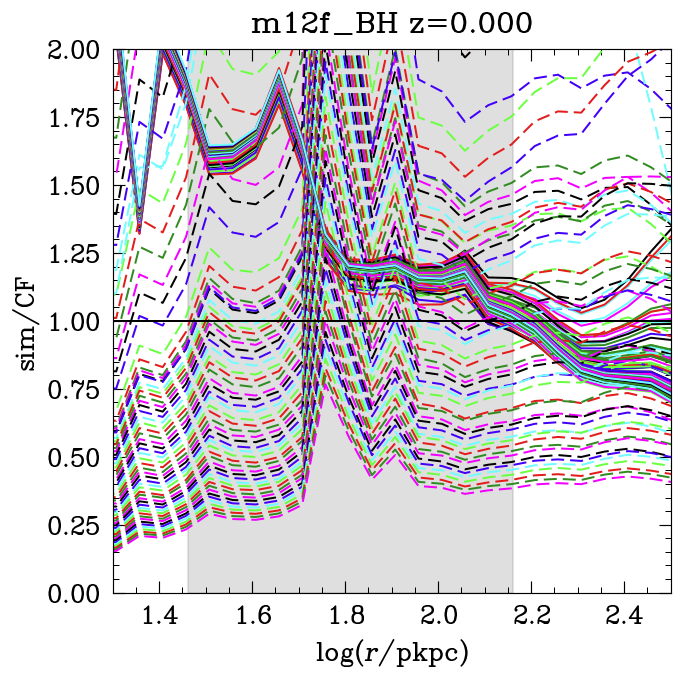

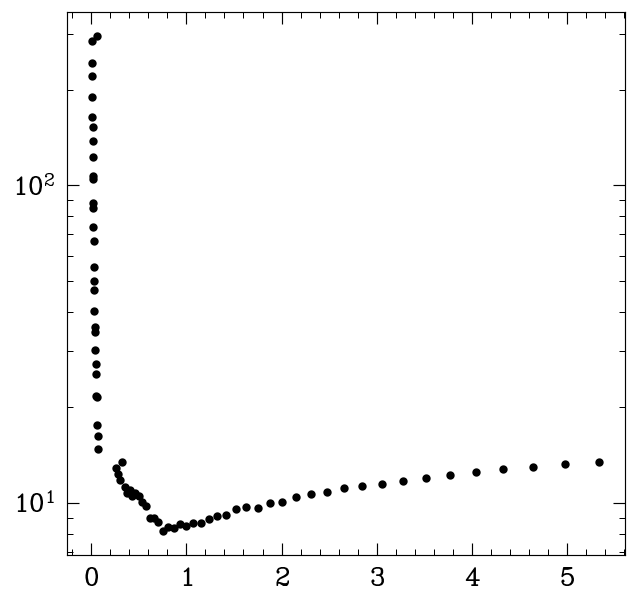

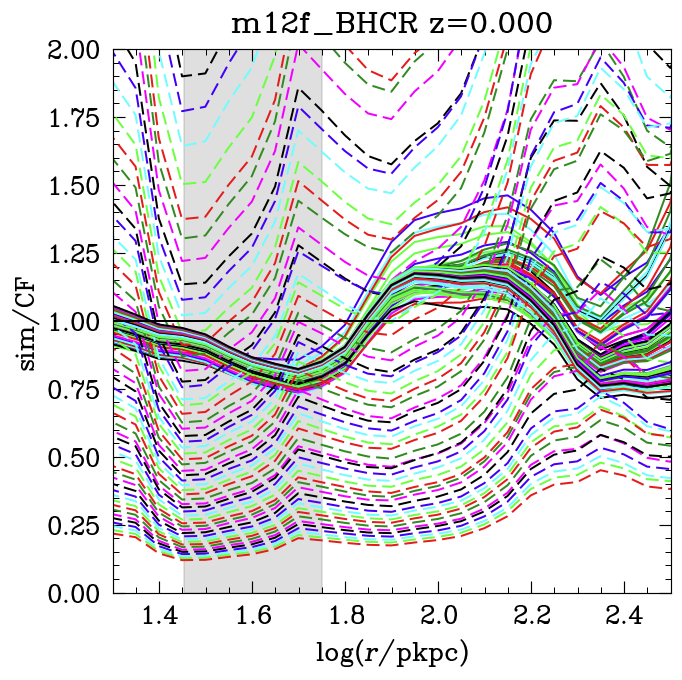

...

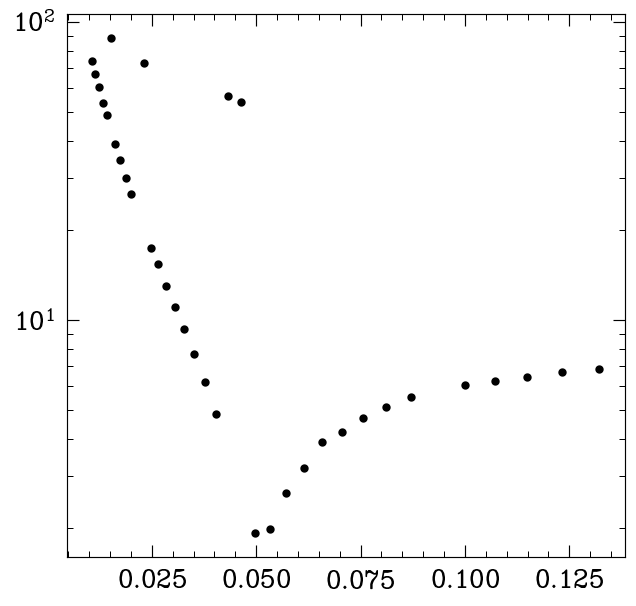

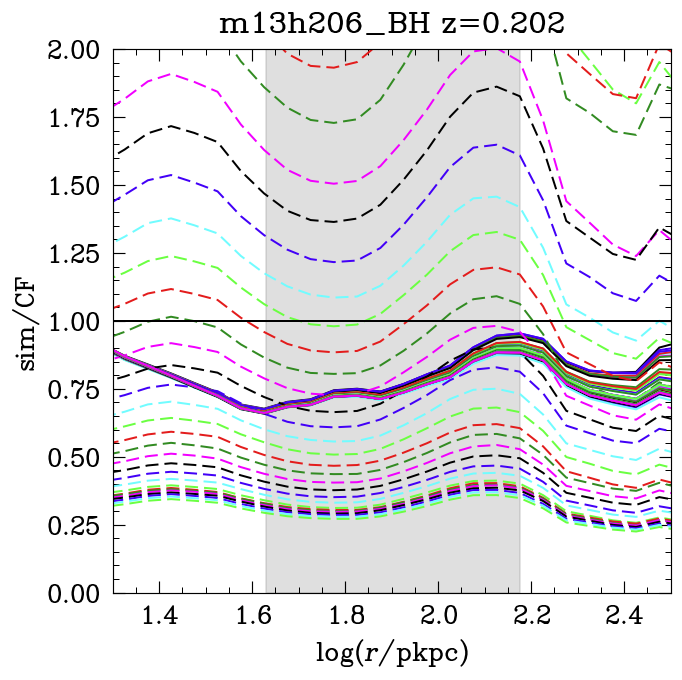

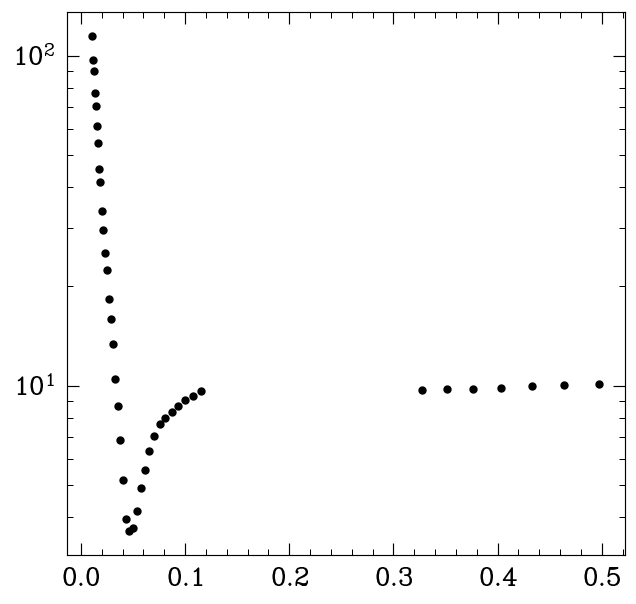

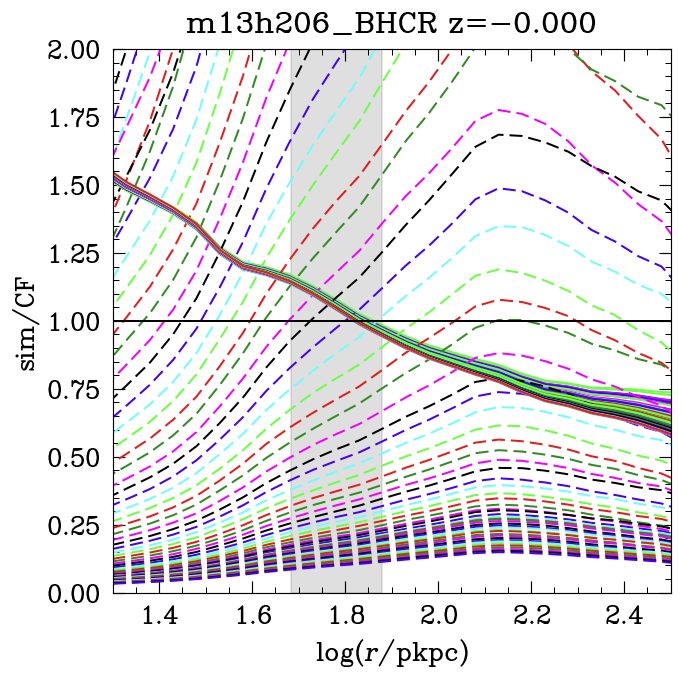

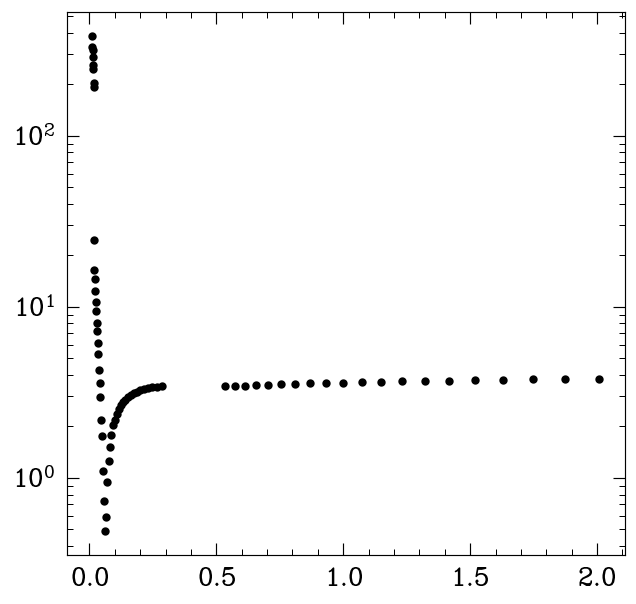

In [10]:
CF_fitting(resdict_AGN, res_AGN)

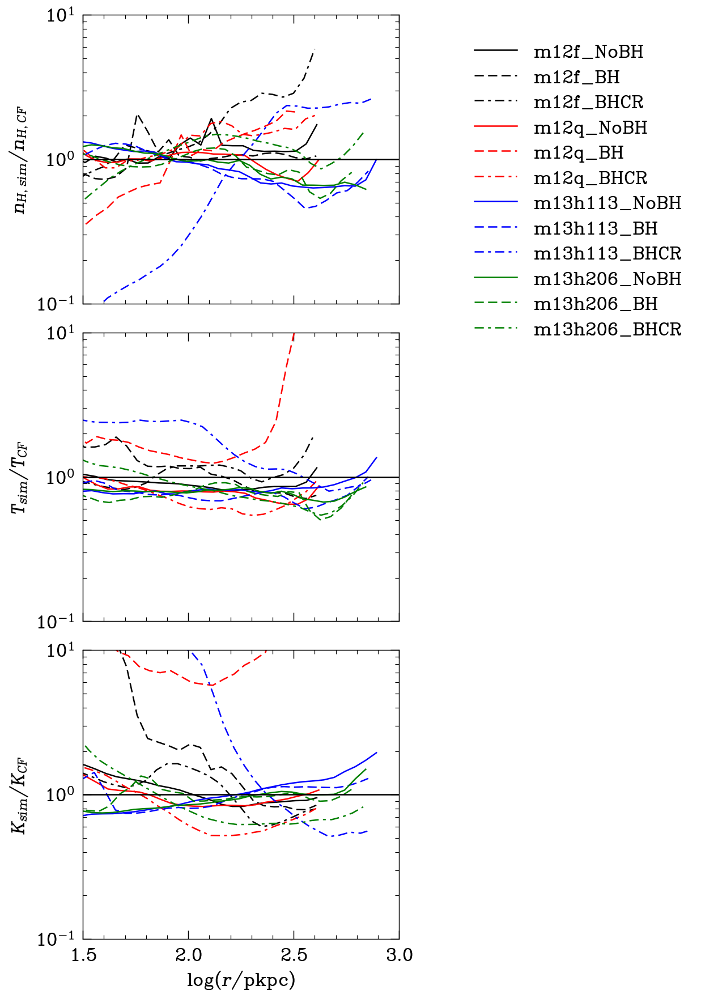

In [13]:
labels = list(PaperSimNames_AGN.keys())
cs = list(np.concatenate([[c]*3 for c in ['k', 'r', 'b', 'g']]))
makecoolingflowratios([res_AGN[k] for k in labels], labels=labels, lss=['-', '--', '-.']*4, cs=cs);
# plt.savefig('../Paper2Figs/CFratios_fitTnH_AGN.pdf')

2.531682787756439
2.531682787756439
2.531682787756439
2.531682787756439
2.531682787756439
2.539382279599925
2.539382279599925
2.539382279599925
2.539382279599925
2.539382279599925
2.7625884023131912
2.7625884023131912
2.7625884023131912
2.7625884023131912
2.7625884023131912


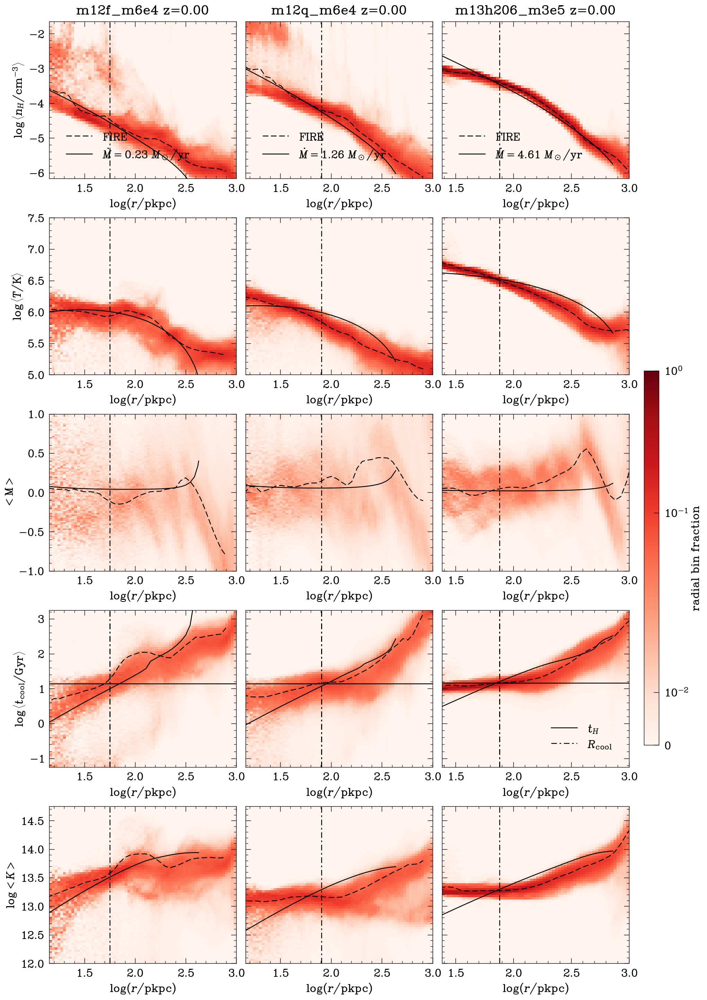

In [222]:
makecoolingflow([res_AGN['m12f_BHCR'], res_AGN['m12q_BHCR'], res_AGN['m13h206_BHCR']]);

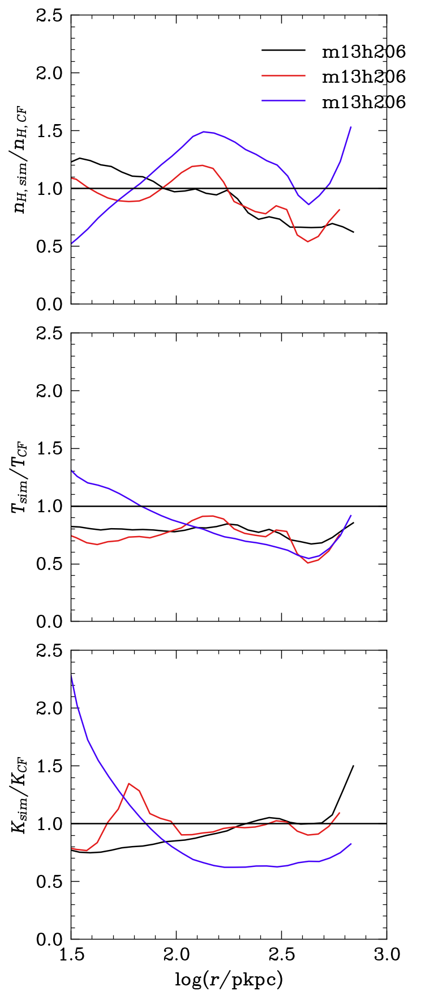

In [228]:
makecoolingflowratios([res_AGN['m13h206_NoBH'], res_AGN['m13h206_BH'], res_AGN['m13h206_BHCR']]);

2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7744858598262483
2.7080847974365816
2.7080847974365816
2.7080847974365816
2.7080847974365816
2.7080847974365816
2.7625884023131912
2.7625884023131912
2.7625884023131912
2.7625884023131912
2.7625884023131912


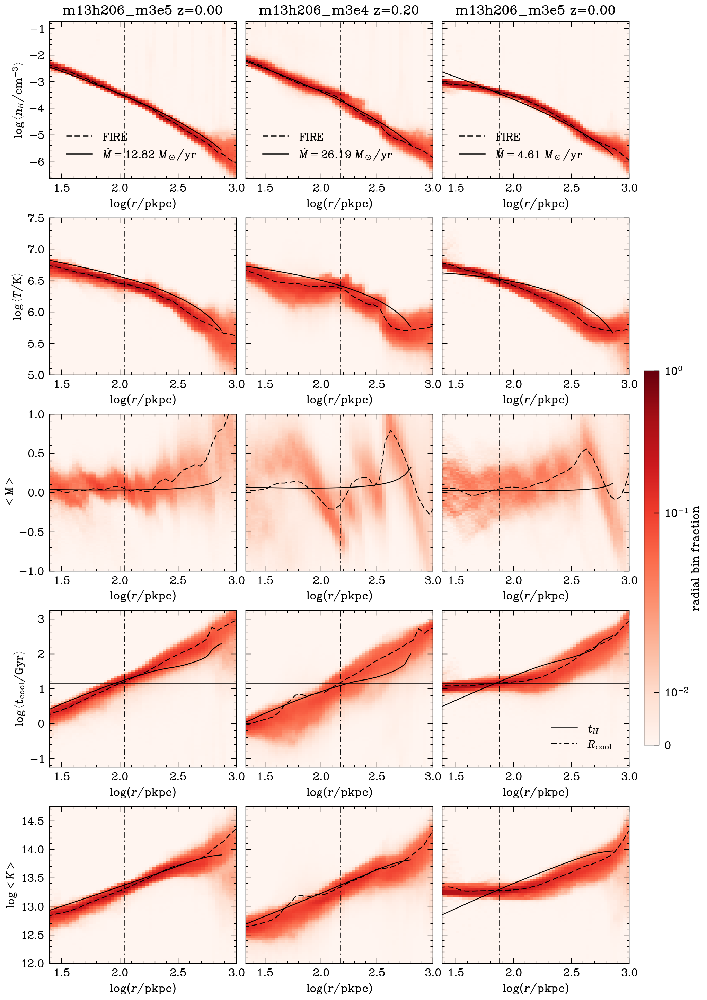

In [230]:
makecoolingflow([res_AGN['m13h206_NoBH'], res_AGN['m13h206_BH'], res_AGN['m13h206_BHCR']])
plt.savefig('../Paper2Figs/CFprofiles_fitTnH_m13h206.pdf')

In [146]:
for k,Sim in res_AGN.items(): 
    print(res_cf[k.split('_')[0]+'_NoBH'].alpha_avg)
    print( k,Sim.alpha_avg );  print(); continue
    
    
    pro = Sim.pro
    rmid = pro['rmid']*pro['Rvir']
    plt.figure()
    Pturbratio = 10**pro['P_turb'] / 10**pro['P_th']
    plt.plot(np.log10(rmid), Pturbratio, 'k.-', label='FIRE')
    
    plt.axhline(Sim.alpha_avg)
    plt.axvline(np.log10(0.1 * Sim.pro['Rvir']))
    plt.axvline(np.log10(Sim.Rcool))

    plt.xlabel('$\log (r/\mathrm{pkpc})$')
    plt.ylabel('$P_{\mathrm{turb}} / P_{\mathrm{th}}$')

    plt.title(k + ' ' + f'z={np.abs(Sim.Redshift):.02f} {Sim.alpha_avg:.03f}')
#     plt.ylim((-0.04175976784173662, 2.1))
    plt.legend()
    
    Rmin, Rmax = 0.1 * Sim.pro['Rvir'], Sim.Rcool
    print(Pturbratio[(Rmin < rmid) & (rmid < Rmax)])
    print(Rmin, Rmax)
    print()

0.41863158049815097
m12f_BH nan

0.41863158049815097
m12f_BHCR 0.4860889261734229

0.31838378251868
m12q_BH nan

0.31838378251868
m12q_BHCR 0.46377412979222665

0.06311094873728748
m13h113_BH 0.21617748956623575

0.06311094873728748
m13h113_BHCR nan

0.05494232637811671
m13h206_BH 0.1935716523524314

0.05494232637811671
m13h206_BHCR 0.11171298583853974

